In [1]:
import numpy as np
# import pandas as pd
import xgboost as xgb
from xgboost import XGBRegressor, XGBClassifier, Booster
from sklearn.model_selection import train_test_split
from scipy.special import softmax
import torch
import torch.nn.functional as F

from torchvision import datasets, transforms
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import cv2
from typing import List, Callable
from torch.utils.data import Dataset, DataLoader
from icecream import ic
from scipy.fftpack import dct
from sklearn.metrics import confusion_matrix
import random

import json
from types import SimpleNamespace
import random

In [2]:
import scipy

In [3]:
np.random.seed(102)
random.seed(241)
torch.manual_seed(23)

In [4]:
xgb.set_config(verbosity=2)
xgb.get_config()

{'use_rmm': False, 'verbosity': 2}

In [5]:
x = np.array([-2.0,2.0])
lr = .001
def grad_x(x): # f(x) = x**4
    return 4*x**3

step =  lr*grad_x(x)
x_2 =  x - step

d2 = grad_x(x_2) - grad_x(x)
d2x = - step
d2/d2x ,d2, step , x_2 , 12*x**2 , -(grad_x(x_2)/(- grad_x(x))+1)/lr

(array([47.236096, 47.236096]),
 array([ 1.51155507, -1.51155507]),
 array([-0.032,  0.032]),
 array([-1.968,  1.968]),
 array([48., 48.]),
 array([-47.236096, -47.236096]))

In [6]:
np.zeros((16)).shape

(16,)

In [7]:
class MNIST_Seq(Dataset):
    """Sequenced CIFAR dataset."""

    def __init__(self, dataset, positional_encoding_size = 10, transform=None):
        """
        Arguments:
            dataset   (Dataset): torch standard dataset with annotations.
            
            transform (callable, optional): Optional transform to be applied
                on a sample.
        """
        
        self.patch_size = 4
        self.stride = 4
        self.scale = 1
        self.image_size = 28
        self.block_size = int(((self.image_size-self.patch_size)//self.stride +1 )**2) + 1 
        self.positional_encoding_size = positional_encoding_size
        
        self.dataset = dataset
        self.pos_encoding = getPositionEncoding(seq_len=self.block_size, d=positional_encoding_size, n=self.block_size)

        self.transform = transform

    def __len__(self):
        return len(self.dataset)

    def image2seq(self, im):
        seq = [np.zeros((self.patch_size**2))+.5]
        seq += [(im[x:x+self.patch_size,y:y+self.patch_size]).flatten() /(255)*self.scale
               for x in range(0,im.shape[0]-self.patch_size+1,self.stride)
               for y in range(0,im.shape[1]-self.patch_size+1,self.stride)]
    
        return np.concatenate([np.stack(seq),self.pos_encoding] , axis = -1)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()


        image , target = self.dataset[idx]

        if self.transform:
            image = self.transform(image) ####  check scale
            
        label = target#0 if target == 3 else 1
        image_seq = self.image2seq(np.array(image))
        sample = {'image_seq': image_seq, 'label': label, 'image': np.array(image)/(255)*self.scale}

        return sample

In [8]:
transform_train = transforms.Compose([transforms.Resize((28,28)),  #resises the image so it can be perfect for our model.
                                      # transforms.RandomHorizontalFlip(), # FLips the image w.r.t horizontal axis
                                      transforms.RandomRotation(5),     #Rotates the image to a specified angel
                                      transforms.RandomAffine(degrees=5,translate=(.1,.1), scale=(0.9,1.1)) #Performs actions like zooms, change shear angles.
                                      # transforms.ColorJitter(brightness=0.01, contrast=0.1, saturation=0.01)
                               ])
transform_train = None

In [9]:
def getPositionEncoding(seq_len, d, n=10000):
    P = np.zeros((seq_len, d))
    for k in range(seq_len):
        for i in np.arange(int(d/2)):
            denominator = np.power(n, 2*i/d)
            P[k, 2*i] = np.sin(k/denominator)
            P[k, 2*i+1] = np.cos(k/denominator)
    # P = (((P + 1) / 2) * 255).astype(np.uint8) # normalized position
    return P

# positional_encoding_size = 10

# P = getPositionEncoding(seq_len=block_size, d=positional_encoding_size, n=block_size)

In [ ]:
# CIFAR_Train = datasets.CIFAR10('./mnist' , download=False, transform=transform_train)
# CIFAR_Test = datasets.CIFAR10('./mnist' ,train=False, download=False)

Trainset = datasets.MNIST('./mnist' , download=False, transform=transform_train)
Testset = datasets.MNIST('./mnist' ,train=False, download=False)
ic(len(Trainset) , len(Testset))
plt.hist(Trainset.data[:1000].flatten()[np.where(Trainset.data[:1000].flatten()>0)]/255, bins=255) ## zeros are removed!
plt.show()

 13%|████████████████▋                                                                                                                  | 3375104/26421880 [00:07<00:52, 442539.21it/s]

In [11]:
MNIST_Seq_Train =  MNIST_Seq (Trainset)
MNIST_Seq_Test =  MNIST_Seq (Testset)

In [12]:
def vis(im,t):
    im = np.array(im)
    imax = plt.imshow(im,vmin=0,vmax=255)
    plt.title(Trainset.classes[t])
    imax.axes.set_axis_off()
    plt.show()
    patch_size = MNIST_Seq_Train.patch_size
    stride = MNIST_Seq_Train.stride
    tiles = [im[x:x+patch_size,y:y+patch_size] for x in range(0,im.shape[0]-patch_size+1,stride) for y in range(0,im.shape[1]-patch_size+1,stride)]
    feature_map_size = int((im.shape[0]-patch_size)/stride +1)
    fig, axs = plt.subplots(feature_map_size, feature_map_size)
    for i , p in enumerate(tiles) :
        axs[i//feature_map_size,i%feature_map_size].imshow(p , vmax=255,vmin=0)
        axs[i//feature_map_size,i%feature_map_size].set_axis_off()
        
    plt.subplots_adjust(wspace=-.7, hspace=.03)
    plt.show()
    print(len(tiles))
    print(list(range(0,im.shape[0]-patch_size+1,stride)))
    
    print(feature_map_size)
    # plt.hist(im.flatten())
    # plt.show()

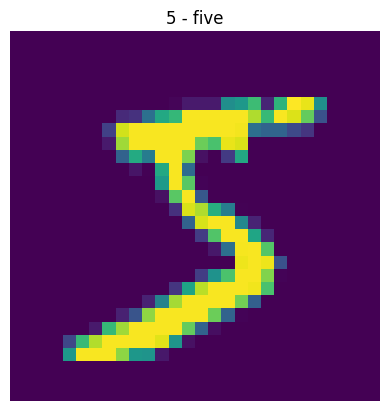

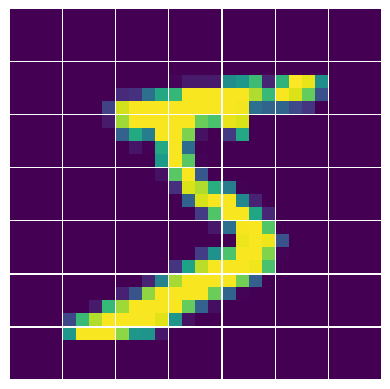

49
[0, 4, 8, 12, 16, 20, 24]
7


255

In [13]:
# only for visualization
for i in range(1):
    im ,t= Trainset[i]
    vis(im,t)
np.array(im).max()

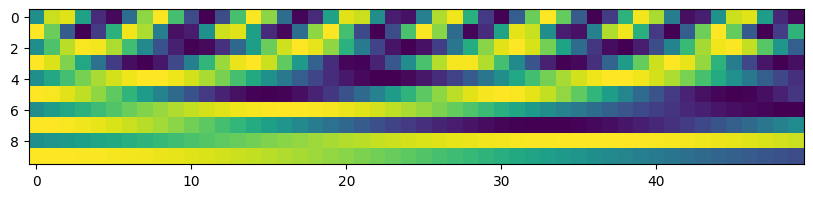

In [14]:
plt.figure(figsize=(10,3))
plt.imshow(MNIST_Seq_Train.pos_encoding.T)
plt.show()

ic| data_dict['image_seq'][:,:,:MNIST_Seq_Train.patch_size**2].max(): tensor(1., dtype=torch.float64)
ic| data_dict['image_seq'].shape: torch.Size([1000, 50, 26])
    data_dict['label'].shape: torch.Size([1000])


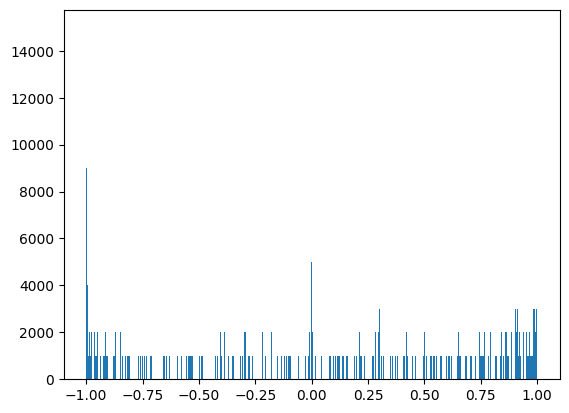

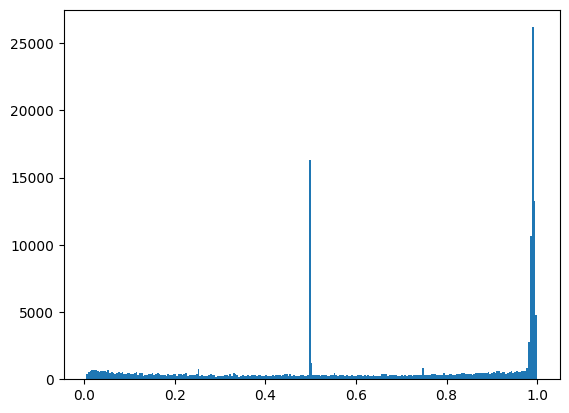

In [15]:
batch_size = 1000
TrainLoader = DataLoader(MNIST_Seq_Train,batch_size = batch_size ,num_workers=2, shuffle=True)
TestLoader = DataLoader(MNIST_Seq_Test,batch_size = batch_size)

itert = iter(TrainLoader)
data_dict =  next(itert)
ic(data_dict['image_seq'][:,:,:MNIST_Seq_Train.patch_size**2].max())
ic(data_dict['image_seq'].shape , data_dict['label'].shape)
a = plt.hist(data_dict['image_seq'][:,:,MNIST_Seq_Train.patch_size**2:].numpy().flatten() , bins=1000)
plt.show()
a = plt.hist(data_dict['image_seq'][:,:,:MNIST_Seq_Train.patch_size**2].numpy().flatten()[
             np.where(np.abs(data_dict['image_seq'][:,:,:MNIST_Seq_Train.patch_size**2].numpy().flatten())>0)],bins=255)
plt.show()


In [16]:
block_size = ic(MNIST_Seq_Train.block_size)
positional_encoding_size = ic(MNIST_Seq_Train.positional_encoding_size)

ic| MNIST_Seq_Train.block_size: 50
ic| MNIST_Seq_Train.positional_encoding_size: 10


In [17]:
embeding_dim =  40 # key , query size 
num_class  = 10
value_dim = embeding_dim + num_class
n_head_layer1 = 5
n_head_layer2 = 5
input_dim =(MNIST_Seq_Train.patch_size**2) + MNIST_Seq_Train.positional_encoding_size 
flash = True

In [18]:
def obj_init(predicts, dtrain):
    ggrad = np.random.randn(*predicts.shape) #@+ggrad*.1
    ggrad = ggrad.flatten()
    hess = ggrad*0+0.001
    
    return ggrad, hess

key_query_param = {'max_depth':7, 'base_score':.0 , 'subsample': 1,
         'tree_method':'auto', 'multi_strategy': 'multi_output_tree',
         'min_child_weight' : .000,  # default=1
         'eta': 0.03, # default=.3
         'num_feature':input_dim,
         'num_class': embeding_dim,
            'lambda':1 } # default=1

value_param = {'max_depth':7, 'base_score':0 , 'subsample': 1,
         'tree_method':'auto', 'multi_strategy': 'multi_output_tree',
         'min_child_weight' : .000, # default=1
         'eta': 0.03, # default=.3
         'num_feature':input_dim,
         'num_class': embeding_dim + num_class,
              'lambda': 1} # default=1



key_booster = Booster(key_query_param)
query_booster = Booster(key_query_param)
value_booster = Booster(value_param)



for i, data in enumerate(TrainLoader):
    
    x , target , full_image = data['image_seq'] , data['label'] , data['image']
    model_XT = x.reshape(-1,input_dim)
    dtrain = xgb.DMatrix(model_XT.numpy())
    
    key_outputs = key_booster.predict(dtrain, output_margin=True)
    grad, hess = obj_init(key_outputs, dtrain)
    key_booster.boost(dtrain, grad, hess)
    
    query_outputs = query_booster.predict(dtrain, output_margin=True)
    grad, hess = obj_init(query_outputs, dtrain)
    query_booster.boost(dtrain, grad, hess)

    value_outputs = value_booster.predict(dtrain, output_margin=True)
    grad, hess = obj_init(value_outputs, dtrain)
    value_booster.boost(dtrain, grad, hess)
    
    ic(i, grad.shape)
    if i >=4:
        break


ic| i: 0, grad.shape: (2500000,)
ic| i: 1, grad.shape: (2500000,)
ic| i: 2, grad.shape: (2500000,)
ic| i: 3, grad.shape: (2500000,)
ic| i: 4, grad.shape: (2500000,)


In [19]:
## "process_type": "update", "updater": "refresh", "refresh_leaf": True

In [20]:
# key_booster.set_param({"process_type": "update", "updater": "refresh", "refresh_leaf": True})

In [21]:
query_leaf_pred = query_booster.predict(dtrain, pred_leaf=True)
key_leaf_pred = key_booster.predict(dtrain, pred_leaf=True)

In [22]:
key_leaf_pred

array([[211., 218., 144., 197., 219.],
       [214., 207.,  71., 195., 104.],
       [203., 209., 147., 199., 105.],
       ...,
       [191., 164., 127., 135., 123.],
       [193., 127., 126., 125., 151.],
       [147., 163., 125., 131., 147.]], dtype=float32)

In [23]:
query_leaf_pred

array([[165., 179., 239., 151., 234.],
       [169., 229., 170., 152., 109.],
       [151., 230., 164.,  58., 213.],
       ...,
       [133., 199., 163., 151., 202.],
       [149.,  67., 159., 135., 201.],
       [160., 127., 133., 134.,  79.]], dtype=float32)

ic| out.shape: (50000, 40)


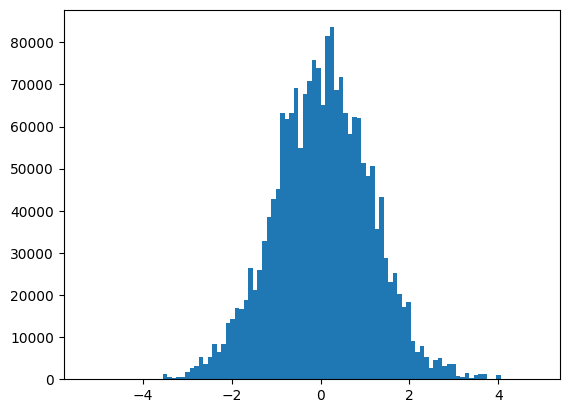

ic| out.shape: (50000, 40)


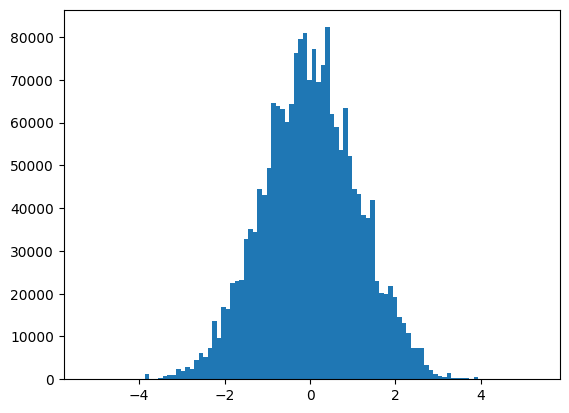

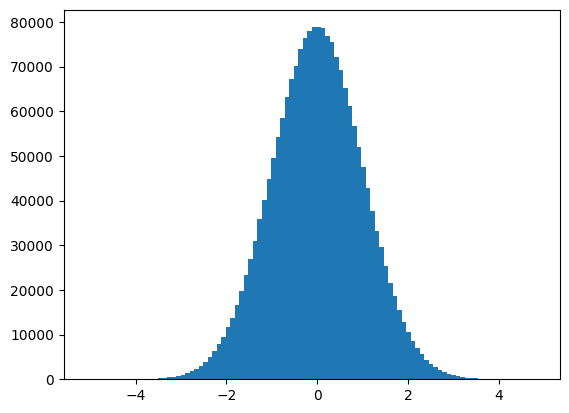

ic| out.shape: (50000, 50)


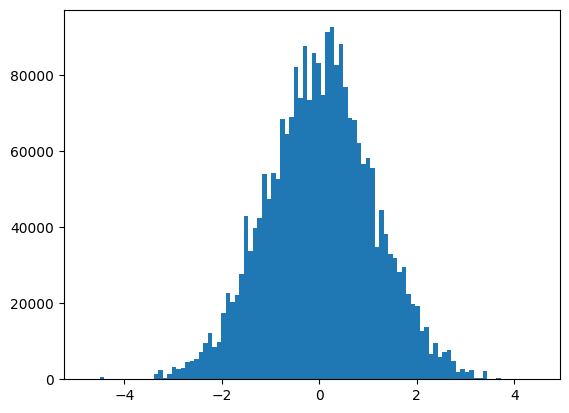

In [24]:
out = key_booster.predict(dtrain, output_margin=True)
ic(out.shape)
a = plt.hist(out.flatten(),bins =100)
plt.show()
out = query_booster.predict(dtrain, output_margin=True)
ic(out.shape)
a = plt.hist(out.flatten(),bins =100)
plt.show()
a = plt.hist(np.random.randn(*out.shape).flatten(),bins =100)
plt.show()
out = value_booster.predict(dtrain, output_margin=True)
ic(out.shape)
a = plt.hist(out.flatten(),bins =100)
plt.show()

# a = plt.hist(out[:,:value_dim].flatten(),bins =100)
# plt.show()

In [25]:
ic(key_booster.num_boosted_rounds())
key_booster.save_model('key_booster.json')

ic(query_booster.num_boosted_rounds())
query_booster.save_model('query_booster.json')

ic(value_booster.num_boosted_rounds())
value_booster.save_model('value_booster.json')



ic| key_booster.num_boosted_rounds(): 5
ic| query_booster.num_boosted_rounds(): 5
ic| value_booster.num_boosted_rounds(): 5


In [26]:
k_booster_conf = key_booster.save_config()
q_booster_conf = query_booster.save_config()
v_booster_conf = value_booster.save_config()


In [27]:
# # Parse JSON into an object with attributes corresponding to dict keys.
# with open('./classifier_booster.json',mode="r") as json_data:
#     classifier_json = json.load(json_data, object_hook=lambda d: SimpleNamespace(**d))


In [28]:
# import asyncio

# import nest_asyncio
# nest_asyncio.apply()

# def background(f):
#     def wrapped(*args, **kwargs):
#         return asyncio.get_event_loop().run_in_executor(None, f, *args, **kwargs)

#     return wrapped

# @background
# def do_tree(tidx,tree,leaf_pred_perTree, grad, hess,prams,scale,step): # Added another argument
#     size_leaf_vector = int(tree.tree_param.size_leaf_vector)
#     leaf_pred = leaf_pred_perTree[:,tidx]
#     for leaf in  list(np.unique(leaf_pred)):
#         indeces = np.where(leaf_pred == leaf)
#         num = -(prams['eta']*grad.reshape(-1,size_leaf_vector)[indeces].sum(0))
#         den = (prams['lambda'] + hess.reshape(-1,size_leaf_vector)[indeces].sum(0))

#         new_weights = scale*np.array(tree.base_weights[leaf*size_leaf_vector:leaf*size_leaf_vector+size_leaf_vector]) 
#         new_weights +=  step*num/den # (1/len(self.trees))*
#         tree.base_weights[leaf*size_leaf_vector:leaf*size_leaf_vector+size_leaf_vector] = list(new_weights.round(10))

    

In [29]:
class JsonBoosterWrapper():
    def __init__(self, path):
        self.path = path
        self.scale = .99
        self.step = 1
        
        with open(self.path,mode="r") as json_data:
            self.booster_json = json.load(json_data, object_hook=lambda d: SimpleNamespace(**d))
        self.trees = self.booster_json.learner.gradient_booster.model.trees
        self.select_history = len(self.trees)*[1]
        
    def reload(self):
        with open(self.path,mode="r") as json_data:
            self.booster_json = json.load(json_data, object_hook=lambda d: SimpleNamespace(**d))
        self.trees = self.booster_json.learner.gradient_booster.model.trees
        temp = len(self.trees)*[1]
        self.select_history += (temp[len(self.select_history):])
        
    def calc_out(self, leaf_pred_perTree):
        leaf_pred_perTree = leaf_pred_perTree.astype('int')
        output = 0
        for tidx, tree in enumerate(self.trees):
            leaf_pred = leaf_pred_perTree[:,tidx]
            
            num_nodes = int(tree.tree_param.num_nodes)
            size_leaf_vector = int(tree.tree_param.size_leaf_vector)
            leaf_matrix = np.array(tree.base_weights).reshape(num_nodes,size_leaf_vector)
            output += leaf_matrix[leaf_pred,:]
        return output

    def update_weights(self, leaf_pred_perTree, grad, hess, prams):
        self.reload()
        leaf_pred_perTree = leaf_pred_perTree.astype('int')
        
        selected_trees = random.choices(list(range(len(self.trees)-1)), weights=self.select_history[:-1] , k = 100)

        # ic(selected_trees)
        # ic(self.select_history)
        for tidx, tree in enumerate(self.trees):
            # if tidx not in selected_trees:
            #     continue
            self.select_history[tidx]*= .8
            size_leaf_vector = int(tree.tree_param.size_leaf_vector)
            leaf_pred = leaf_pred_perTree[:,tidx]
            for leaf in  list(np.unique(leaf_pred)):
                indeces = np.where(leaf_pred == leaf)
                num = -(prams['eta']*grad.reshape(-1,size_leaf_vector)[indeces].sum(0))
                den = (prams['lambda'] + hess.reshape(-1,size_leaf_vector)[indeces].sum(0))

                # if num.shape[-1]!= size_leaf_vector:
                #     ic(num.shape)
                # if den.shape[-1]!= size_leaf_vector:
                #     ic(den.shape)

                try:
                    new_weights = self.scale*np.array(tree.base_weights[leaf*size_leaf_vector:leaf*size_leaf_vector+size_leaf_vector]) 
                    new_weights +=  self.step*num/den # (1/len(self.trees))*
                    tree.base_weights[leaf*size_leaf_vector:leaf*size_leaf_vector+size_leaf_vector] = list(new_weights.round(10))
                except:
                    ic(num.shape)
                    ic(den.shape)
                    ic(tidx,size_leaf_vector,indeces[0].shape)
                    ic (num, den)
                    new_weights = self.scale*np.array(tree.base_weights[leaf*size_leaf_vector:leaf*size_leaf_vector+size_leaf_vector]) 
                    new_weights +=  self.step*num/den # (1/len(self.trees))*
                    tree.base_weights[leaf*size_leaf_vector:leaf*size_leaf_vector+size_leaf_vector] = list(new_weights.round(10))

        self.model_save()
        
    def model_save(self,file_name=None):
        file_name = file_name or self.path
        with open(file_name, 'w' , encoding='utf-8') as f:
            json.dump(self.booster_json, f, default= lambda obj: obj.__dict__ )

In [30]:
treeess = 0

In [31]:
# ### sanity check
# leaf_pred = classifier_booster.predict(c_dtrain, pred_leaf=True)
# classifier_wrapper = JsonBoosterWrapper('classifier_booster.json')
# test = classifier_wrapper.calc_out(leaf_pred)

# orig = classifier_booster.predict(c_dtrain, output_margin=True)

# loaded_booster = Booster(classifier_param)
# loaded_booster.load_model('classifier_booster.json')
# loaded = loaded_booster.predict(c_dtrain, output_margin=True)

# ic(np.isclose(test, orig,  rtol=1e-04, atol=1e-06).all() ,np.isclose(loaded, orig).all())

In [32]:
# loaded_booster.save_config()
# classifier_booster.save_config()
# nth_tree = 4
# len(classifier_wrapper.booster_json.learner.gradient_booster.model.trees[nth_tree].base_weights) 
# num_class*int(classifier_json.learner.gradient_booster.model.trees[nth_tree].tree_param.num_nodes)

In [33]:
# grad check --- vlaue size :10
# nth_tree = 4
# last = leaf_pred[:,4].astype('int')
# ic(np.unique(last)[0])

# index_f = np.where(last == np.unique(last)[0])
# update = -(classifier_param['eta']*grad.reshape(-1,10)[index_f].sum(0))/(classifier_param['lambda'] 
#                                                                          + hess.reshape(-1,10)[index_f].sum(0))
# ic(list(update.round(10)))
# ic([np.unique(last)[0]*10,np.unique(last)[0]*10+10])
# orig = classifier_wrapper.booster_json.learner.gradient_booster.model.trees[nth_tree].base_weights\
#                                                                         [np.unique(last)[0]*10:np.unique(last)[0]*10+10]
# ic(orig)

# classifier_wrapper.update_weights(leaf_pred, grad, hess, classifier_param)
# after_step = classifier_wrapper.booster_json.learner.gradient_booster.model.trees[nth_tree].base_weights\
#                                                                         [np.unique(last)[0]*10:np.unique(last)[0]*10+10]
# ic(after_step)
# print('done!')

In [34]:
Fix_linear_Mapping = np.random.randn(50,50)
Fix_linear_Mapping = scipy.linalg.orth(Fix_linear_Mapping)
if scipy.linalg.det(Fix_linear_Mapping)<0:
    Fix_linear_Mapping[0] = -Fix_linear_Mapping[0]

ic(Fix_linear_Mapping.min(),Fix_linear_Mapping.max(),scipy.linalg.det(Fix_linear_Mapping))

Fix_linear_Mapping = torch.from_numpy(Fix_linear_Mapping).float()
ic(torch.det(Fix_linear_Mapping))

ic| Fix_linear_Mapping.min(): -0.467621146886554
    Fix_linear_Mapping.max(): 0.5366674989792979
    scipy.linalg.det(Fix_linear_Mapping): 1.0000000000000044
ic| torch.det(Fix_linear_Mapping): tensor(1.0000)


tensor(1.0000)

In [35]:
def predict_inner(key, query, value):

    values = value.reshape(-1,block_size,value_dim)
    values_k = values[...,:embeding_dim]
    values_v = values[...,embeding_dim:]
    
    keys = key.reshape(-1,block_size,embeding_dim)
    queries = query.reshape(-1,block_size, embeding_dim)
    
    B, T, C = keys.size()
    
    keys = keys.view(B, T, n_head_layer1, C // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
    queries = queries.view(B, T, n_head_layer1, C // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
    values_k = values_k.view(B, T, n_head_layer1, embeding_dim // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
    values_v = values_v.view(B, T, n_head_layer1, num_class // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)

    values = torch.cat([values_k,values_v], dim=-1)


    
    
    if flash:
        # efficient attention using Flash Attention CUDA kernels
        layer1_value = F.scaled_dot_product_attention(queries, keys, values, attn_mask=None, dropout_p= 0, is_causal=False)
        layer1_k = layer1_value[...,: (embeding_dim // n_head_layer1) ].transpose(1, 2).contiguous().view(B, T, embeding_dim)
        layer1_v = layer1_value[...,(embeding_dim // n_head_layer1) :].transpose(1, 2).contiguous().view(B, T, num_class)
    else:
        # manual implementation of attention
        att = (queries @ keys.transpose(-2, -1)) * (1.0 / np.sqrt(keys.size(-1))) # (B, nh, T, T)
        att = F.softmax(att, dim=-1)

        layer1_value = att  @ values  # (B, nh, T, T) x (B, nh, T, hs) -> (B, nh, T, hs)
        layer1_k = layer1_value[...,: (embeding_dim // n_head_layer1) ].transpose(1, 2).contiguous().view(B, T, embeding_dim)
        layer1_v = layer1_value[...,(embeding_dim // n_head_layer1) :].transpose(1, 2).contiguous().view(B, T, num_class)
    
    layer1_value_seq = torch.cat([layer1_k,layer1_v], dim=-1).view(B, T, 1, value_dim) # re-assemble all  outputs for linear mapping
    layer1_value_seq = (layer1_value_seq@Fix_linear_Mapping).view(B, T,value_dim)
    layer1_value_seq = F.layer_norm(layer1_value_seq, [value_dim])

    layer2_keys = layer1_value_seq[:,1:,:embeding_dim] # (B, T-1, hs = embeding_dim)
    layer2_keys = layer2_keys.view(B, T-1, n_head_layer2, C // n_head_layer2).transpose(1, 2) # (B, nh2, T-1, hs)
    
    layer2_values = layer1_value_seq[:,1:,embeding_dim:] # # (B, T, num_class)
    layer2_values = layer2_values.view(B, T-1, n_head_layer2, num_class // n_head_layer2).transpose(1, 2) # (B, nh2, T-1, vs )

    layer2_queries =  layer1_value_seq[:,[0],:embeding_dim]  # (B, T=1, hs = embeding_dim)
    layer2_queries = layer2_queries.view(B, 1, n_head_layer2, C // n_head_layer2).transpose(1, 2) # (B, nh2, T=1, hs)

    layer2_q_values = layer1_value_seq[:,0,embeding_dim:] # # (B, T=1, num_class)

    # manual implementation of attention
    att2 = (layer2_queries @ layer2_keys.transpose(-2, -1)) * (1.0 / np.sqrt(layer2_keys.size(-1))) # (B, nh2, 1, T-1)
    att2 = F.softmax(att2, dim=-1)

    n_head_output = att2  @ layer2_values  # (B, nh, T=1, T) x (B, nh2, T, vs ) -> (B, nh2, T=1, vs )
    
    output = n_head_output.view(B,num_class) + layer2_q_values
    return output


def predict(key, query, value, has_grad = True):

    approx_hess = True
    
    key = key.copy()
    query = query.copy()
    value = value.copy()
    
    key = torch.from_numpy(key).float().requires_grad_(True)
    query = torch.from_numpy(query).float().requires_grad_(True)
    value = torch.from_numpy(value).float().requires_grad_(True)

    output = predict_inner(key, query, value)
    
    grad = {}
    grad2 = {}
    hess = {}
    if has_grad:
        loss = 0
        loss += F.cross_entropy(output ,target,reduction='sum', label_smoothing=0.00)
        r_loss = loss.item()
        loss.backward()
        # print(keys.grad)
        grad["key"] = key.grad.numpy().flatten() *1
        grad["query"] = query.grad.numpy().flatten() *1
        grad["value"] = value.grad.numpy().flatten() *1


        if approx_hess:
            with torch.no_grad():
                key.data.add_(-0.01*key.grad)
                key.grad.zero_()
                query.data.add_(-0.01*query.grad)
                query.grad.zero_()
                value.data.add_(-0.01*value.grad)
                value.grad.zero_()


            output = predict_inner(key, query, value)
            loss = 0
            loss += F.cross_entropy(output ,target,reduction='sum', label_smoothing=0.00)
            loss.backward()

            grad2["key"] = key.grad.numpy().flatten()
            grad2["query"] = query.grad.numpy().flatten()
            grad2["value"] = value.grad.numpy().flatten()


            
            hess["key"] =  0.1* ((grad2["key"]     - grad["key"])/(- 0.01*grad["key"] - 
                                                               (2*(grad["key"] >= 0) - 1)*1e-6)).clip(min=1e-0,max=10)
            hess["query"] = 0.1*((grad2["query"] - grad["query"])/(- 0.01*grad["query"]- 
                                                               (2*(grad["query"] >= 0) - 1)*1e-6)).clip(min=1e-0,max=10)
            hess["value"] = 0.1*((grad2["value"] - grad["value"])/(- 0.01*grad["value"]- 
                                                               (2*(grad["value"] >= 0) - 1)*1e-6)).clip(min=1e-0,max=10)


        
        return output, grad, hess, r_loss
        
    return output

### INITIAL STATE

In [36]:
b = 0
all_test_preds = []
all_test_labels = []
all_model_outputs = []

for i, data in enumerate(TestLoader):
    print(i)
    x , target , full_image = data['image_seq'] , data['label'] , data['image']
    model_XT = x.reshape(-1,input_dim)
    dtrain = xgb.DMatrix(model_XT.numpy())
    
    key = key_booster.predict(dtrain, output_margin=True)
    query = query_booster.predict(dtrain, output_margin=True)
    value = value_booster.predict(dtrain, output_margin=True)

    
    with torch.no_grad():
        predicts = predict(key, query, value, has_grad=False)
    all_model_outputs.append(np.concatenate([value, key, query], axis=-1))
    yhat = predicts.argmax(dim=-1).numpy()
    all_test_preds.append(yhat)
    all_test_labels.append(target.numpy())
    break


preds = np.concatenate(all_test_preds)
labels = np.concatenate(all_test_labels)
model_outputs_test = np.concatenate(all_model_outputs)
predicts.shape

0


torch.Size([1000, 10])

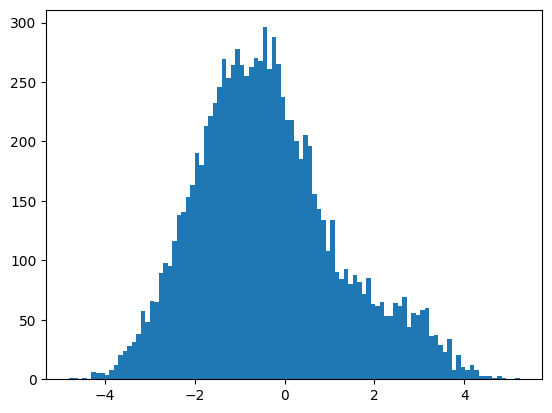

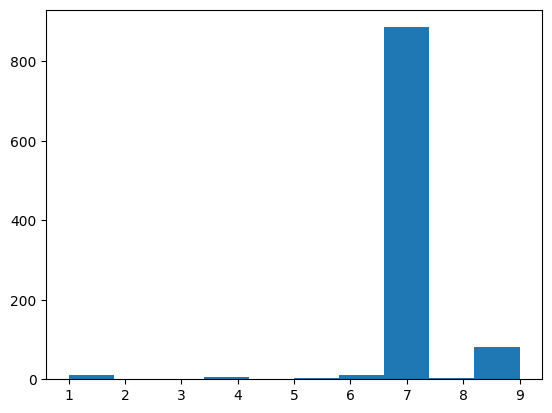

In [37]:
a = plt.hist(predicts.flatten(),bins =100)
plt.show()
a = plt.hist(yhat.flatten(),bins =10)
plt.show()

In [38]:
t=10

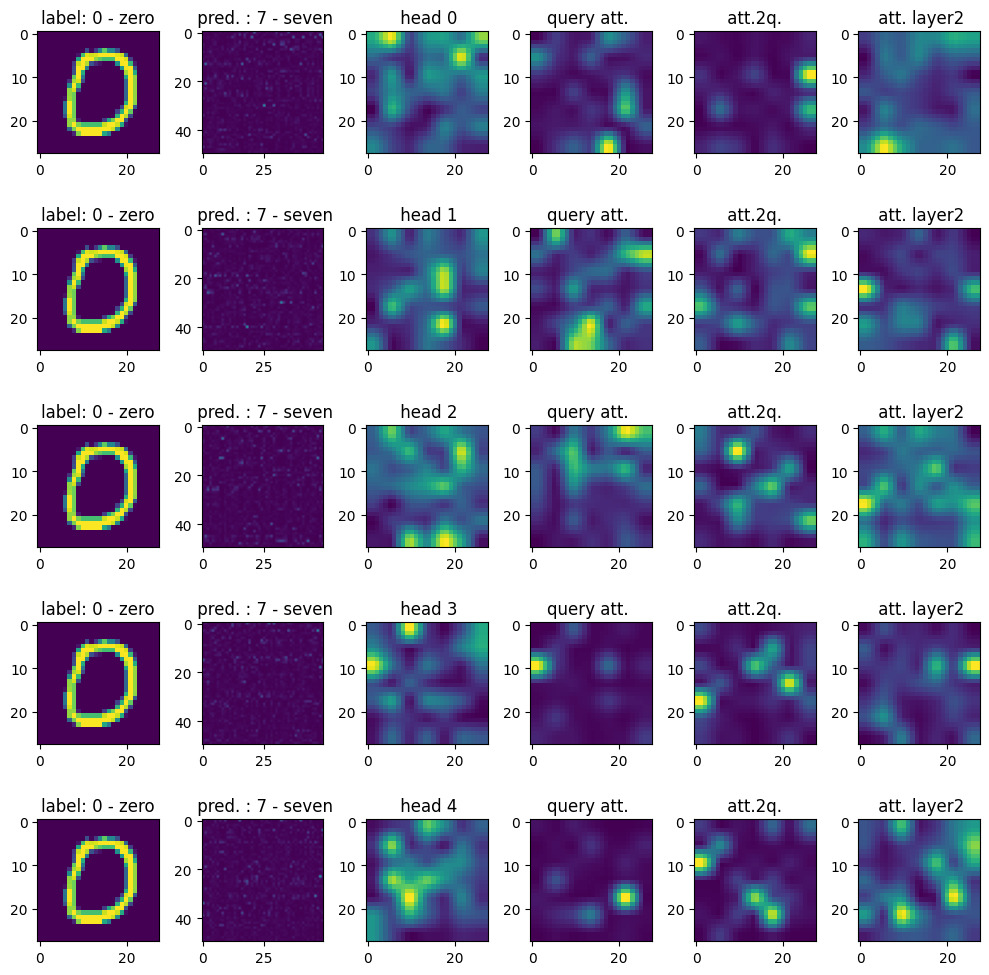

ic| t: 10


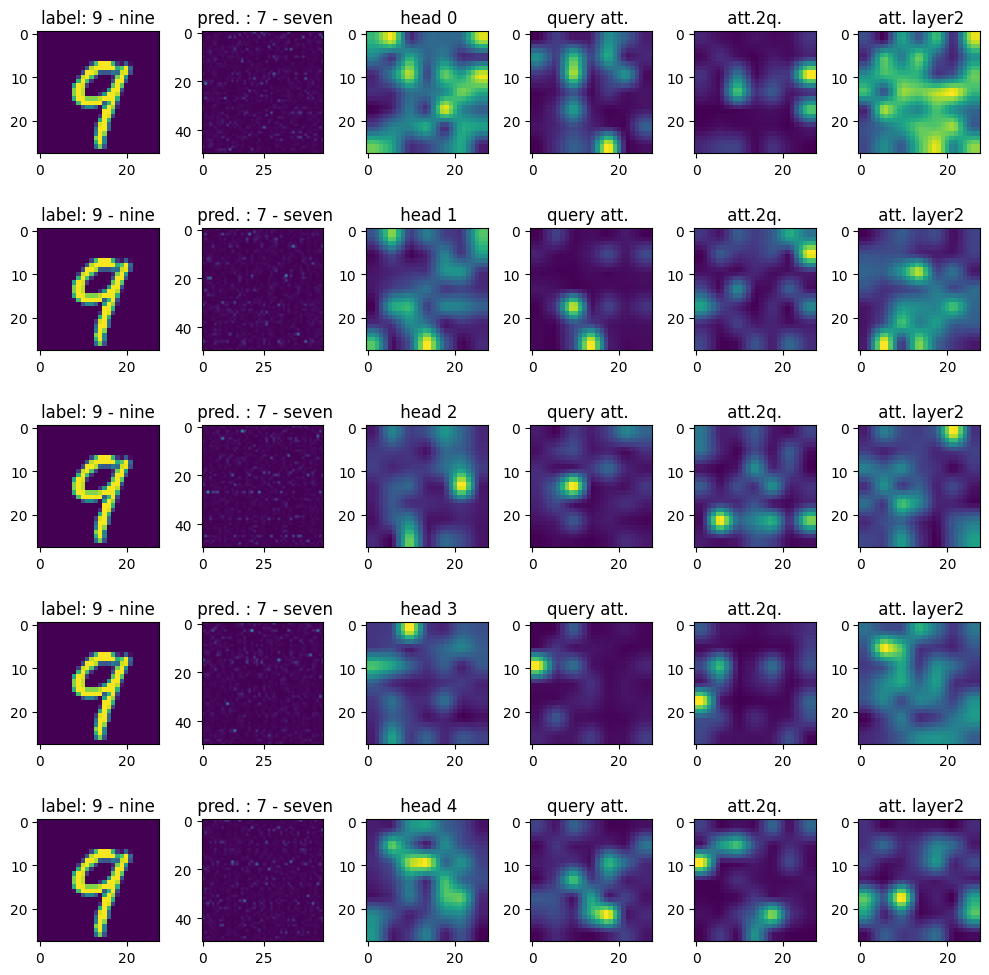

ic| t: 12


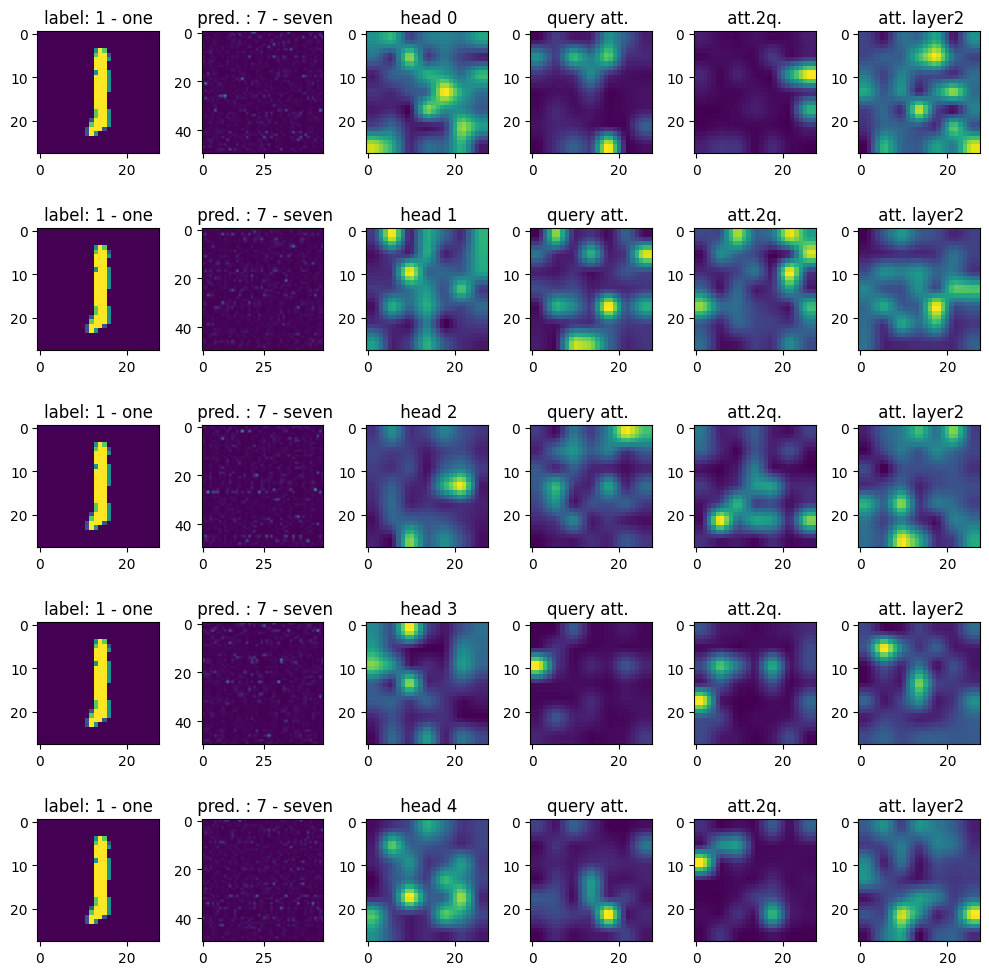

ic| t: 14


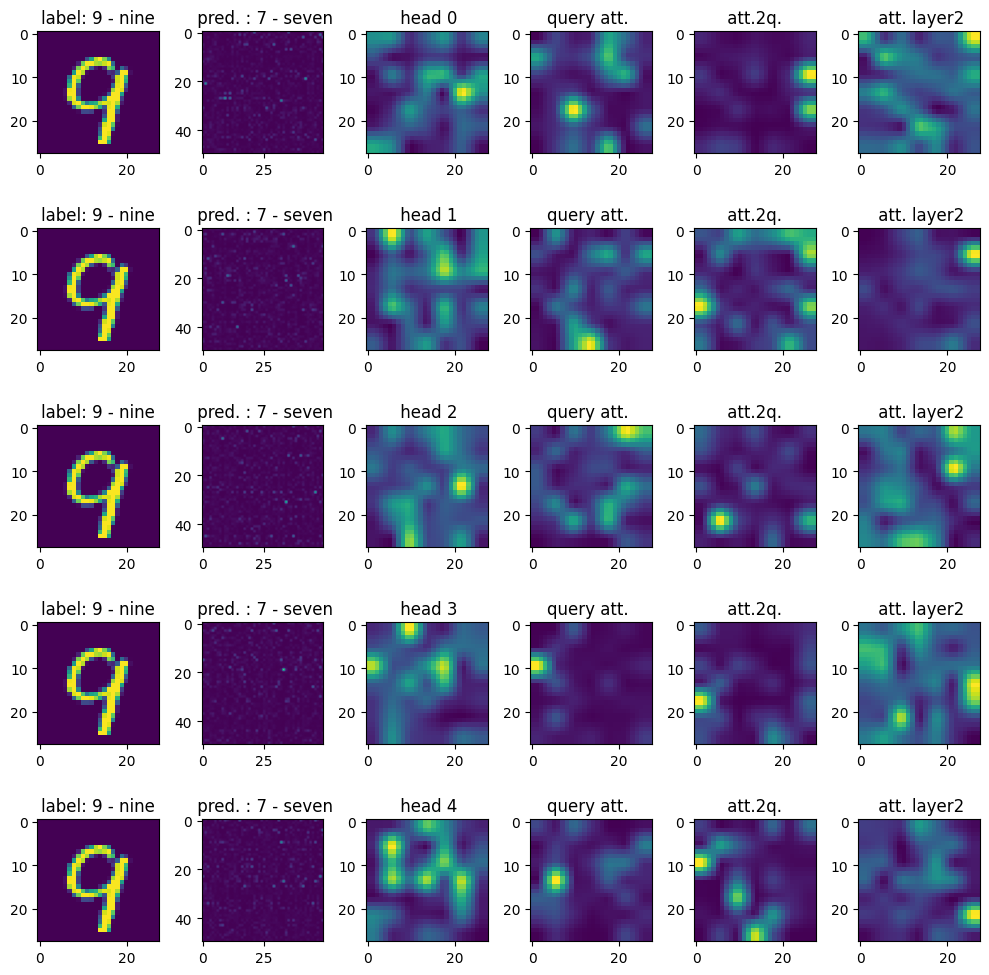

ic| t: 16


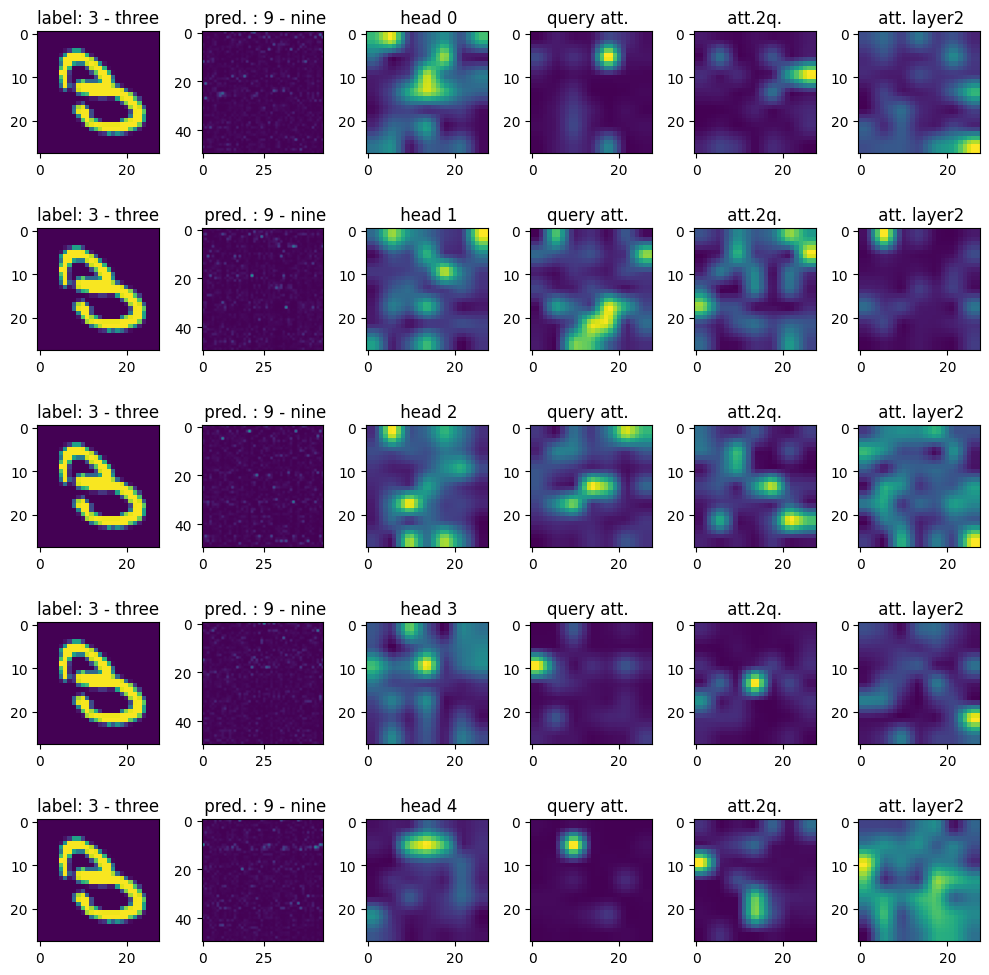

ic| t: 18


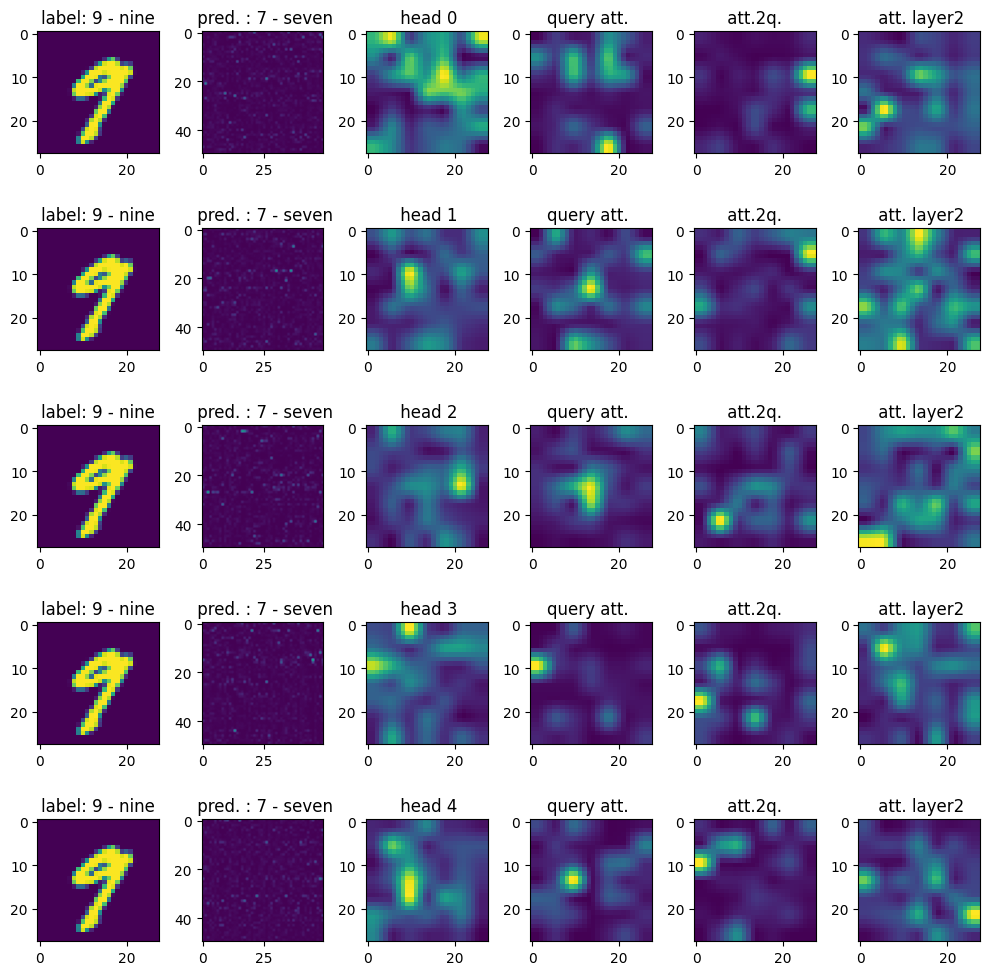

ic| t: 20


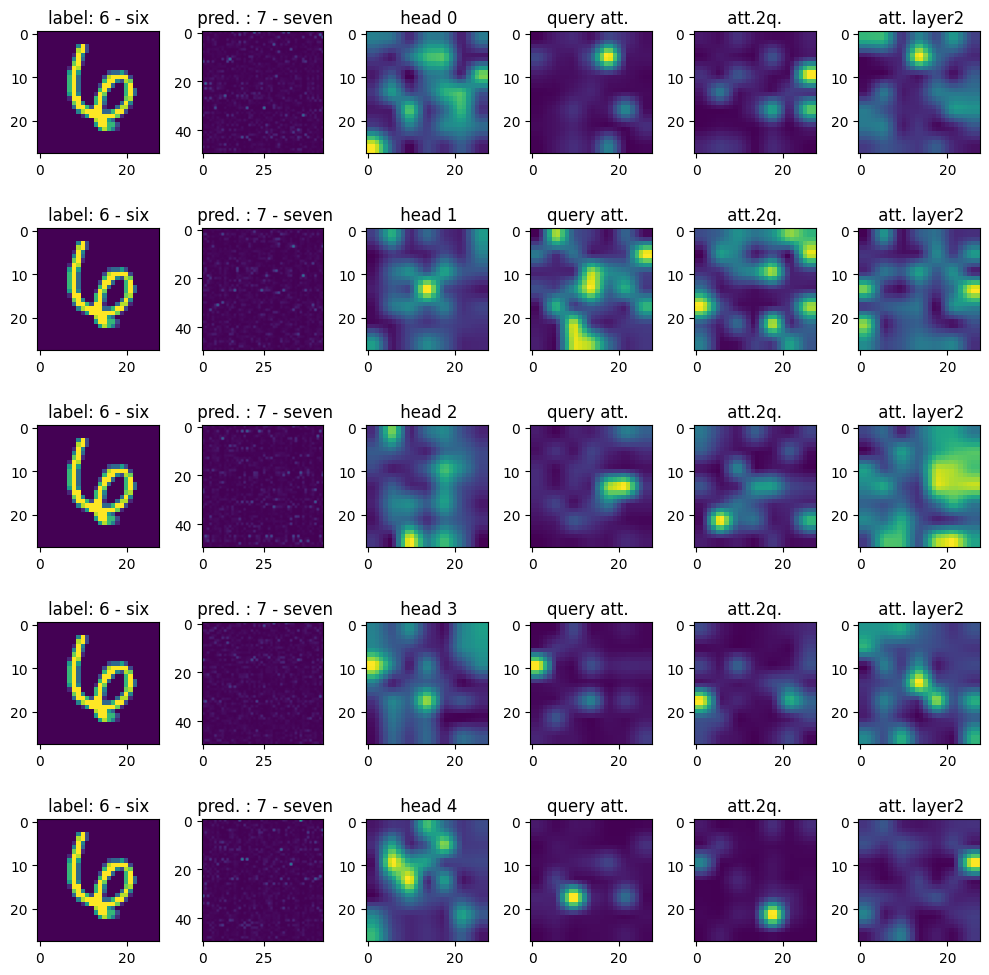

ic| t: 22


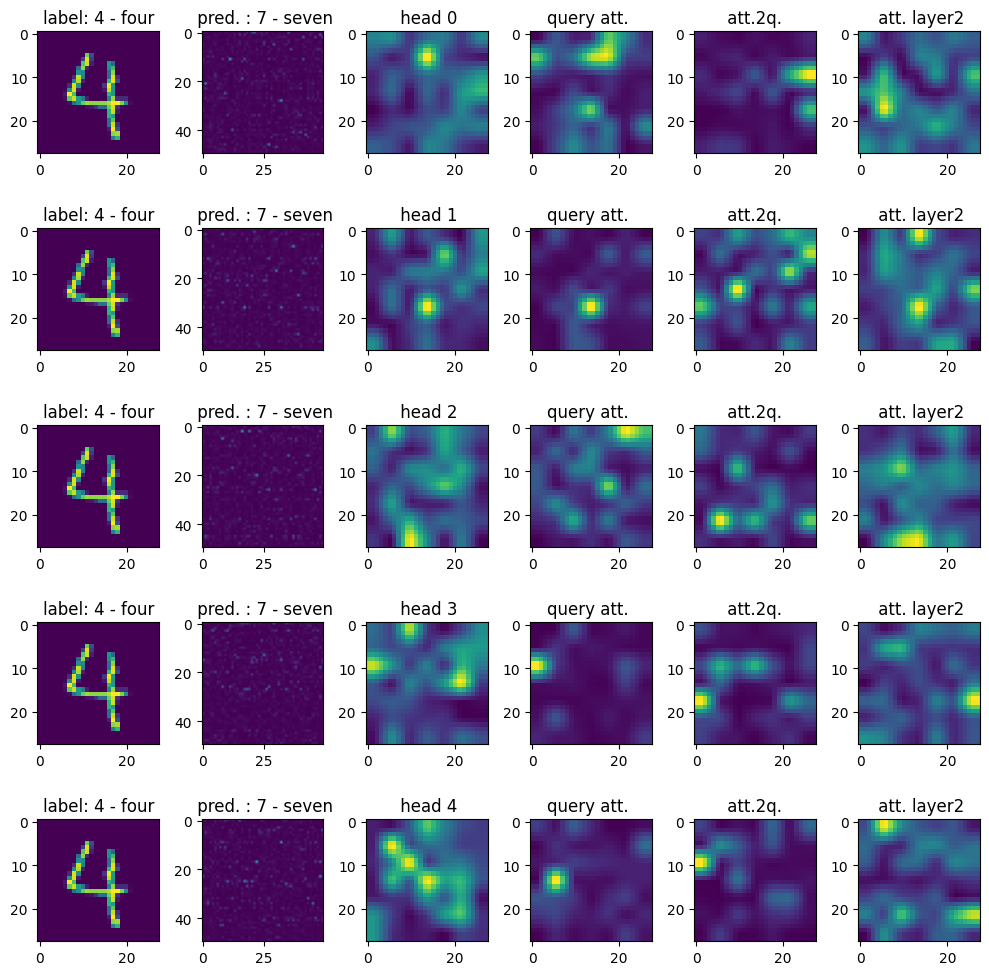

ic| t: 24


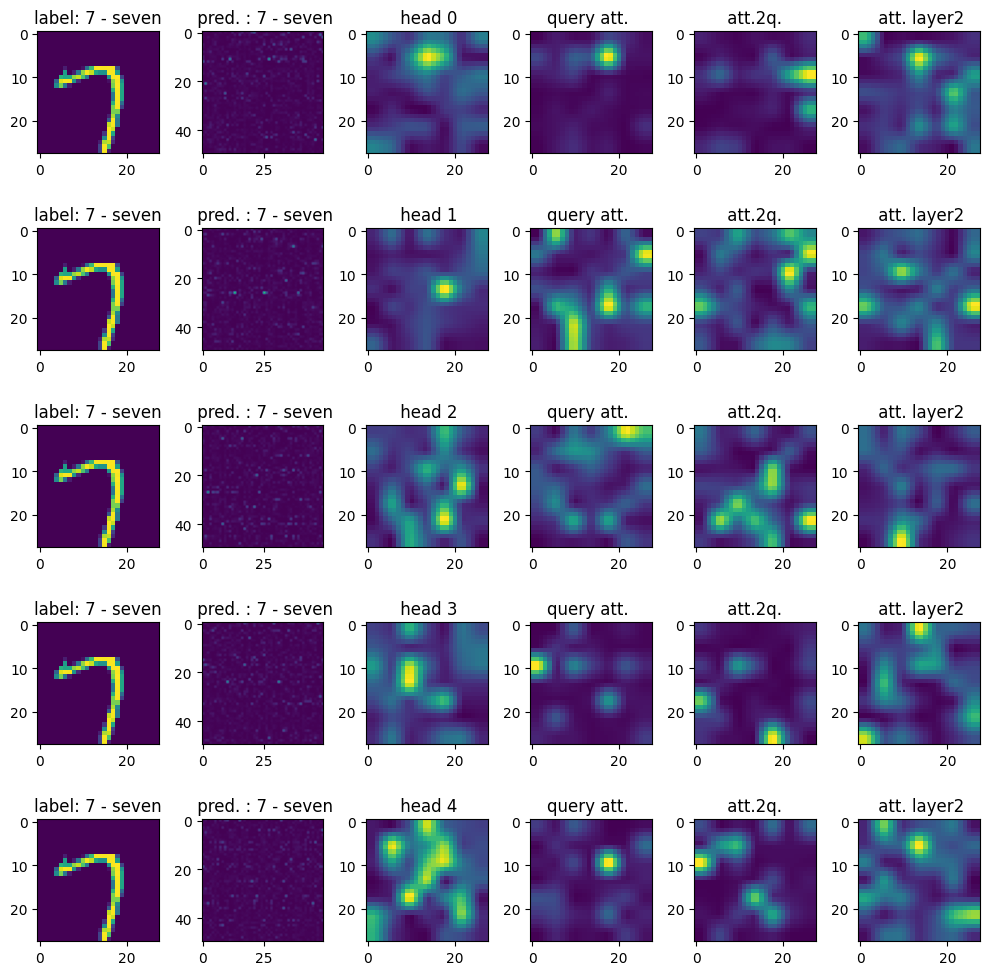

ic| t: 26


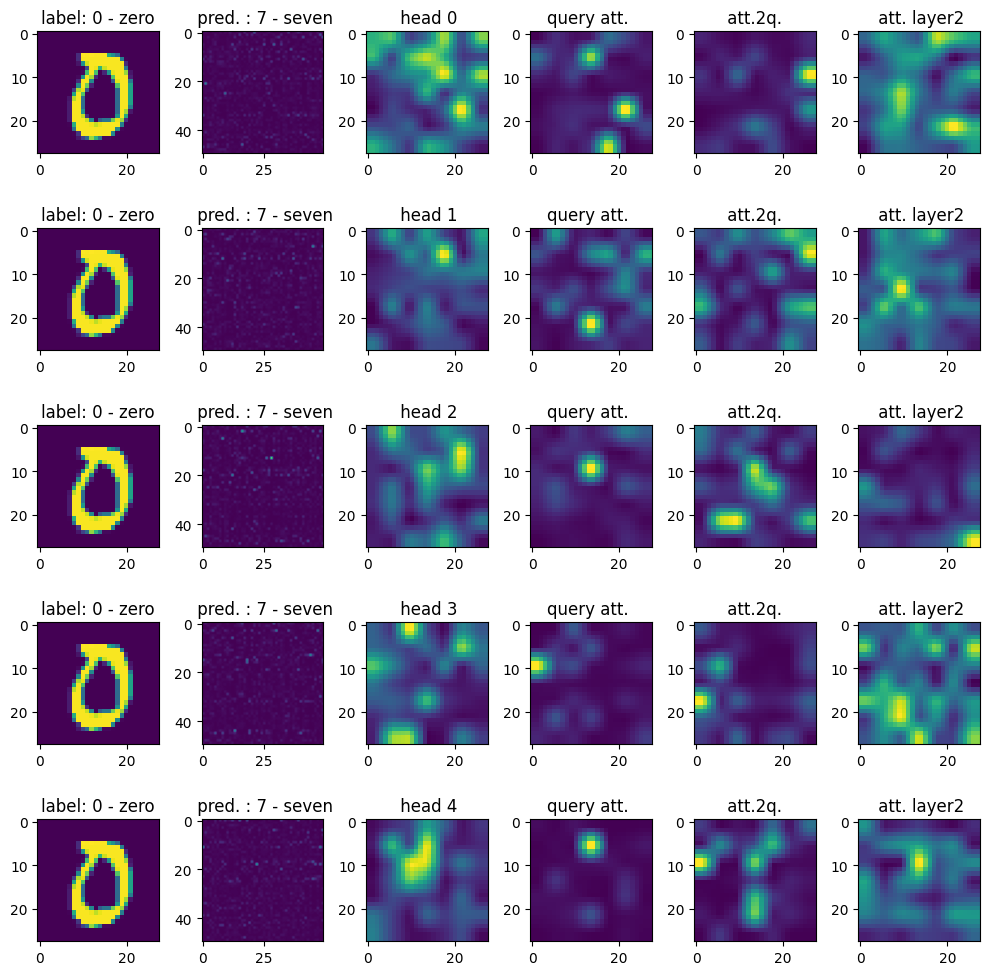

ic| t: 28


In [39]:
for c in range(10):
    if True:
        if n_head_layer1 == 1:
            fig, axes = plt.subplots(1,6 , figsize=(10,3))
            axes = axes[None]
        else:
            fig, axes = plt.subplots(n_head_layer1,6 , figsize=(10,n_head_layer1*2))
        
        
        with torch.no_grad():
            pred0 = model_outputs_test[t*block_size:t*block_size + block_size]
            
            pred0 = torch.from_numpy(pred0.copy()).float().requires_grad_(False)
        
            values = pred0[:, :value_dim].reshape(-1,block_size,value_dim)
            values_k = values[...,:embeding_dim]
            values_v = values[...,embeding_dim:]
    
            keys = pred0[:, value_dim: value_dim + embeding_dim].reshape(-1,block_size,embeding_dim)
            queries = pred0[:, value_dim + embeding_dim:value_dim + 2*embeding_dim] .reshape(-1,block_size, embeding_dim)
            # keys = pred0[:, value_dim: value_dim + embeding_dim].reshape(-1,block_size,embeding_dim)
            # queries = pred0[:, value_dim + embeding_dim:value_dim + 2*embeding_dim] .reshape(-1,block_size, embeding_dim)
            B, T, C = keys.size()
            
            keys = keys.view(B, T, n_head_layer1, C // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            queries = queries.view(B, T, n_head_layer1, C // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            values_k = values_k.view(B, T, n_head_layer1, embeding_dim // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            values_v = values_v.view(B, T, n_head_layer1, num_class // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            
            values = torch.cat([values_k,values_v], dim=-1)
            
            att = (queries @ keys.transpose(-2, -1)) * (1.0 / np.sqrt(keys.size(-1)))
            # att = att.masked_fill(self.bias[:,:,:T,:T] == 0, float('-inf')) # causal implementation 
            att = F.softmax(att, dim=-1)
            # att = F.relu(att)
            layer1_value = att @ values  # (B, nh, T, T) x (B, nh, T, hs) -> (B, nh, T, hs)

            layer1_value = att  @ values  # (B, nh, T, T) x (B, nh, T, hs) -> (B, nh, T, hs)
            layer1_k = layer1_value[...,: (embeding_dim // n_head_layer1) ].transpose(1, 2).contiguous().view(B, T, embeding_dim)
            layer1_v = layer1_value[...,(embeding_dim // n_head_layer1) :].transpose(1, 2).contiguous().view(B, T, num_class)
    
            layer1_value_seq = torch.cat([layer1_k,layer1_v], dim=-1).view(B, T, 1, value_dim) # re-assemble all  outputs for linear mapping
            layer1_value_seq = (layer1_value_seq@Fix_linear_Mapping).view(B, T,value_dim)
            layer1_value_seq = F.layer_norm(layer1_value_seq, [value_dim])
        
            layer2_keys = layer1_value_seq[:,1:,:embeding_dim] # (B, T-1, hs = embeding_dim)
            layer2_keys = layer2_keys.view(B, T-1, n_head_layer2, C // n_head_layer2).transpose(1, 2) # (B, nh2, T-1, hs)
            
            layer2_values = layer1_value_seq[:,1:,embeding_dim:] # # (B, T, num_class)
            layer2_values = layer2_values.view(B, T-1, n_head_layer2, num_class // n_head_layer2).transpose(1, 2) # (B, nh2, T-1, vs )
        
            layer2_queries =  layer1_value_seq[:,[0],:embeding_dim]  # (B, T=1, hs = embeding_dim)
            layer2_queries = layer2_queries.view(B, 1, n_head_layer2, C // n_head_layer2).transpose(1, 2) # (B, nh2, T=1, hs)
        
            layer2_q_values = layer1_value_seq[:,0,embeding_dim:] # # (B, T=1, num_class)
        
            # manual implementation of attention
            att2 = (layer2_queries @ layer2_keys.transpose(-2, -1)) * (1.0 / np.sqrt(layer2_keys.size(-1))) # (B, nh2, 1, T-1)
            att2 = F.softmax(att2, dim=-1)
        
            n_head_output = att2  @ layer2_values  # (B, nh, T=1, T) x (B, nh2, T, vs ) -> (B, nh2, T=1, vs )
            
            output = n_head_output.view(B,num_class) #+ layer2_q_values
            

            # ic(F.softmax(output,dim=-1))
            for i, heads in enumerate(zip(att[0],att2[0])):
                head , head2 = heads
                axes[i,0].imshow(Testset.data[t])
                axes[i,0].set_title('label: ' + str(Testset.classes[Testset.targets[t]]) )
                
                axes[i,1].imshow(head.T,vmin=0, vmax=1)
                # axes[i,1].imshow(F.relu(head.T),vmin=0)
                # axes[i,1].imshow(head.T)
                tttt = Testset.classes[preds[t]]
                axes[i,1].set_title( ' pred. : ' +  tttt )
                # plt.show()

                attention_mask_path = head.sum(0)[1:].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
    #             print( att.sum(0))
                image = cv2.resize(attention_mask_path, (28, 28))
                # ic(image)
                axes[i,2].imshow(image)
                axes[i,2].set_title(f' head {i}')

                att_q = head[0,1:].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,3].imshow(cv2.resize(att_q, (28, 28)))
                axes[i,3].set_title(f'query att. ')

                att_q = head[1:,0].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,4].imshow(cv2.resize(att_q, (28, 28)))
                axes[i,4].set_title(f' att.2q. ')
                
        #         axes[2].imshow(attention_mask)
                att_2 = head2.reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,5].imshow(cv2.resize(att_2, (28, 28)))
                axes[i,5].set_title(f' att. layer2')
        #         axes[2].imshow(att.sum(0).reshape(int(len(tiles)**.5),int(len(tiles)**.5)), interpolation="bicubic")
            fig.tight_layout()   
            plt.show()
    
    ic(t)
    t+=2

In [40]:
key_param = {'max_depth':9, 'base_score':.0,
             'tree_method':'hist', 'multi_strategy': 'multi_output_tree',
             'min_child_weight' : .000, 
             'eta': .03,
             'num_feature':input_dim,
             'num_class': embeding_dim,
             'lambda':1 } # default=1

query_param = {'max_depth':9, 'base_score':.0,
               'tree_method':'hist', 'multi_strategy': 'multi_output_tree',
               'min_child_weight' : .000, 
               'eta': .03,
               'num_feature':input_dim,
               'num_class': embeding_dim,
               'lambda':1 } # default=1

value_param = {'max_depth':9, 'base_score':.0,
               'tree_method':'hist', 'multi_strategy': 'multi_output_tree',
               'min_child_weight' : .000,
               'eta': .03,
               'num_feature':input_dim,
               'num_class': embeding_dim + num_class,
               'lambda':1 } # default=1




key_booster.set_param(key_param)
query_booster.set_param(query_param)
value_booster.set_param(value_param)
it = 0

In [41]:
def plot():
    pass


In [42]:
@torch.no_grad()
def confusion_score(dataloader):
    cm = None
    
    for i, data in enumerate(dataloader):
        x , target , full_image = data['image_seq'] , data['label'] , data['image']
        model_XT = x.reshape(-1,input_dim)
        dtrain = xgb.DMatrix(model_XT.numpy())
        
        key = key_booster.predict(dtrain, output_margin=True)
        query = query_booster.predict(dtrain, output_margin=True)
        value = value_booster.predict(dtrain, output_margin=True)
    

        
        with torch.no_grad():
            predicts = predict(key, query, value, has_grad=False)
        yhat = predicts.argmax(dim=-1).numpy() 
        if cm is None:
            cm = confusion_matrix(target.numpy(),yhat)
        else:
            cm += confusion_matrix(target.numpy(),yhat)
    print('Acc.',cm.diagonal().sum()/len(dataloader.dataset)) 
    return cm

In [43]:
key_wrapper = JsonBoosterWrapper('key_booster.json')
query_wrapper = JsonBoosterWrapper('query_booster.json')
value_wrapper = JsonBoosterWrapper('value_booster.json')


In [44]:
it = 1

for epoch in range(1):
    for i, data in enumerate(TrainLoader):
        x , target , full_image = data['image_seq'] , data['label'] , data['image']
        model_XT = x.reshape(-1,input_dim)
        dtrain = xgb.DMatrix(model_XT.numpy())
        

        key = key_booster.predict(dtrain, output_margin=True)
        query = query_booster.predict(dtrain, output_margin=True)
        value = value_booster.predict(dtrain, output_margin=True)
    
        predicts, grad, hess, loss = predict(key, query, value )
    
        key_booster.boost(dtrain, grad["key"], hess["key"])
        query_booster.boost(dtrain, grad["query"], hess["query"])
        value_booster.boost(dtrain, grad["value"], hess["value"])

        key_leaf_pred = key_booster.predict(dtrain, pred_leaf=True)
        key_booster.save_model('key_booster.json')
        key_wrapper.update_weights(key_leaf_pred, grad["key"], hess["key"], key_param)

        query_leaf_pred = query_booster.predict(dtrain, pred_leaf=True)
        query_booster.save_model('query_booster.json')
        query_wrapper.update_weights(query_leaf_pred, grad["query"], hess["query"], query_param)

        value_leaf_pred = value_booster.predict(dtrain, pred_leaf=True)
        value_booster.save_model('value_booster.json')
        value_wrapper.update_weights(value_leaf_pred, grad["value"], hess["value"], value_param)


        
        key_booster = Booster(key_param,model_file='key_booster.json')
        query_booster = Booster(query_param,model_file='query_booster.json')
        value_booster = Booster(value_param,model_file='value_booster.json')
        # classifier_booster.load_config(c_booster_conf)
        # classifier_booster.load_model('classifier_booster.json')
    
        print(f'iteration {it} ' , loss/batch_size)
        it += 1
        if i == 9 :
            plot()

    confusion_score(TrainLoader)
    confusion_score(TestLoader)

iteration 1  3.69087451171875
iteration 2  3.0852578125
iteration 3  2.829076171875
iteration 4  2.668480224609375
iteration 5  2.495145263671875
iteration 6  2.375748046875
iteration 7  2.22731201171875
iteration 8  2.10645361328125
iteration 9  1.9862515869140625
iteration 10  1.8375030517578126
iteration 11  1.6724759521484376
iteration 12  1.586157958984375
iteration 13  1.49474560546875
iteration 14  1.3643775634765625
iteration 15  1.3087384033203124
iteration 16  1.1998624267578124
iteration 17  1.057794189453125
iteration 18  0.9886505126953125
iteration 19  0.9781290283203125
iteration 20  0.9086202392578125
iteration 21  0.8714738159179688
iteration 22  0.8201885375976562
iteration 23  0.7622142333984375
iteration 24  0.6907695922851562
iteration 25  0.6677921142578125
iteration 26  0.6899328002929688
iteration 27  0.605946044921875
iteration 28  0.5688311157226562
iteration 29  0.5471876831054687
iteration 30  0.5449841918945313
iteration 31  0.5539306640625
iteration 32  0.

In [45]:
for epoch in range(1):
    for i, data in enumerate(TrainLoader):
        x , target , full_image = data['image_seq'] , data['label'] , data['image']
        model_XT = x.reshape(-1,input_dim)
        dtrain = xgb.DMatrix(model_XT.numpy())
        

        key = key_booster.predict(dtrain, output_margin=True)
        query = query_booster.predict(dtrain, output_margin=True)
        value = value_booster.predict(dtrain, output_margin=True)
    
        predicts, grad, hess, loss = predict(key, query, value )
    
        key_booster.boost(dtrain, grad["key"], hess["key"])
        query_booster.boost(dtrain, grad["query"], hess["query"])
        value_booster.boost(dtrain, grad["value"], hess["value"])

        key_leaf_pred = key_booster.predict(dtrain, pred_leaf=True)
        key_booster.save_model('key_booster.json')
        key_wrapper.update_weights(key_leaf_pred, grad["key"], hess["key"], key_param)

        query_leaf_pred = query_booster.predict(dtrain, pred_leaf=True)
        query_booster.save_model('query_booster.json')
        query_wrapper.update_weights(query_leaf_pred, grad["query"], hess["query"], query_param)

        value_leaf_pred = value_booster.predict(dtrain, pred_leaf=True)
        value_booster.save_model('value_booster.json')
        value_wrapper.update_weights(value_leaf_pred, grad["value"], hess["value"], value_param)


        
        key_booster = Booster(key_param,model_file='key_booster.json')
        query_booster = Booster(query_param,model_file='query_booster.json')
        value_booster = Booster(value_param,model_file='value_booster.json')
        # classifier_booster.load_config(c_booster_conf)
        # classifier_booster.load_model('classifier_booster.json')
    
        print(f'iteration {it} ' , loss/batch_size)
        it += 1
        if i == 9 :
            plot()

    confusion_score(TrainLoader)
    confusion_score(TestLoader)

iteration 61  0.4606023254394531
iteration 62  0.41022085571289063
iteration 63  0.44899911499023437
iteration 64  0.5026002197265625
iteration 65  0.4002379150390625
iteration 66  0.40710629272460935
iteration 67  0.44375067138671875
iteration 68  0.37464752197265627
iteration 69  0.24914474487304689
iteration 70  0.252295654296875
iteration 71  0.19748391723632813
iteration 72  0.21800648498535155
iteration 73  0.1742696990966797
iteration 74  0.19311410522460937
iteration 75  0.14924949645996094
iteration 76  0.16719938659667968
iteration 77  0.24890489196777343
iteration 78  0.2547877197265625
iteration 79  0.3581417541503906
iteration 80  0.7321722412109375
iteration 81  1.425062744140625
iteration 82  0.7095769653320313
iteration 83  0.43544186401367185
iteration 84  0.37437435913085937
iteration 85  0.32096713256835935
iteration 86  0.3169634704589844
iteration 87  0.26614248657226564
iteration 88  0.29035464477539064
iteration 89  0.28489462280273437
iteration 90  0.32366986083

In [46]:
wrappers = [key_wrapper , query_wrapper, value_wrapper  ]
for w in wrappers:
    w.step = 1
    w.scale = 1
    w.model_save()
    ic(w.path,w.step)

key_booster = Booster(key_param,model_file='key_booster.json')
query_booster = Booster(query_param,model_file='query_booster.json')
value_booster = Booster(value_param,model_file='value_booster.json')

ic| w.path: 'key_booster.json', w.step: 1
ic| w.path: 'query_booster.json', w.step: 1
ic| w.path: 'value_booster.json', w.step: 1


In [47]:
for epoch in range(1):
    for i, data in enumerate(TrainLoader):
        x , target , full_image = data['image_seq'] , data['label'] , data['image']
        model_XT = x.reshape(-1,input_dim)
        dtrain = xgb.DMatrix(model_XT.numpy())
        

        key = key_booster.predict(dtrain, output_margin=True)
        query = query_booster.predict(dtrain, output_margin=True)
        value = value_booster.predict(dtrain, output_margin=True)
    
        predicts, grad, hess, loss = predict(key, query, value )
    
        # key_booster.boost(dtrain, grad["key"], hess["key"])
        # query_booster.boost(dtrain, grad["query"], hess["query"])
        # value_booster.boost(dtrain, grad["value"], hess["value"])

        key_leaf_pred = key_booster.predict(dtrain, pred_leaf=True)
        key_booster.save_model('key_booster.json')
        key_wrapper.update_weights(key_leaf_pred, grad["key"], hess["key"], key_param)

        query_leaf_pred = query_booster.predict(dtrain, pred_leaf=True)
        query_booster.save_model('query_booster.json')
        query_wrapper.update_weights(query_leaf_pred, grad["query"], hess["query"], query_param)

        value_leaf_pred = value_booster.predict(dtrain, pred_leaf=True)
        value_booster.save_model('value_booster.json')
        value_wrapper.update_weights(value_leaf_pred, grad["value"], hess["value"], value_param)


        
        key_booster = Booster(key_param,model_file='key_booster.json')
        query_booster = Booster(query_param,model_file='query_booster.json')
        value_booster = Booster(value_param,model_file='value_booster.json')
        # classifier_booster.load_config(c_booster_conf)
        # classifier_booster.load_model('classifier_booster.json')
    
        print(f'iteration {it} ' , loss/batch_size)
        it += 1
        if i == 9 :
            plot()
            

    confusion_score(TrainLoader)
    confusion_score(TestLoader)

iteration 121  0.1349332275390625
iteration 122  0.10721827697753906
iteration 123  0.15838197326660156
iteration 124  0.1352349395751953
iteration 125  0.17688542175292968
iteration 126  0.2676490478515625
iteration 127  0.49480093383789064
iteration 128  0.881436767578125
iteration 129  0.5195029907226563
iteration 130  0.17281678771972656
iteration 131  0.12204208374023437
iteration 132  0.14314620971679687
iteration 133  0.12680281829833984
iteration 134  0.11552767944335937
iteration 135  0.10817807769775391
iteration 136  0.09960297393798828
iteration 137  0.11271788787841797
iteration 138  0.13524114990234376
iteration 139  0.0968470458984375
iteration 140  0.09921805572509766
iteration 141  0.09972844696044922
iteration 142  0.09323835754394531
iteration 143  0.1134593505859375
iteration 144  0.10337996673583984
iteration 145  0.085275390625
iteration 146  0.07738117218017578
iteration 147  0.09779730224609375
iteration 148  0.11993006896972656
iteration 149  0.0859160919189453

In [48]:
wrappers = [key_wrapper , query_wrapper, value_wrapper  ]
for w in wrappers:
    w.step = .1
    w.scale = 1
    w.model_save()
    ic(w.path,w.step)

key_booster = Booster(key_param,model_file='key_booster.json')
query_booster = Booster(query_param,model_file='query_booster.json')
value_booster = Booster(value_param,model_file='value_booster.json')

ic| w.path: 'key_booster.json', w.step: 0.1
ic| w.path: 'query_booster.json', w.step: 0.1
ic| w.path: 'value_booster.json', w.step: 0.1


In [49]:
for epoch in range(1):
    for i, data in enumerate(TrainLoader):
        x , target , full_image = data['image_seq'] , data['label'] , data['image']
        model_XT = x.reshape(-1,input_dim)
        dtrain = xgb.DMatrix(model_XT.numpy())
        

        key = key_booster.predict(dtrain, output_margin=True)
        query = query_booster.predict(dtrain, output_margin=True)
        value = value_booster.predict(dtrain, output_margin=True)
    
        predicts, grad, hess, loss = predict(key, query, value )
    
        key_booster.boost(dtrain, grad["key"], hess["key"])
        query_booster.boost(dtrain, grad["query"], hess["query"])
        value_booster.boost(dtrain, grad["value"], hess["value"])

        key_leaf_pred = key_booster.predict(dtrain, pred_leaf=True)
        key_booster.save_model('key_booster.json')
        key_wrapper.update_weights(key_leaf_pred, grad["key"], hess["key"], key_param)

        query_leaf_pred = query_booster.predict(dtrain, pred_leaf=True)
        query_booster.save_model('query_booster.json')
        query_wrapper.update_weights(query_leaf_pred, grad["query"], hess["query"], query_param)

        value_leaf_pred = value_booster.predict(dtrain, pred_leaf=True)
        value_booster.save_model('value_booster.json')
        value_wrapper.update_weights(value_leaf_pred, grad["value"], hess["value"], value_param)


        
        key_booster = Booster(key_param,model_file='key_booster.json')
        query_booster = Booster(query_param,model_file='query_booster.json')
        value_booster = Booster(value_param,model_file='value_booster.json')
        # classifier_booster.load_config(c_booster_conf)
        # classifier_booster.load_model('classifier_booster.json')
    
        print(f'iteration {it} ' , loss/batch_size)
        it += 1
        if i == 9 :
            plot()
            

    confusion_score(TrainLoader)
    confusion_score(TestLoader)

iteration 181  0.028103744506835938
iteration 182  0.03844872283935547
iteration 183  0.028789775848388672
iteration 184  0.030061376571655272
iteration 185  0.027356081008911133
iteration 186  0.03254586029052734
iteration 187  0.03150567817687988
iteration 188  0.03160856437683106
iteration 189  0.042670272827148435
iteration 190  0.026279502868652344
iteration 191  0.024736814498901367
iteration 192  0.03253742980957031
iteration 193  0.02701651382446289
iteration 194  0.028945972442626953
iteration 195  0.03311225128173828
iteration 196  0.02227360725402832
iteration 197  0.03411196136474609
iteration 198  0.03491233062744141
iteration 199  0.019932157516479494
iteration 200  0.024572559356689453
iteration 201  0.03197480964660644
iteration 202  0.027572172164916992
iteration 203  0.022263996124267577
iteration 204  0.02779532051086426
iteration 205  0.031651821136474606
iteration 206  0.02734539031982422
iteration 207  0.03411564254760742
iteration 208  0.030802093505859374
iterat

In [76]:
for epoch in range(1):
    for i, data in enumerate(TrainLoader):
        x , target , full_image = data['image_seq'] , data['label'] , data['image']
        model_XT = x.reshape(-1,input_dim)
        dtrain = xgb.DMatrix(model_XT.numpy())
        

        key = key_booster.predict(dtrain, output_margin=True)
        query = query_booster.predict(dtrain, output_margin=True)
        value = value_booster.predict(dtrain, output_margin=True)
    
        predicts, grad, hess, loss = predict(key, query, value )
    
        key_booster.boost(dtrain, grad["key"], hess["key"])
        query_booster.boost(dtrain, grad["query"], hess["query"])
        value_booster.boost(dtrain, grad["value"], hess["value"])

        key_leaf_pred = key_booster.predict(dtrain, pred_leaf=True)
        key_booster.save_model('key_booster.json')
        key_wrapper.update_weights(key_leaf_pred, grad["key"], hess["key"], key_param)

        query_leaf_pred = query_booster.predict(dtrain, pred_leaf=True)
        query_booster.save_model('query_booster.json')
        query_wrapper.update_weights(query_leaf_pred, grad["query"], hess["query"], query_param)

        value_leaf_pred = value_booster.predict(dtrain, pred_leaf=True)
        value_booster.save_model('value_booster.json')
        value_wrapper.update_weights(value_leaf_pred, grad["value"], hess["value"], value_param)


        
        key_booster = Booster(key_param,model_file='key_booster.json')
        query_booster = Booster(query_param,model_file='query_booster.json')
        value_booster = Booster(value_param,model_file='value_booster.json')
        # classifier_booster.load_config(c_booster_conf)
        # classifier_booster.load_model('classifier_booster.json')
    
        print(f'iteration {it} ' , loss/batch_size)
        it += 1
        if i == 9 :
            plot()
            

    confusion_score(TrainLoader)
    confusion_score(TestLoader)

iteration 241  0.019141592025756837
iteration 242  0.021366310119628907
iteration 243  0.021151374816894532
iteration 244  0.020450504302978515
iteration 245  0.03765669631958008
iteration 246  0.02356276321411133
iteration 247  0.02117909049987793
iteration 248  0.02291941261291504
iteration 249  0.01932261848449707
iteration 250  0.01868412208557129
iteration 251  0.015203316688537598
iteration 252  0.025230987548828125
iteration 253  0.02629855155944824
iteration 254  0.024385202407836915
iteration 255  0.02780558776855469
iteration 256  0.019716758728027344
iteration 257  0.01586178779602051
iteration 258  0.026948497772216796
iteration 259  0.01872417449951172
iteration 260  0.03688129425048828
iteration 261  0.020919103622436524
iteration 262  0.020498483657836915
iteration 263  0.02156468391418457
iteration 264  0.018902214050292968
iteration 265  0.02877716827392578
iteration 266  0.02753077507019043
iteration 267  0.024339818954467775
iteration 268  0.027902328491210937
iterat

In [77]:
confusion_score(TrainLoader)

Acc. 0.9973166666666666


array([[5920,    0,    1,    0,    1,    0,    1,    0,    0,    0],
       [   0, 6727,    8,    2,    1,    0,    0,    4,    0,    0],
       [   0,    3, 5927,    4,    4,    0,    0,   15,    2,    3],
       [   0,    1,    4, 6100,    0,    3,    0,   16,    2,    5],
       [   1,    0,    2,    0, 5831,    0,    3,    1,    1,    3],
       [   0,    0,    1,    3,    0, 5410,    2,    0,    3,    2],
       [   0,    1,    0,    0,    0,    4, 5912,    0,    1,    0],
       [   0,    1,    7,    2,    1,    0,    0, 6251,    2,    1],
       [   2,    0,    1,    4,    1,    3,    0,    0, 5835,    5],
       [   3,    1,    0,    1,    5,    7,    0,    3,    3, 5926]])

In [78]:
confusion_score(TestLoader)

Acc. 0.9711


array([[ 968,    0,    1,    0,    1,    0,    5,    3,    1,    1],
       [   0, 1130,    3,    1,    0,    0,    1,    0,    0,    0],
       [   5,    3,  997,    4,    4,    0,    0,   10,    9,    0],
       [   1,    0,    4,  977,    0,   14,    0,    9,    2,    3],
       [   0,    1,    3,    0,  955,    0,    4,    1,    3,   15],
       [   2,    1,    1,    9,    2,  866,    3,    5,    2,    1],
       [  11,    4,    2,    0,    4,    9,  924,    0,    4,    0],
       [   1,    4,   16,    5,    1,    0,    0,  995,    1,    5],
       [   8,    1,    6,    5,    4,    3,    4,    5,  934,    4],
       [   6,    5,    1,    8,    8,    3,    0,    5,    8,  965]])

In [52]:
ic(key_booster.num_boosted_rounds(), query_booster.num_boosted_rounds(),
   value_booster.num_boosted_rounds())

ic| key_booster.num_boosted_rounds(): 185
    query_booster.num_boosted_rounds(): 185
    value_booster.num_boosted_rounds(): 185


(185, 185, 185)

In [53]:
# ic(model.num_boosted_rounds())
# model.save_model('softmax-att.json')

In [54]:
b = 0
all_test_preds = []
all_test_labels = []
all_model_outputs = []

for i, data in enumerate(TestLoader):
    print(i)
    x , target , full_image = data['image_seq'] , data['label'] , data['image']
    model_XT = x.reshape(-1,input_dim)
    dtrain = xgb.DMatrix(model_XT.numpy())
    
    key = key_booster.predict(dtrain, output_margin=True)
    query = query_booster.predict(dtrain, output_margin=True)
    value = value_booster.predict(dtrain, output_margin=True)

    
    with torch.no_grad():
        predicts = predict(key, query, value, has_grad=False)
    all_model_outputs.append(np.concatenate([value, key, query], axis=-1))
    yhat = predicts.argmax(dim=-1).numpy()
    all_test_preds.append(yhat)
    all_test_labels.append(target.numpy())
    break


preds = np.concatenate(all_test_preds)
labels = np.concatenate(all_test_labels)
model_outputs_test = np.concatenate(all_model_outputs)
predicts.shape

0


torch.Size([1000, 10])

In [55]:
t=10

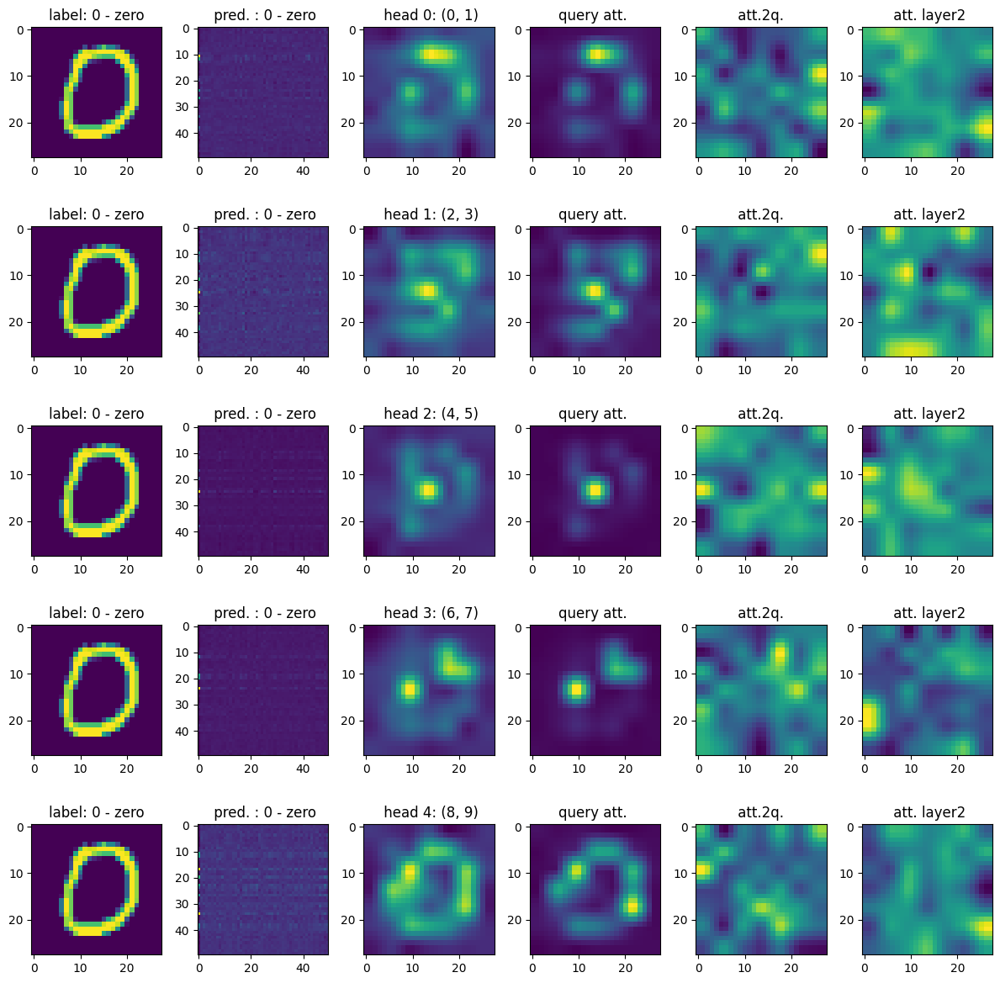

ic| t: 10


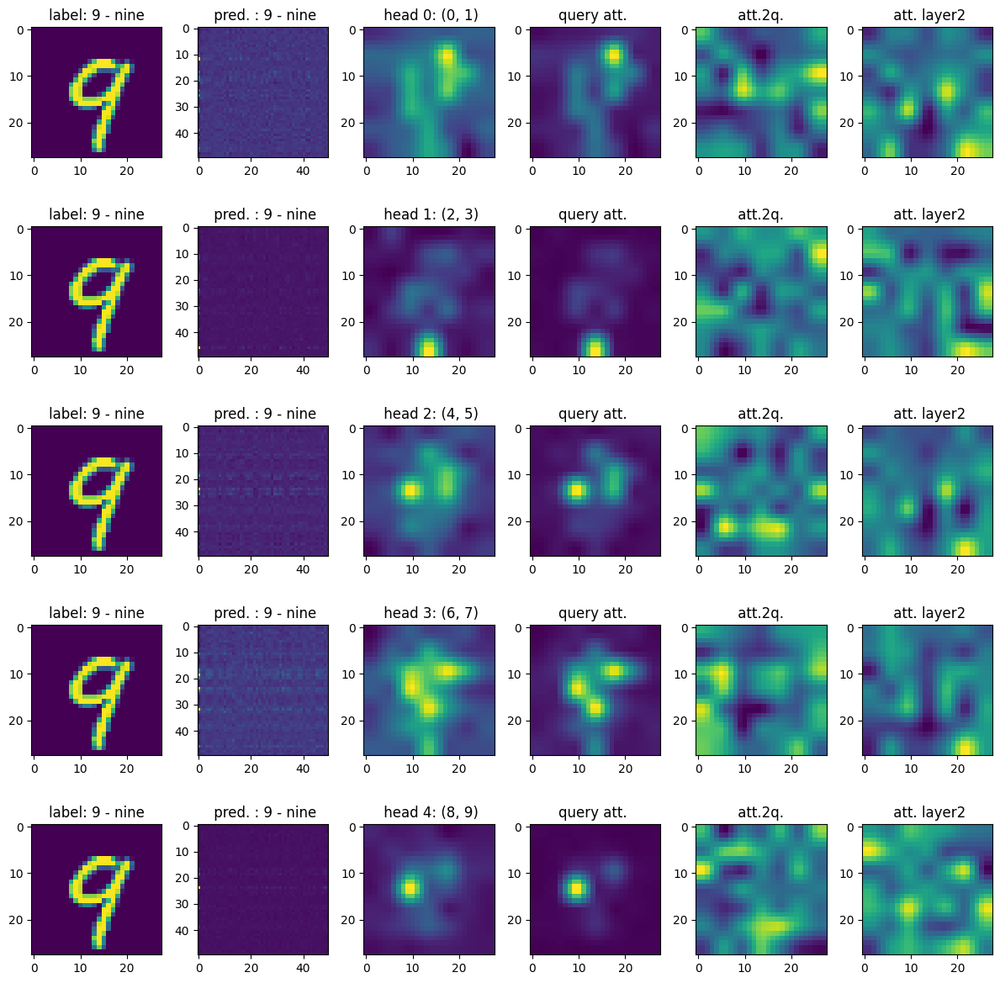

ic| t: 12


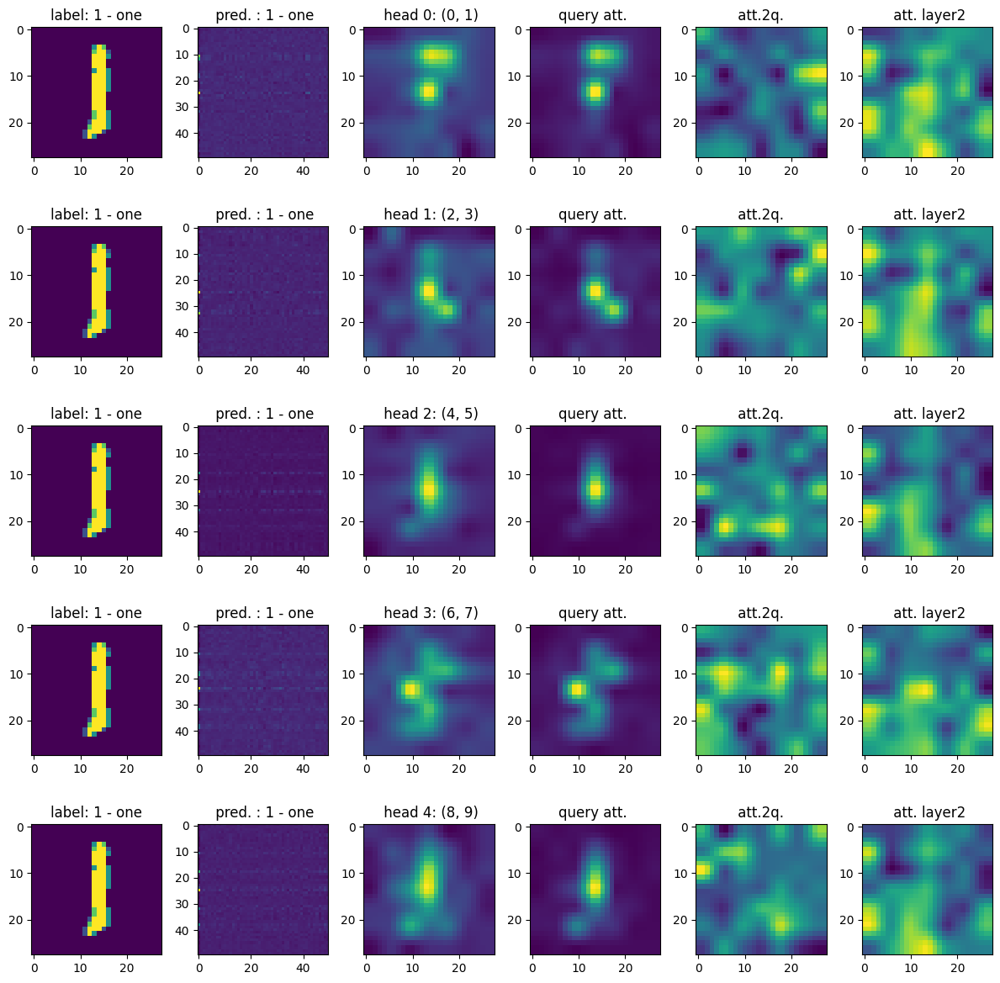

ic| t: 14


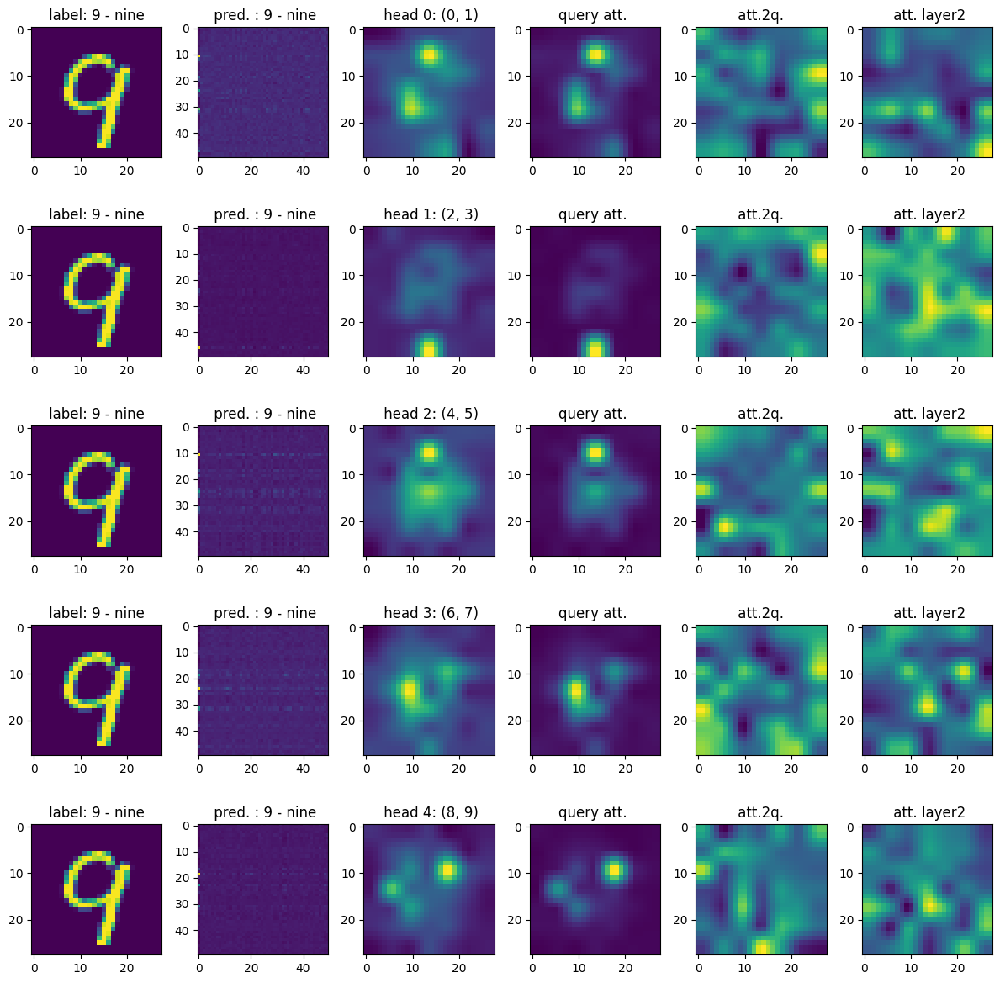

ic| t: 16


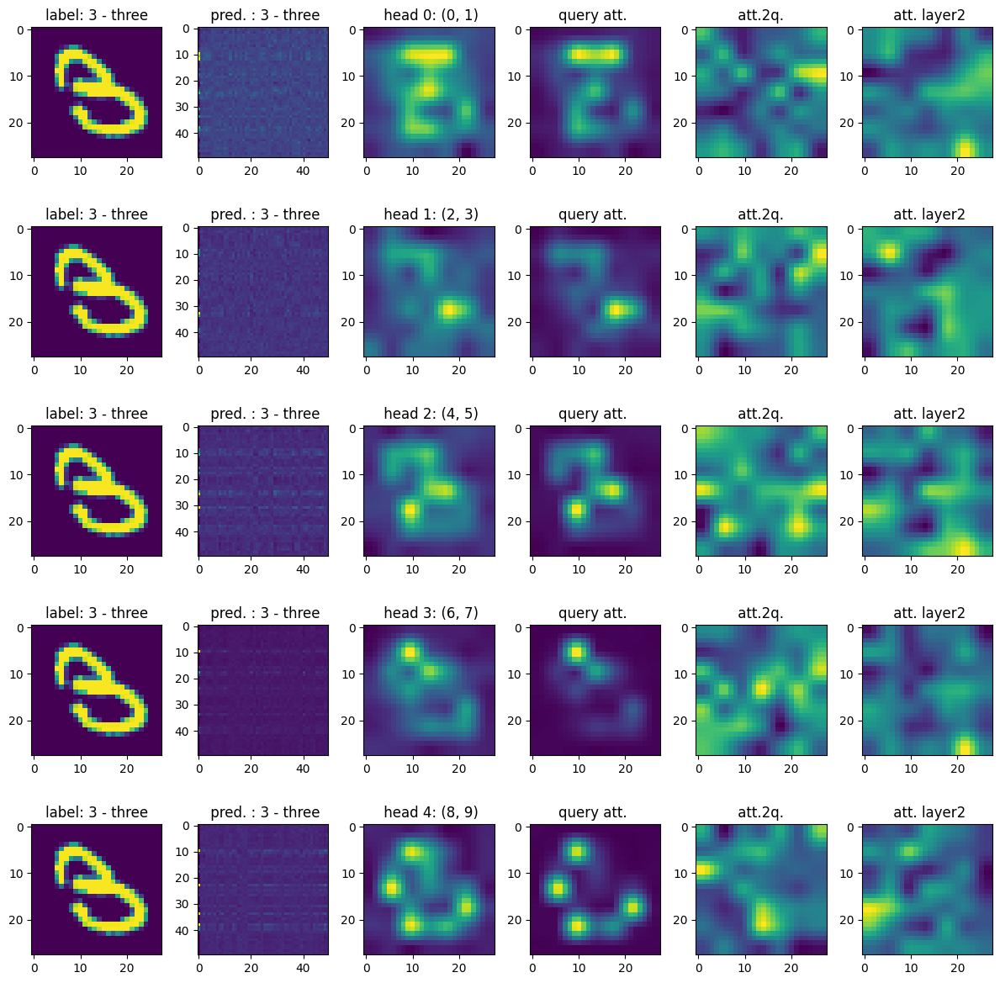

ic| t: 18


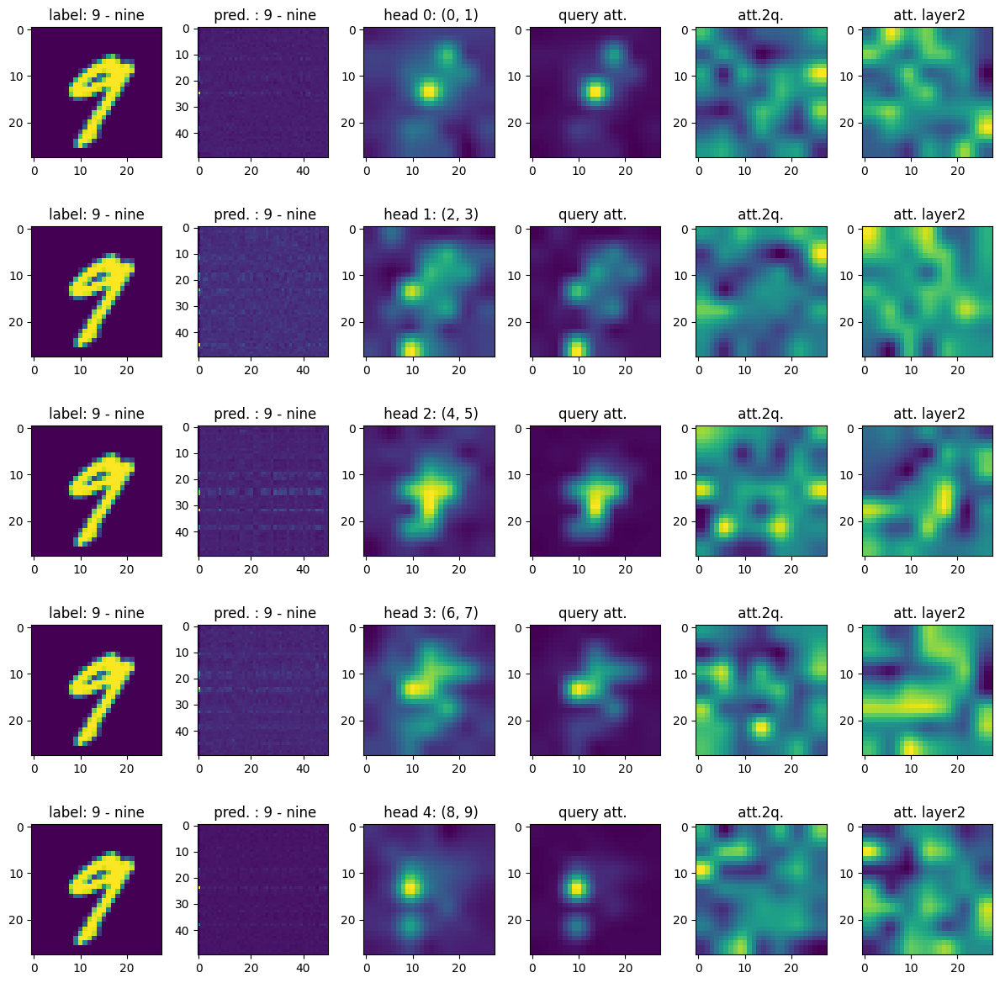

ic| t: 20


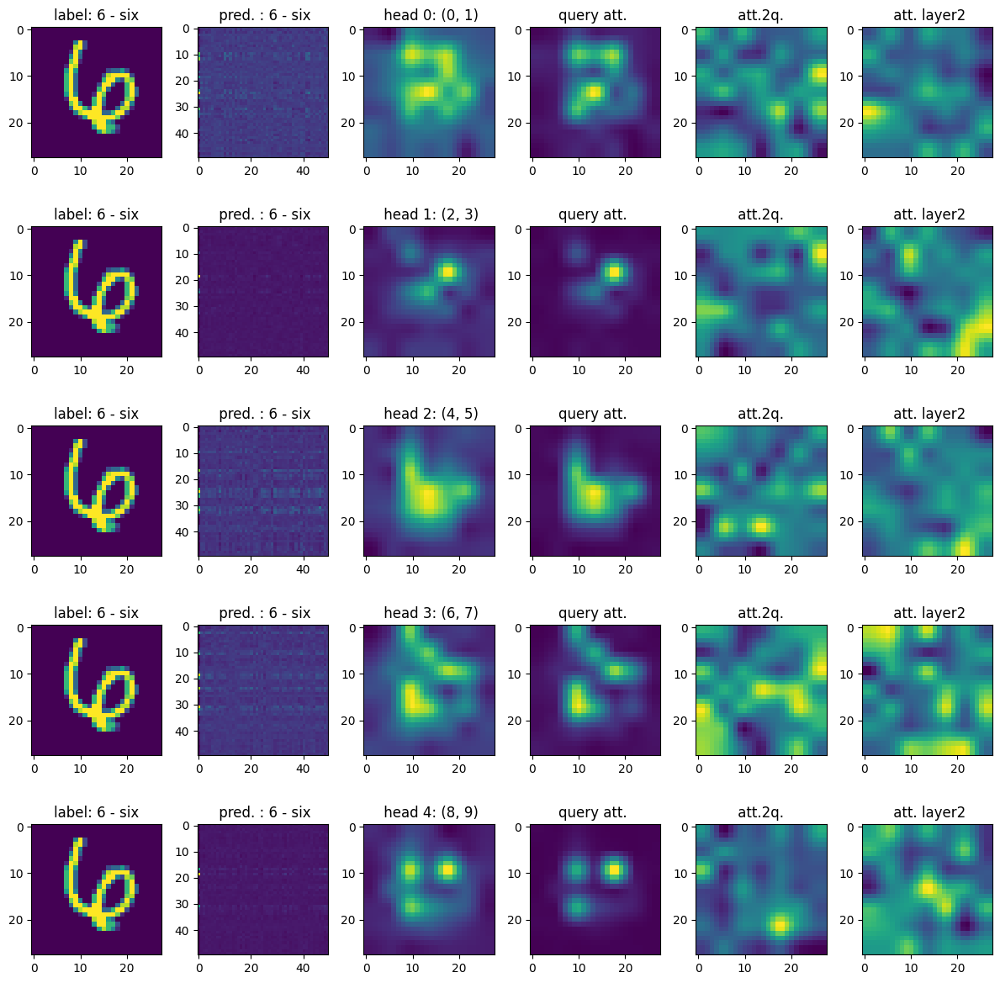

ic| t: 22


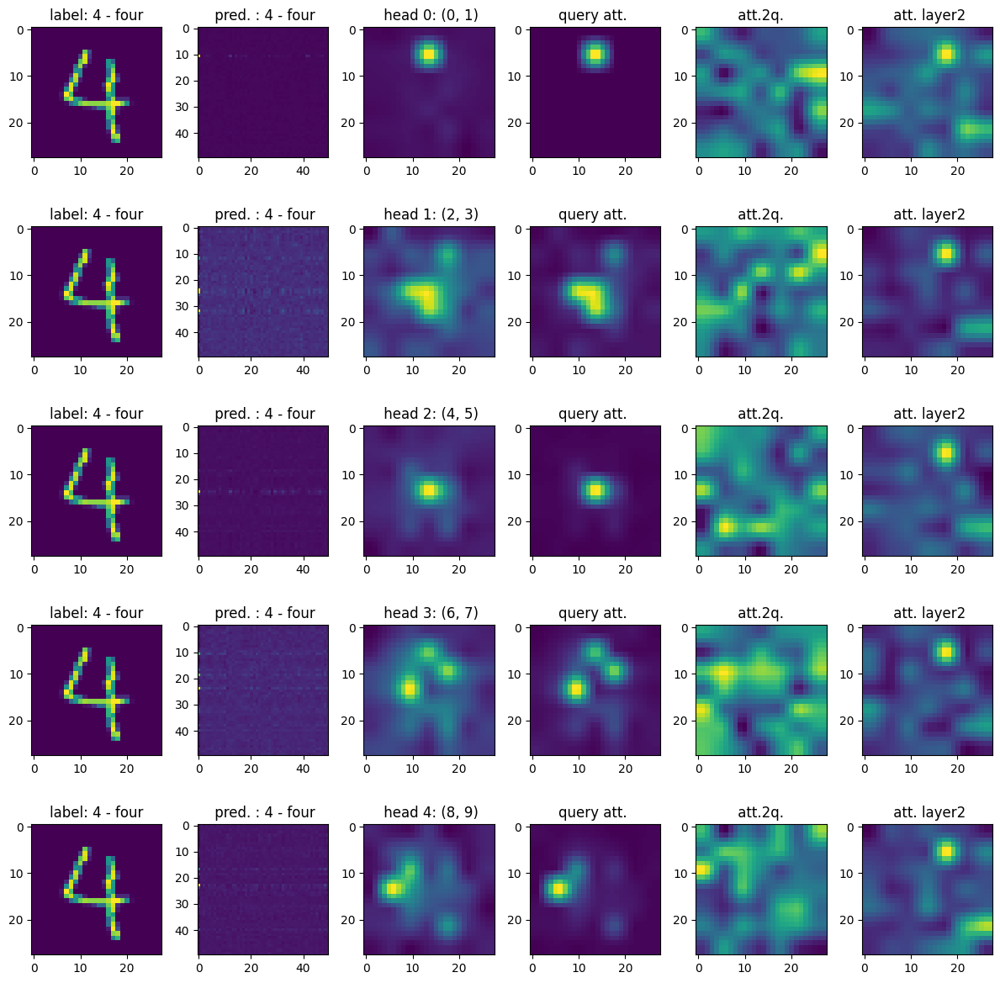

ic| t: 24


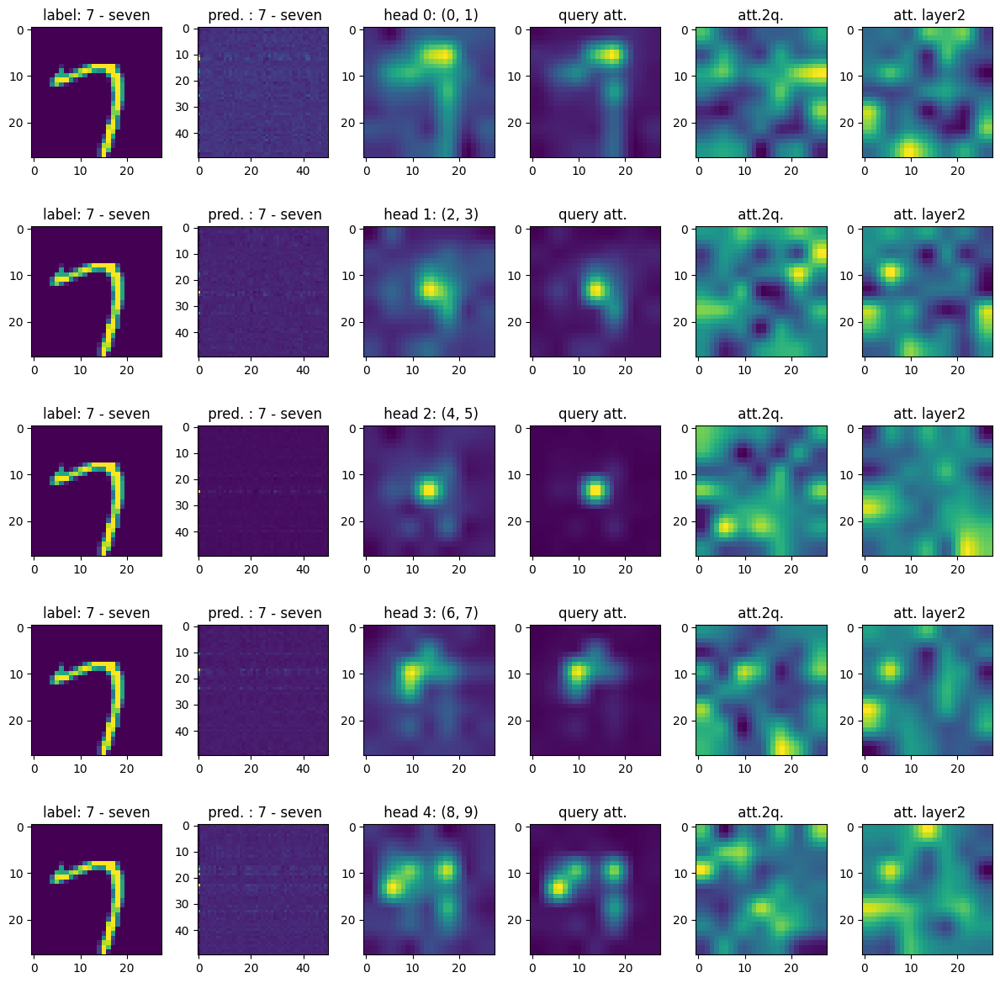

ic| t: 26


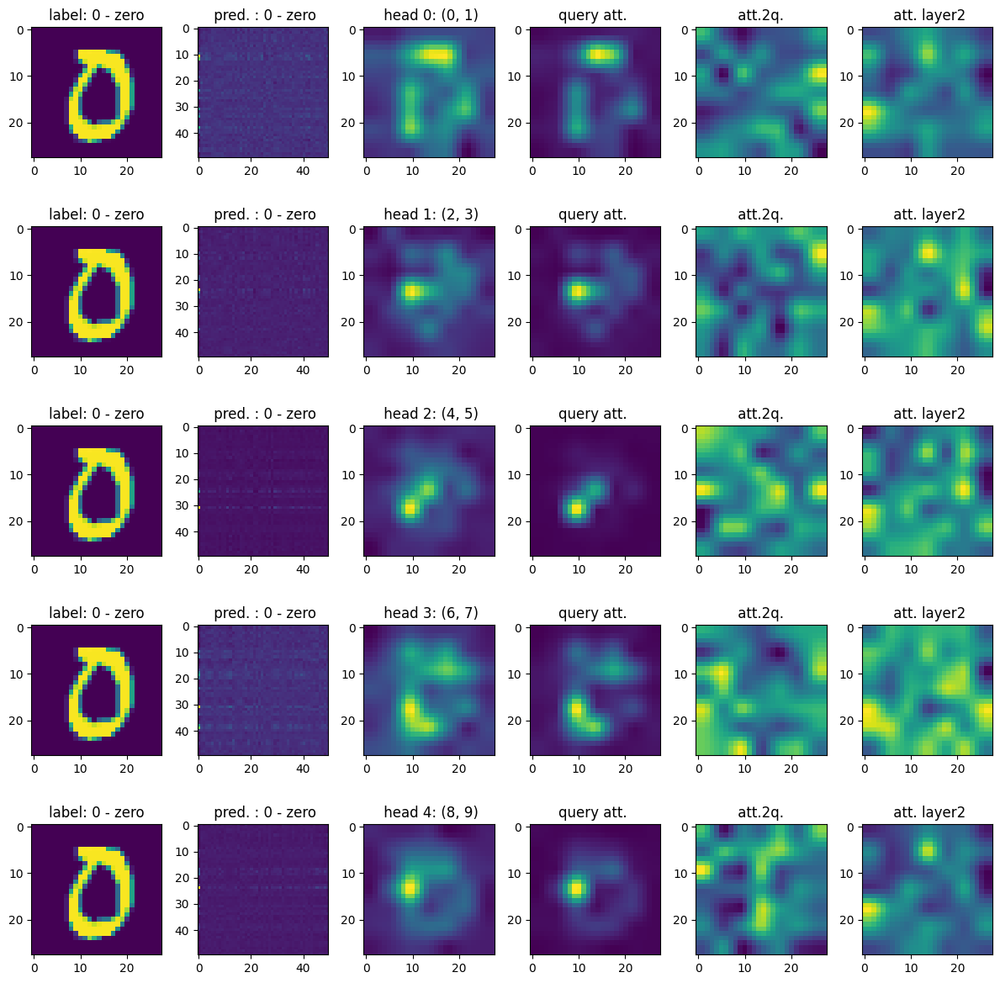

ic| t: 28


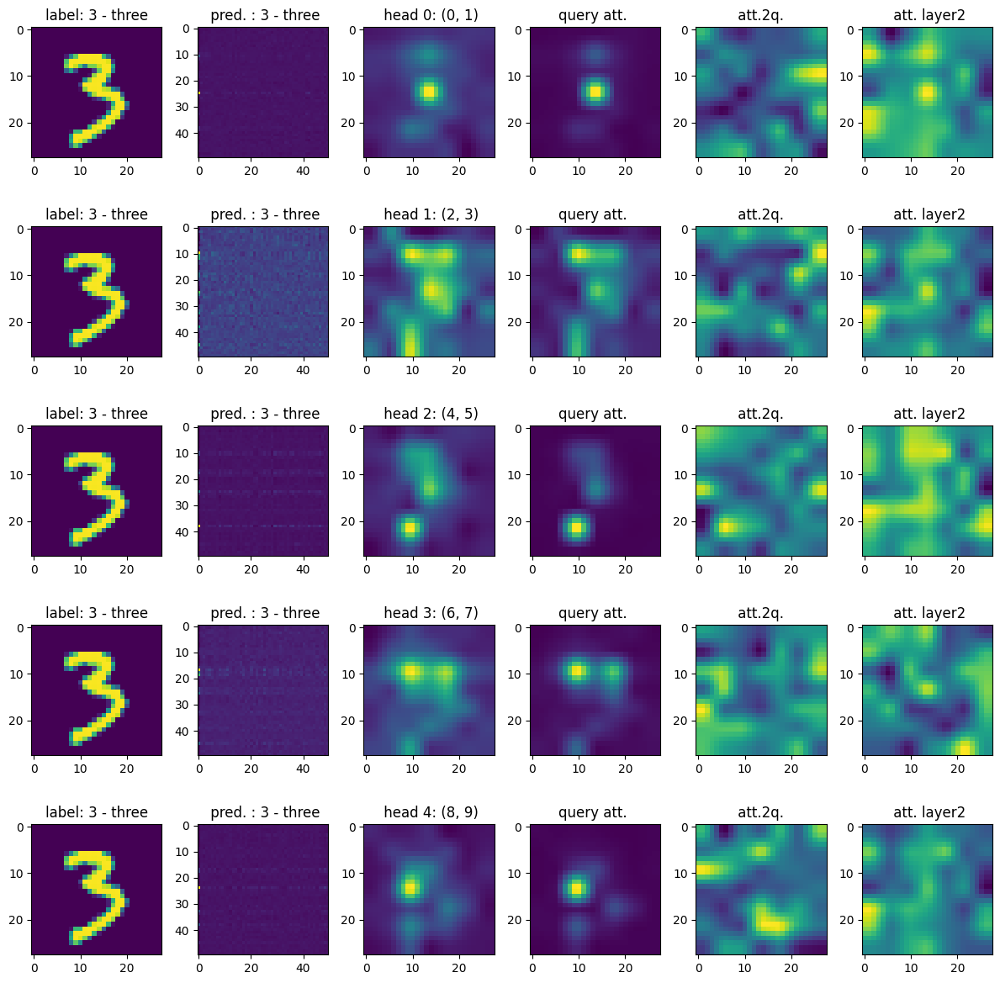

ic| t: 30


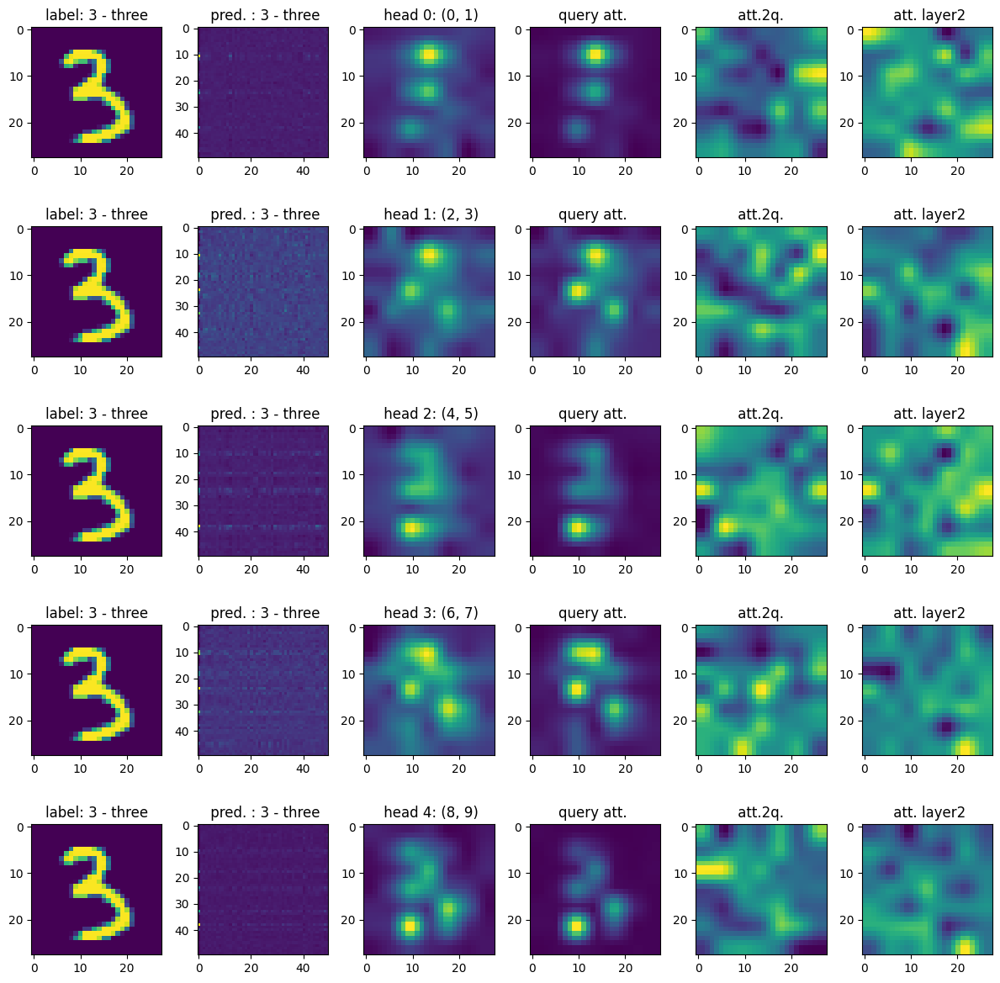

ic| t: 32


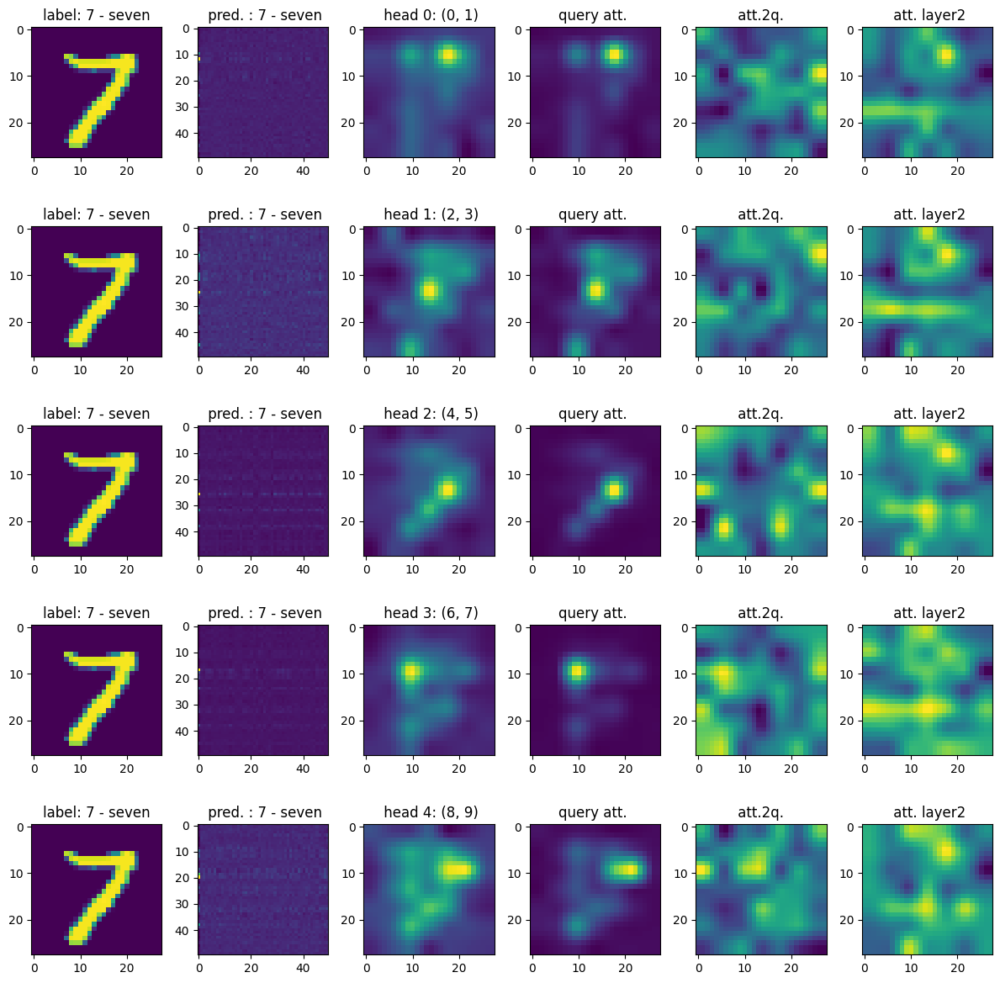

ic| t: 34


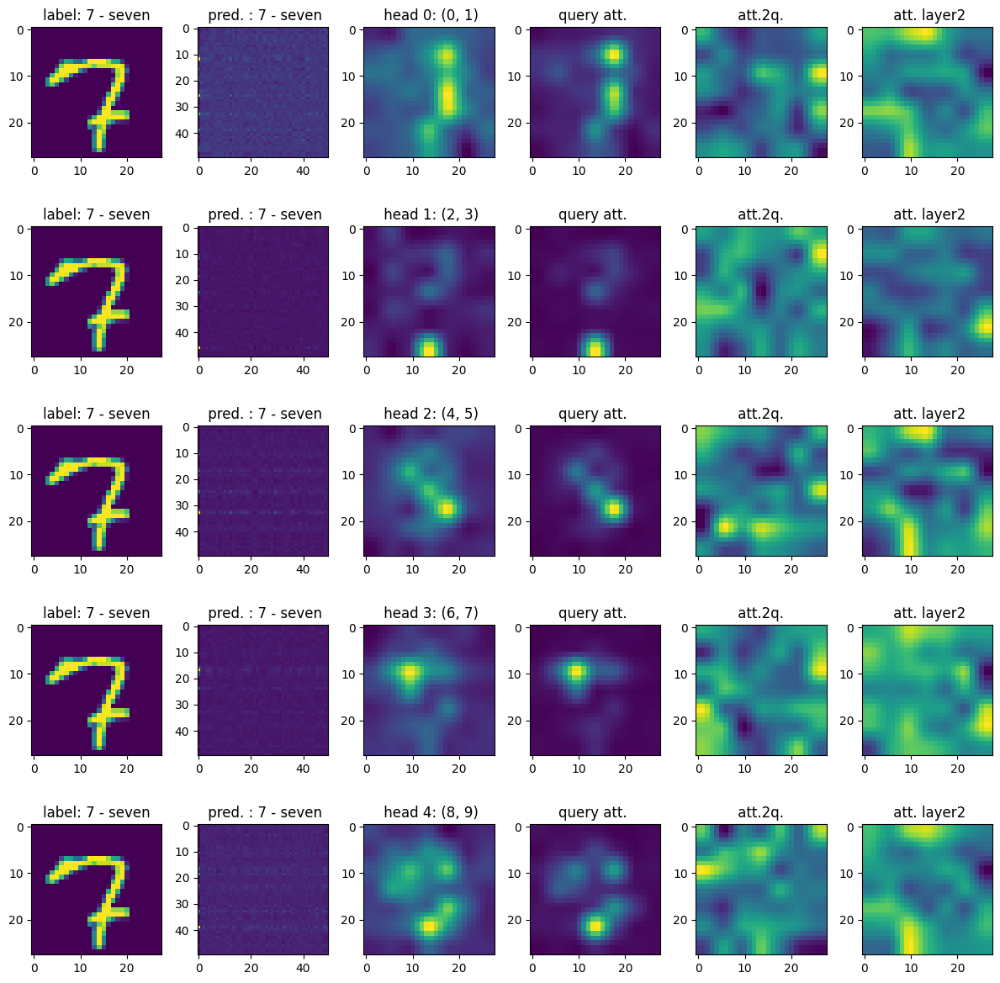

ic| t: 36


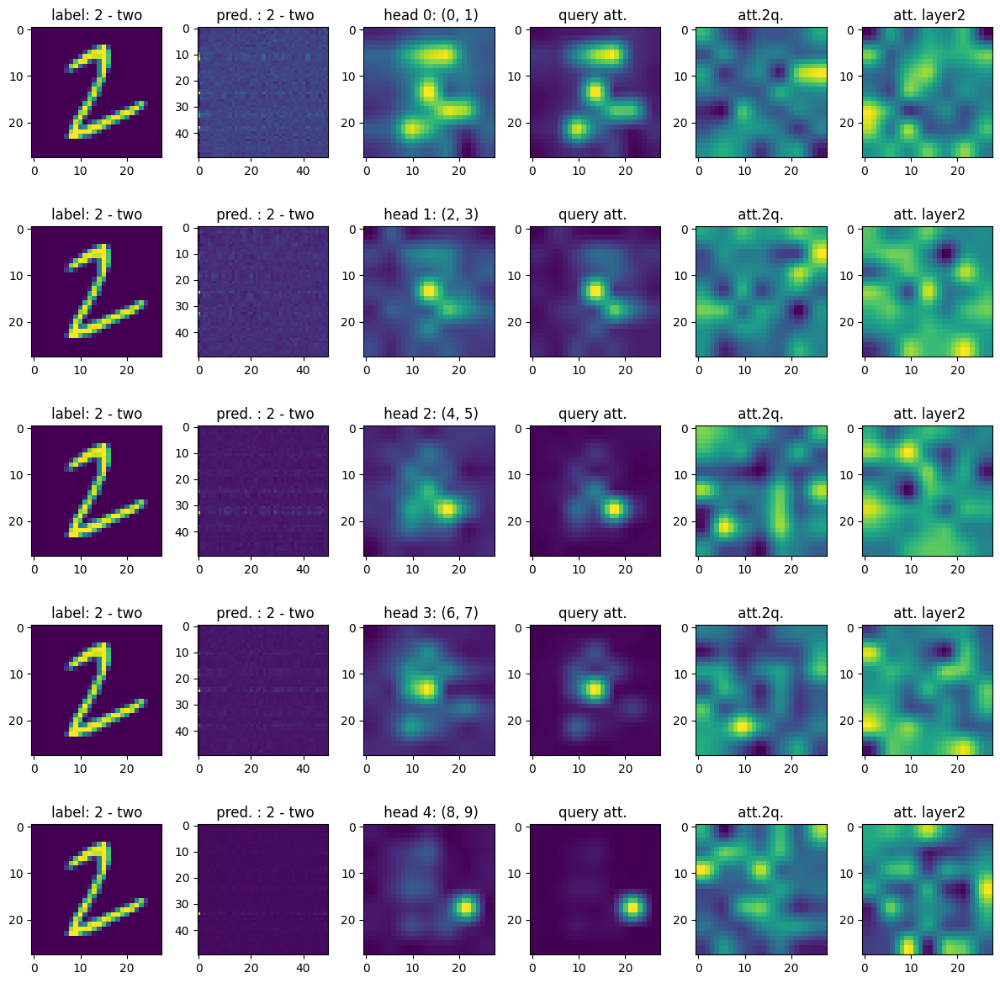

ic| t: 38


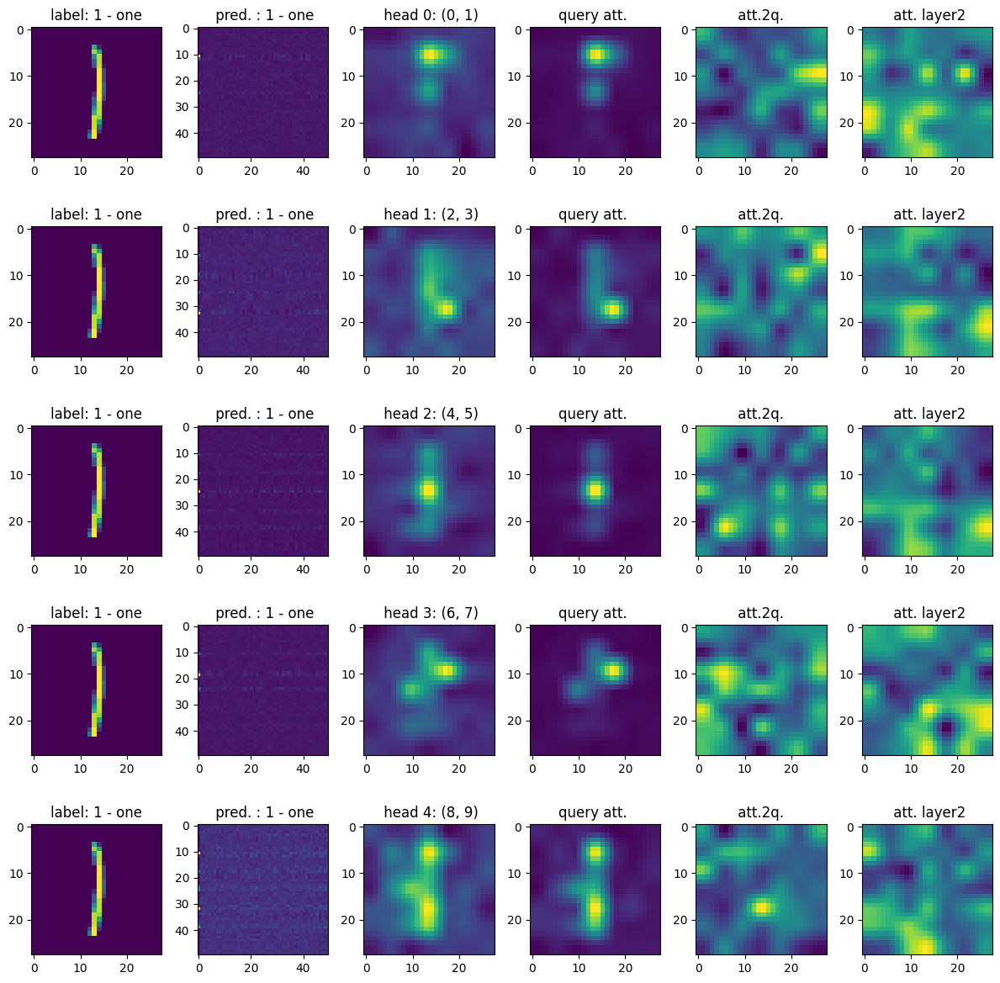

ic| t: 40


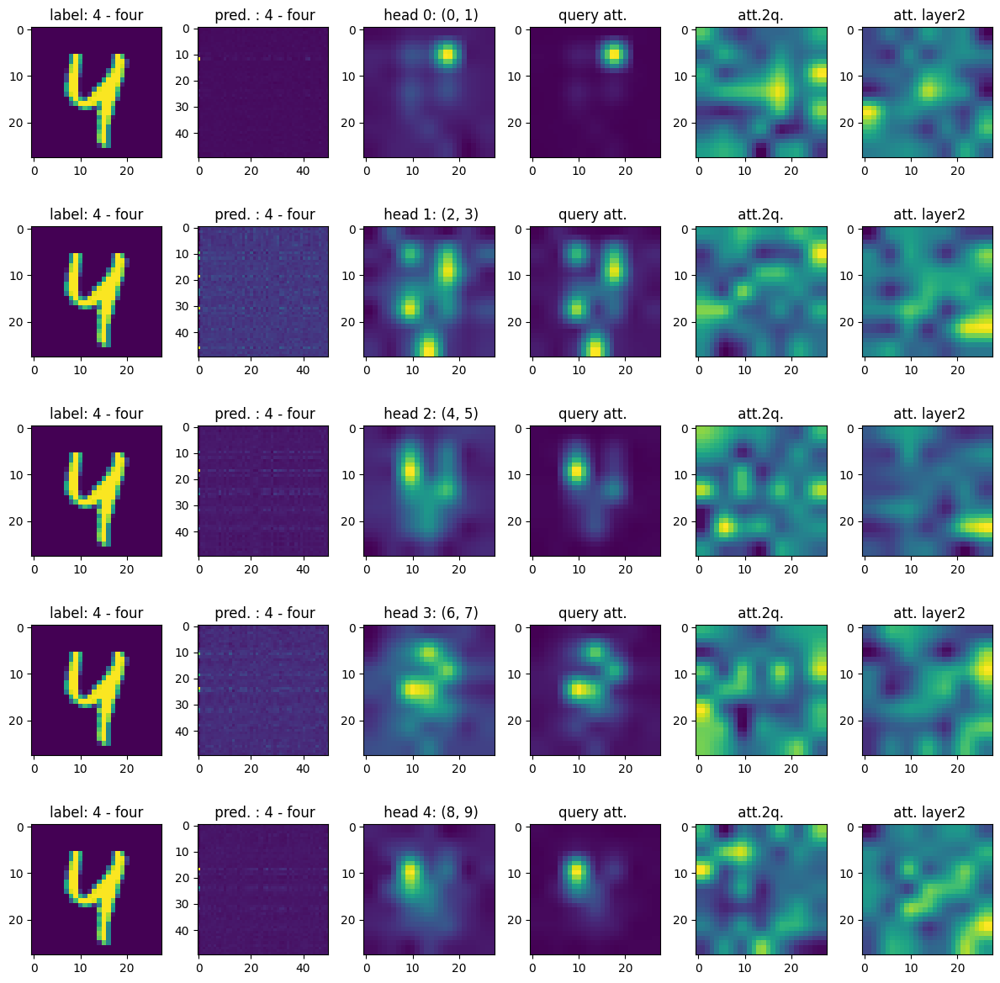

ic| t: 42


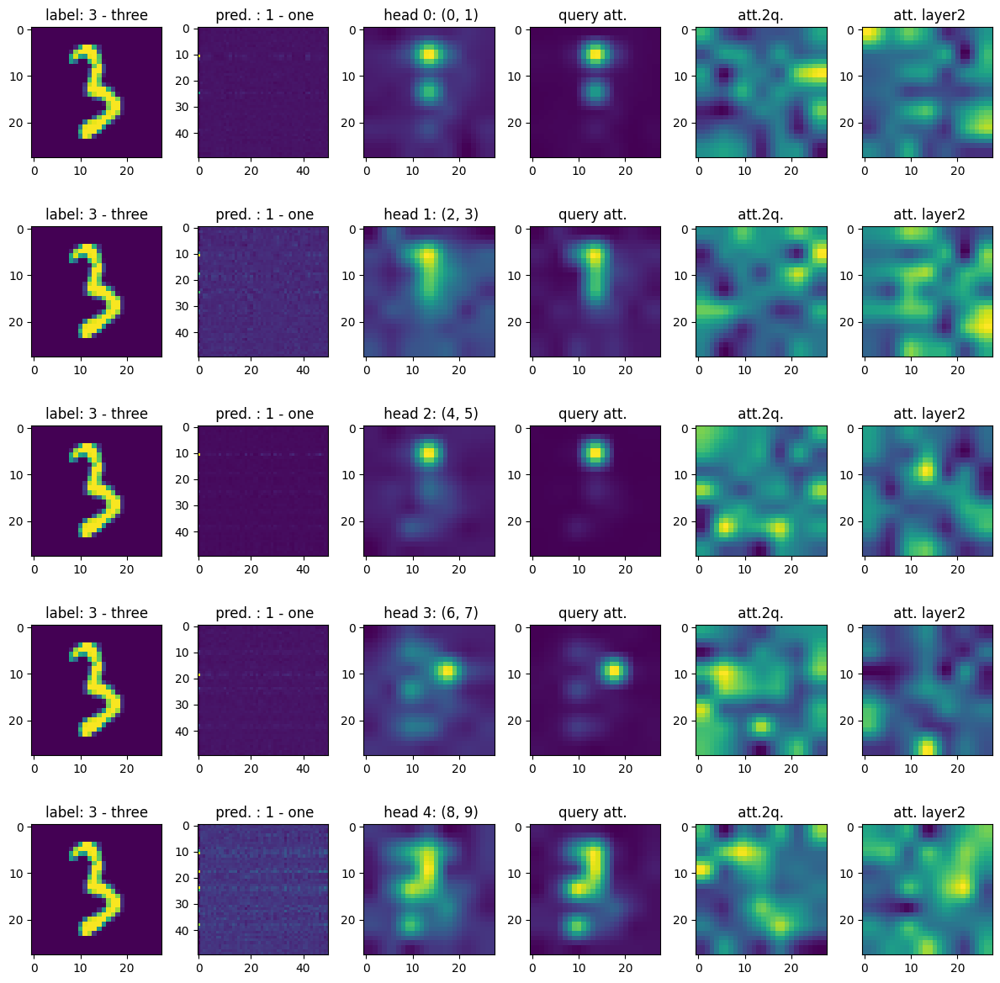

ic| t: 44


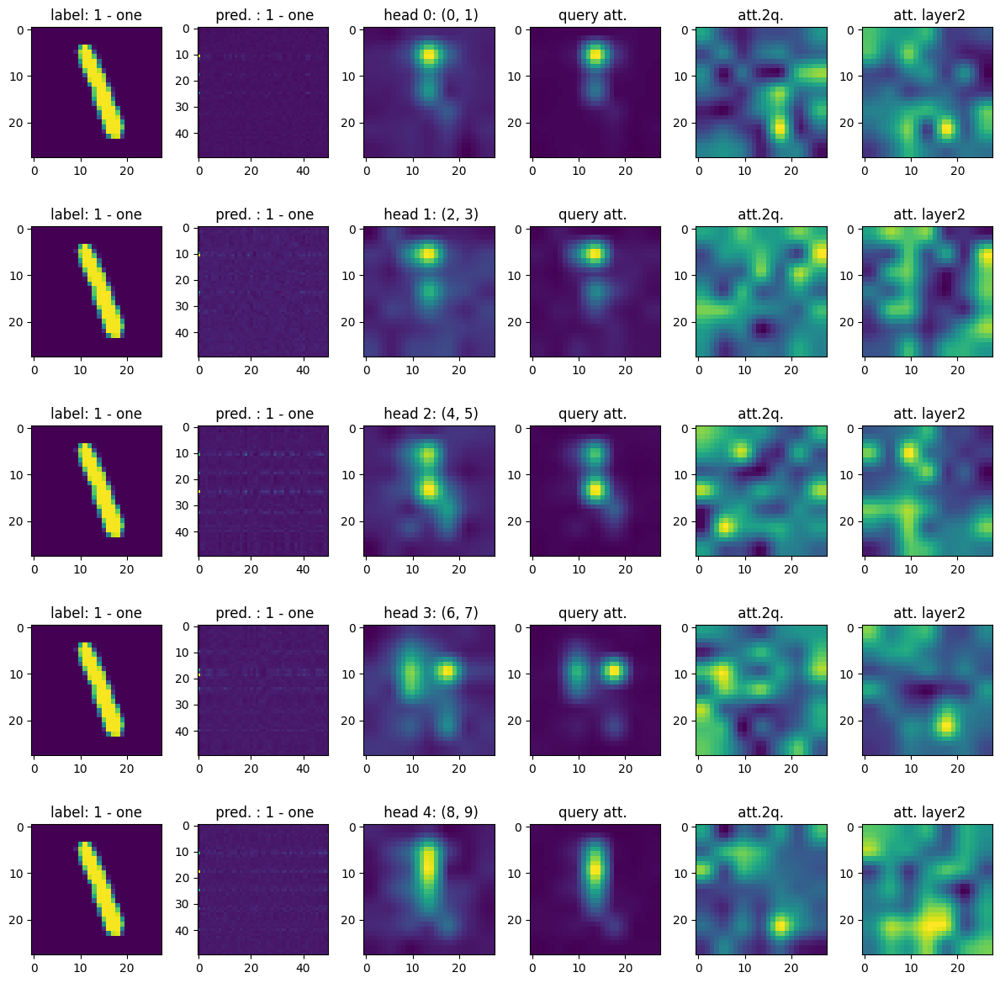

ic| t: 46


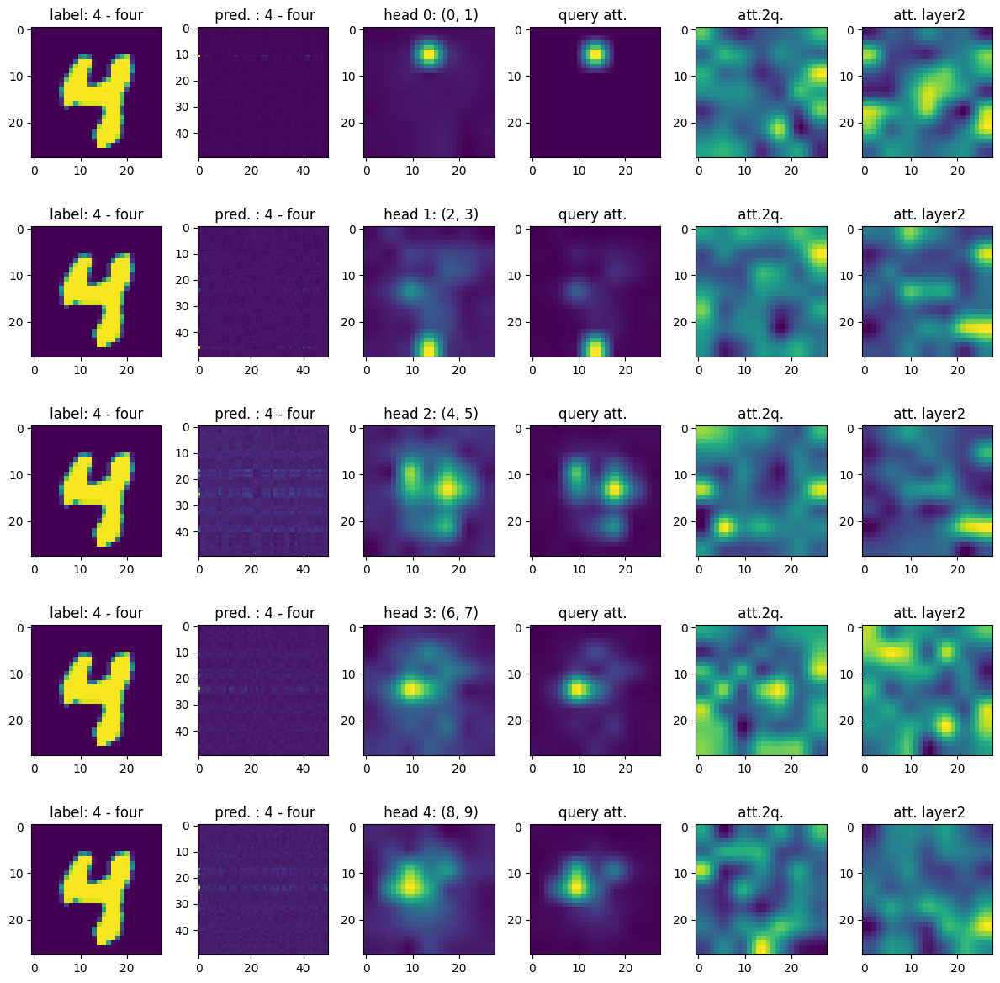

ic| t: 48


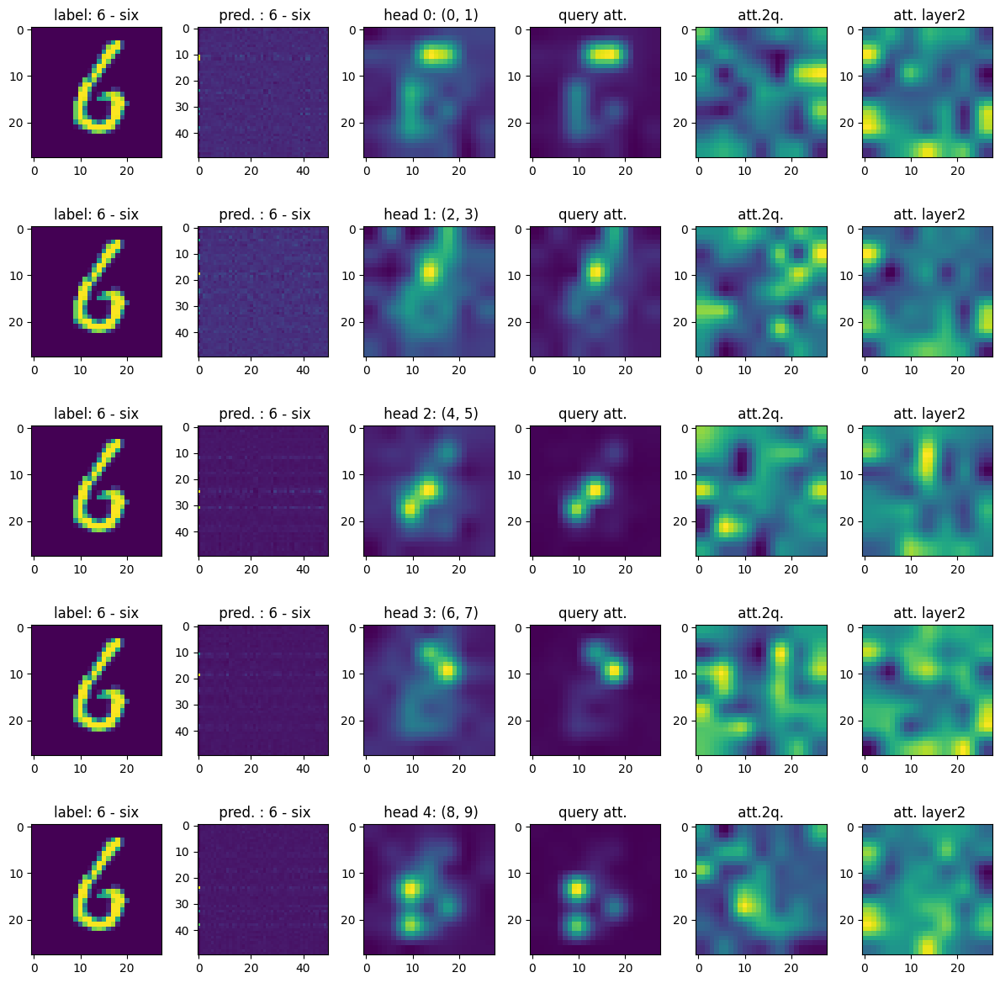

ic| t: 50


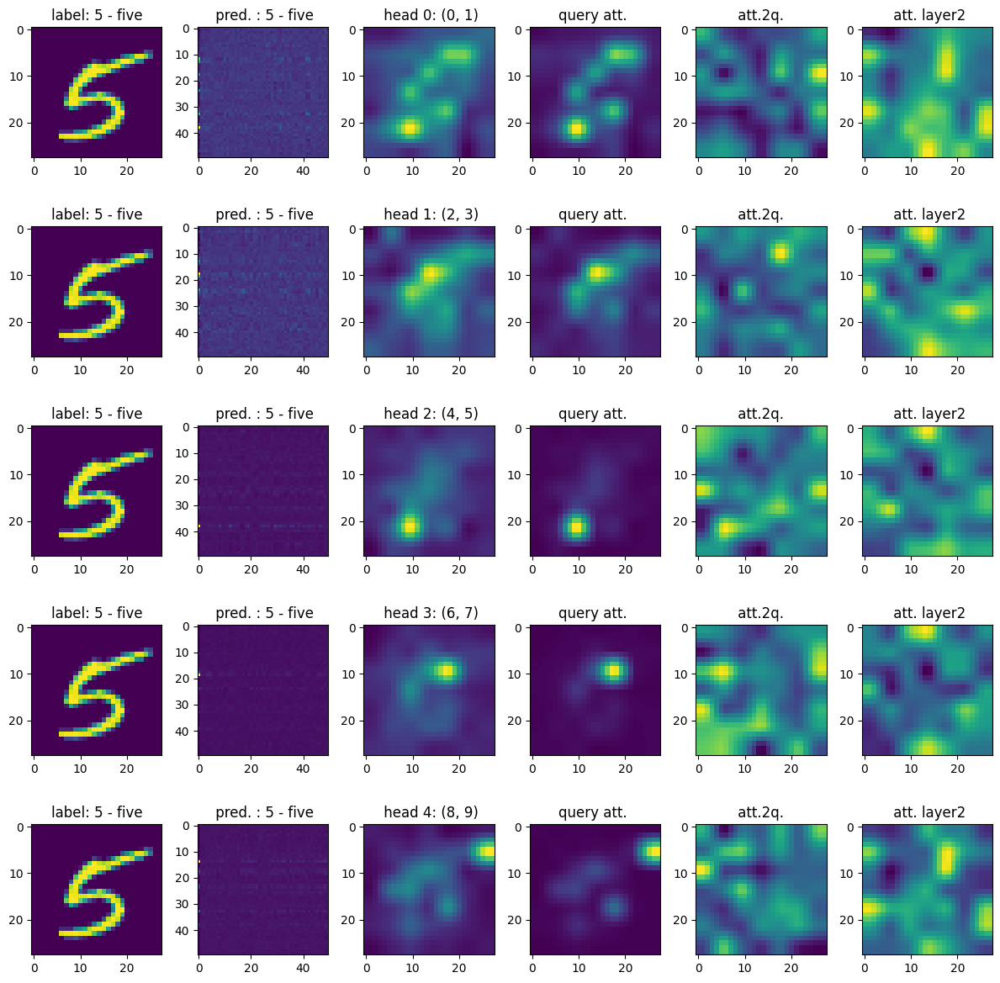

ic| t: 52


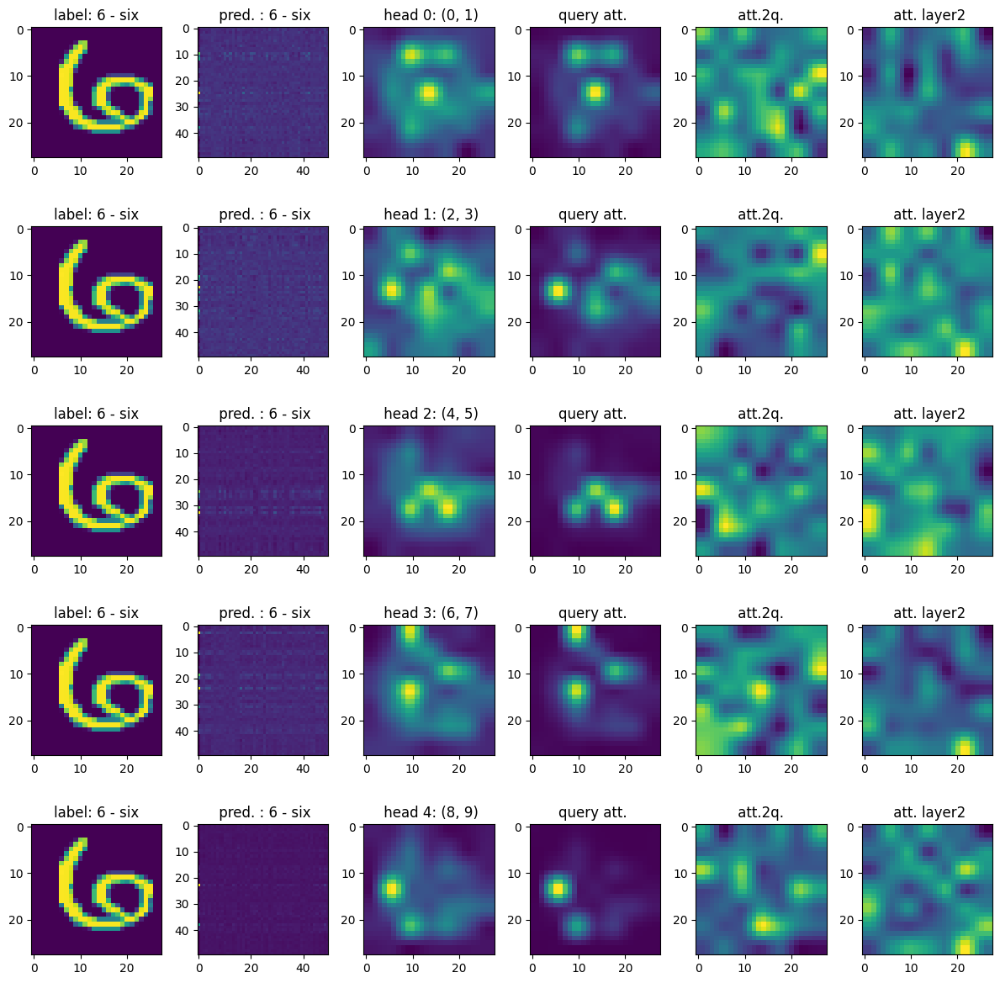

ic| t: 54


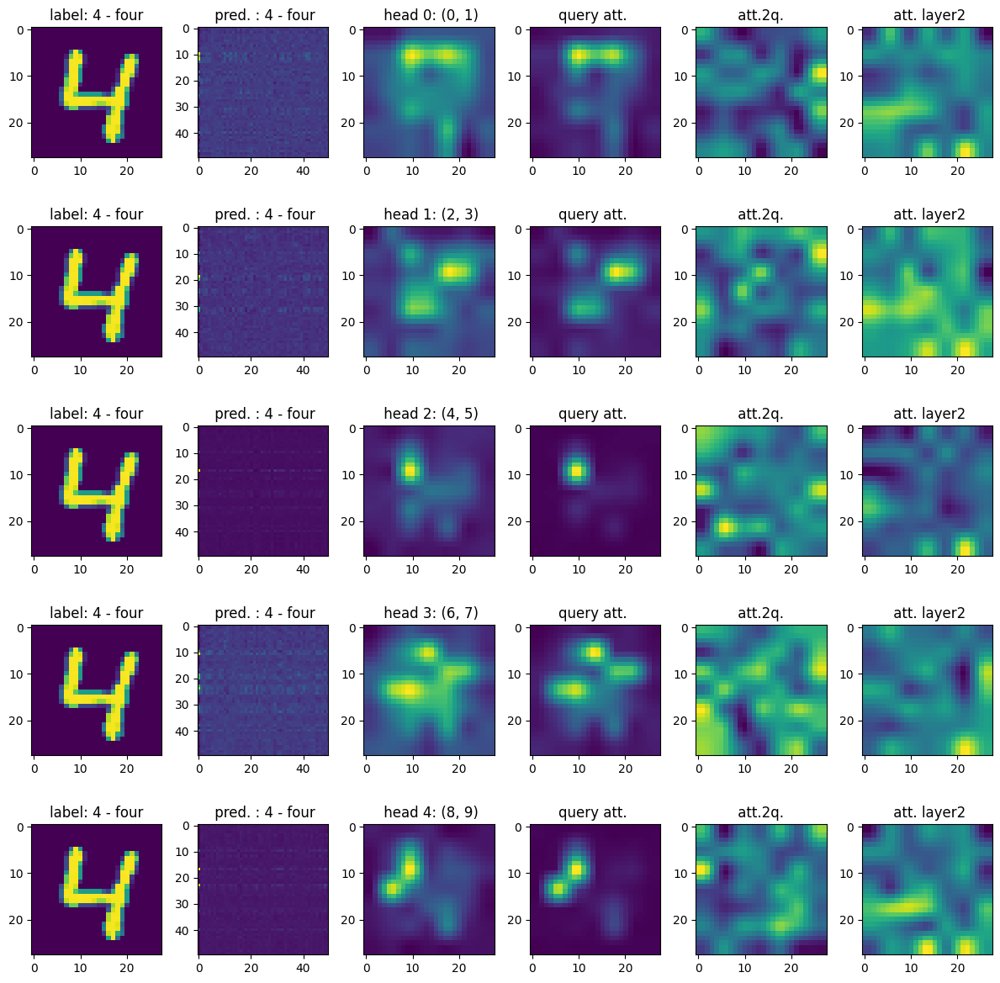

ic| t: 56


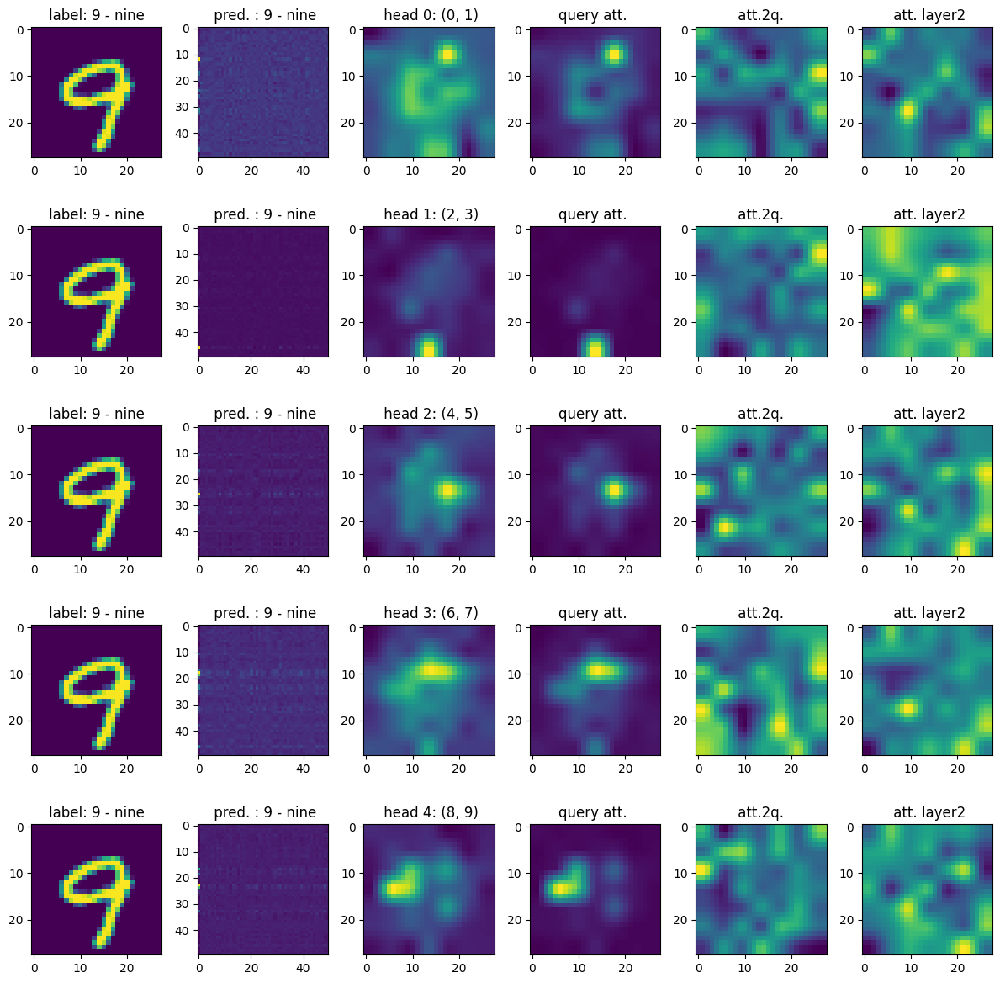

ic| t: 58


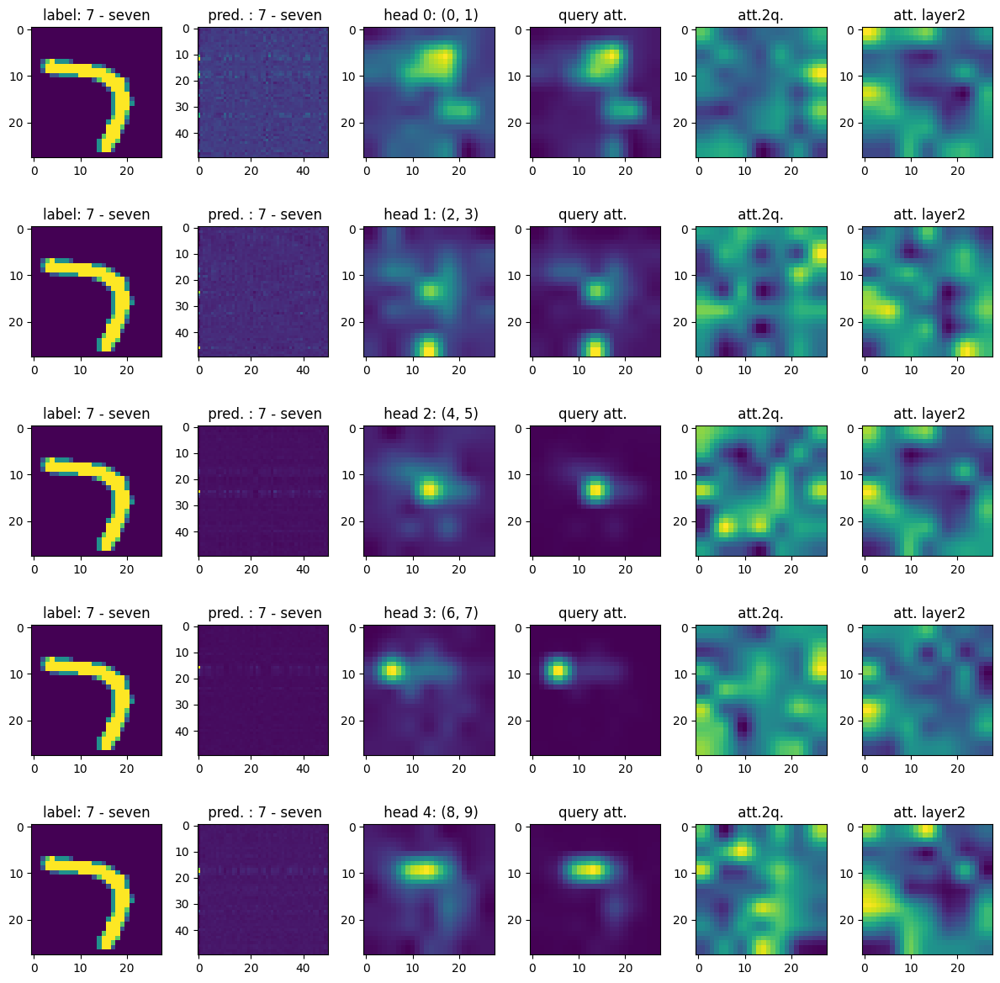

ic| t: 60


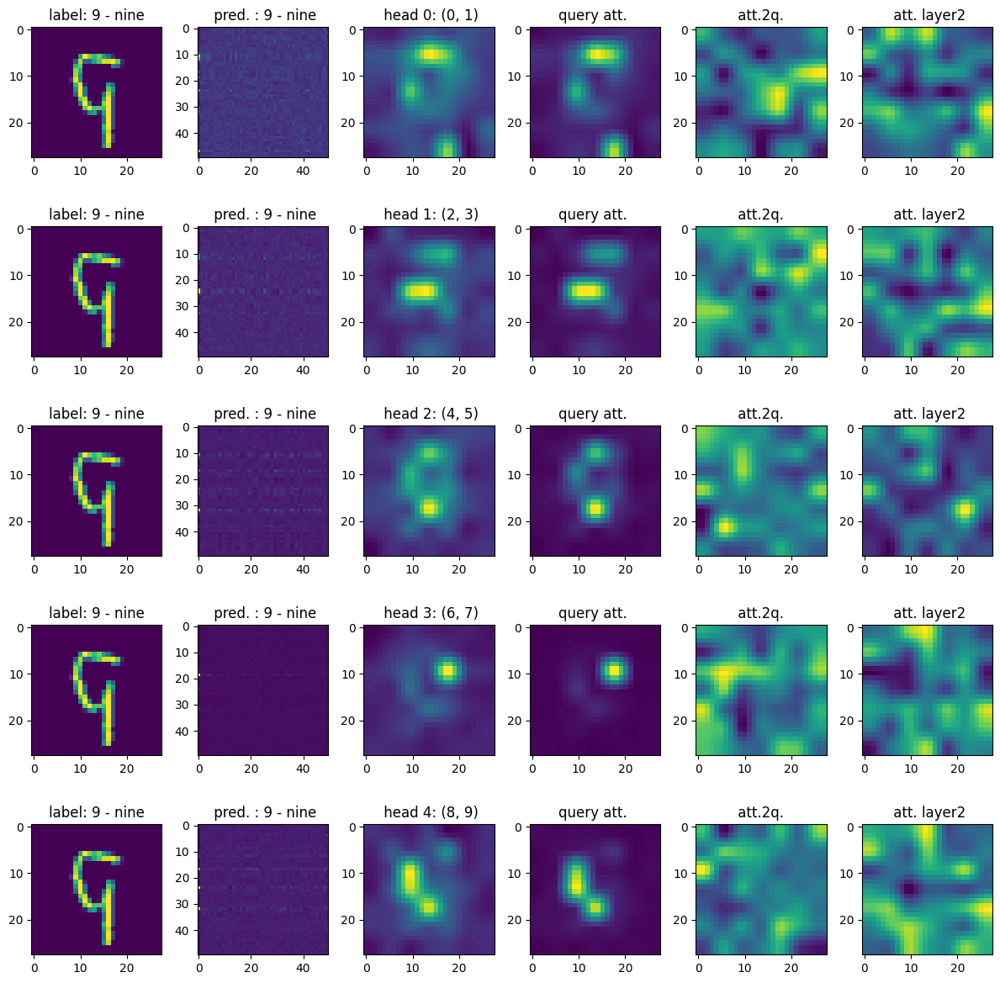

ic| t: 62


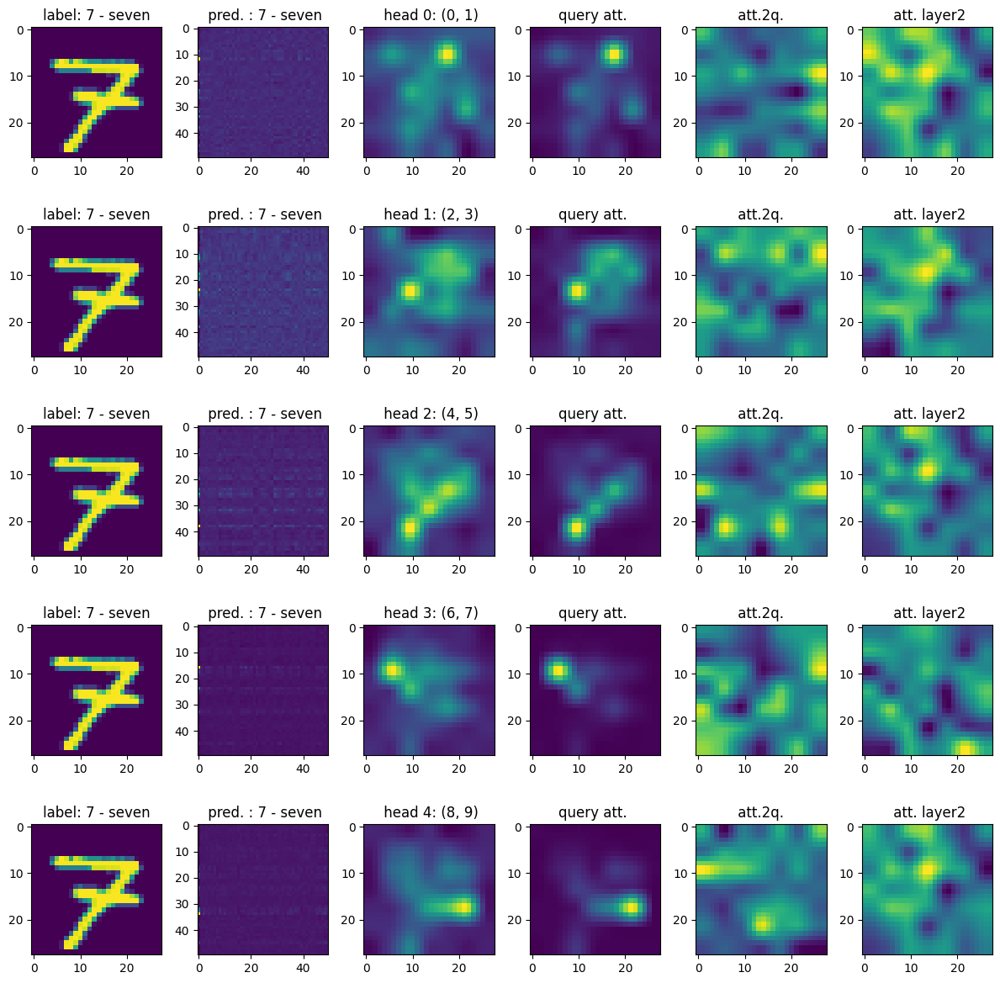

ic| t: 64


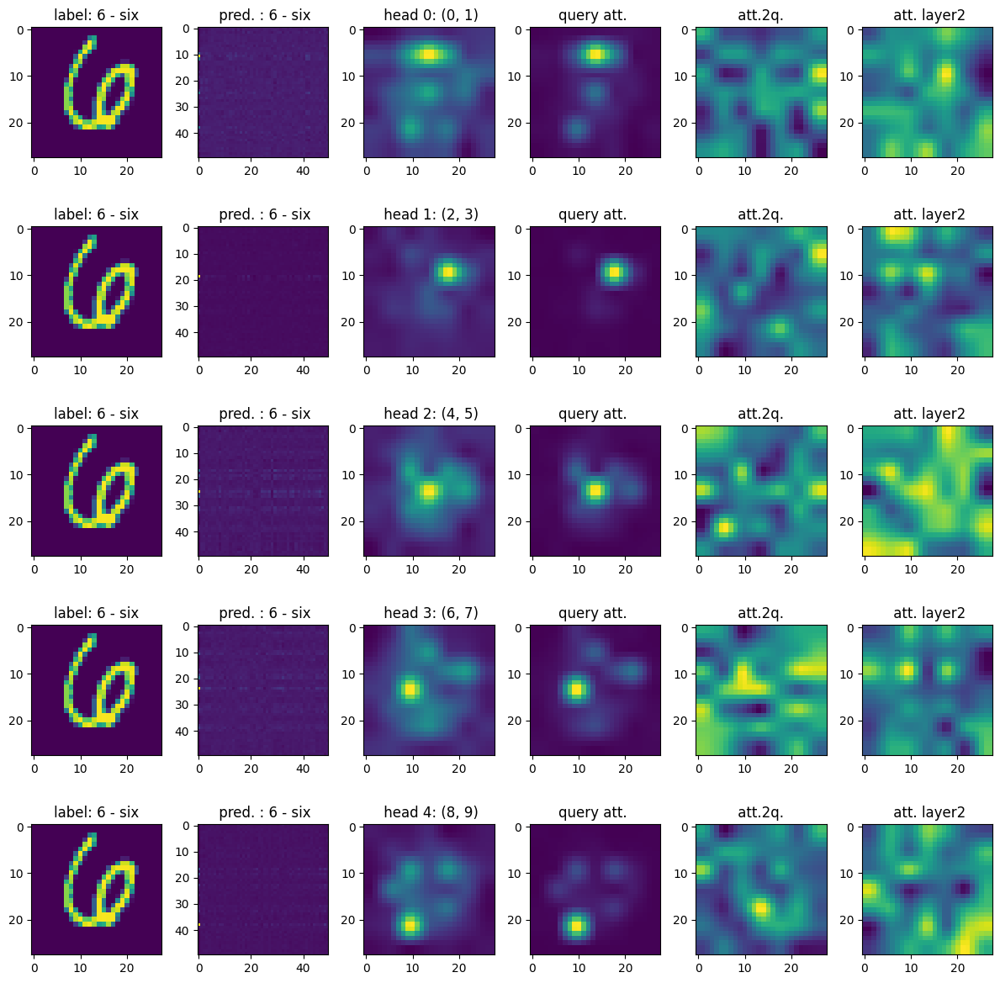

ic| t: 66


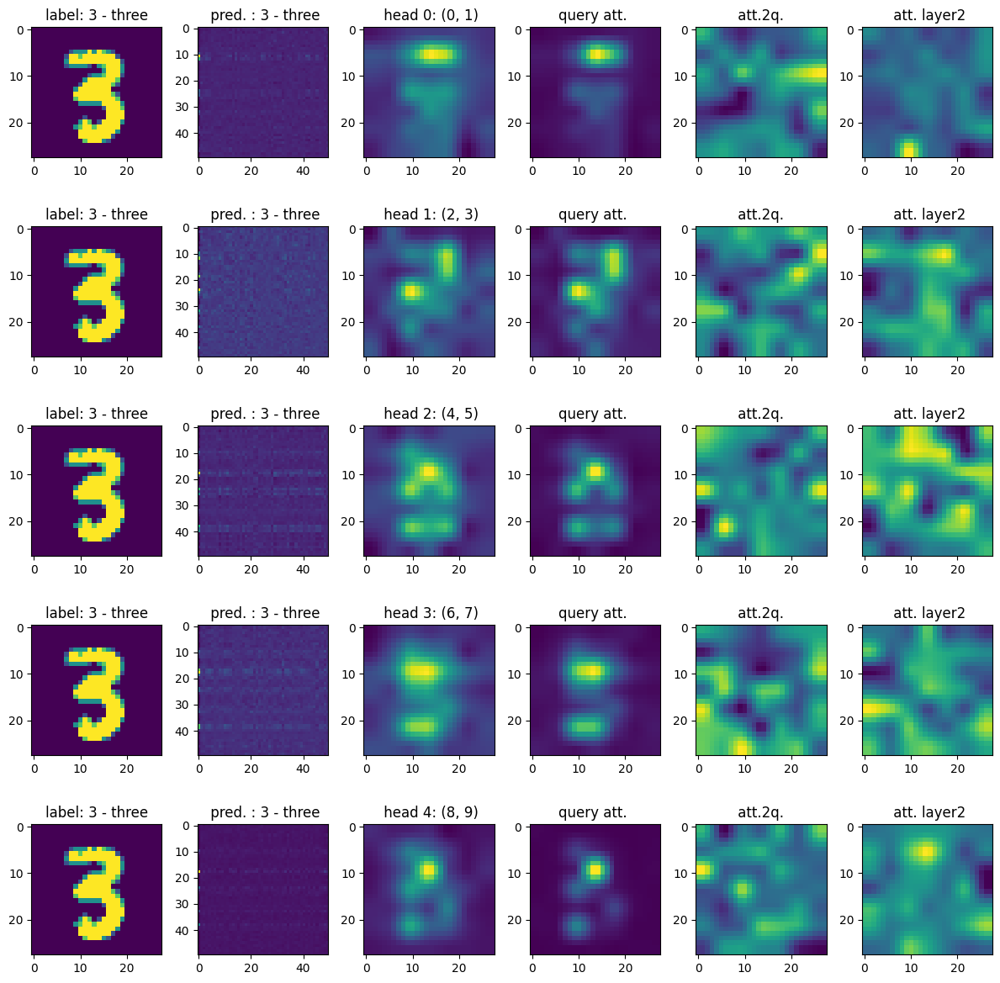

ic| t: 68


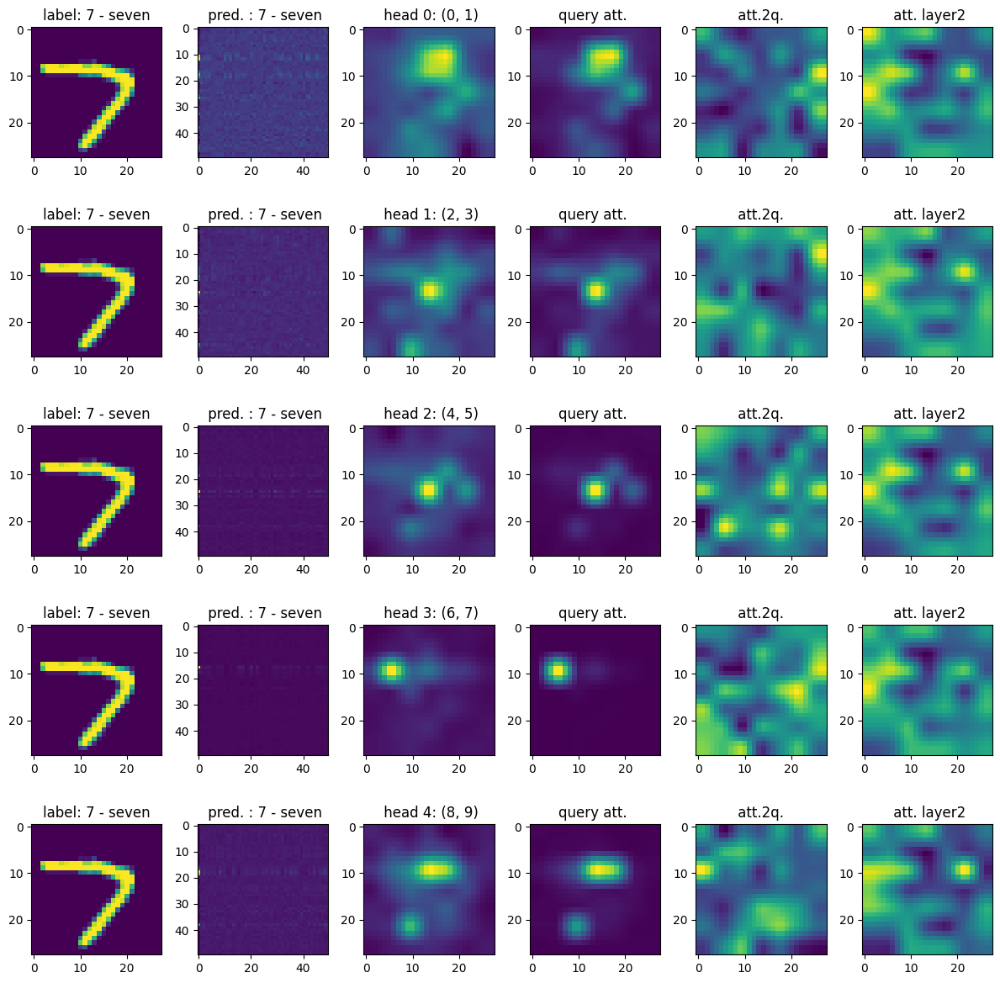

ic| t: 70


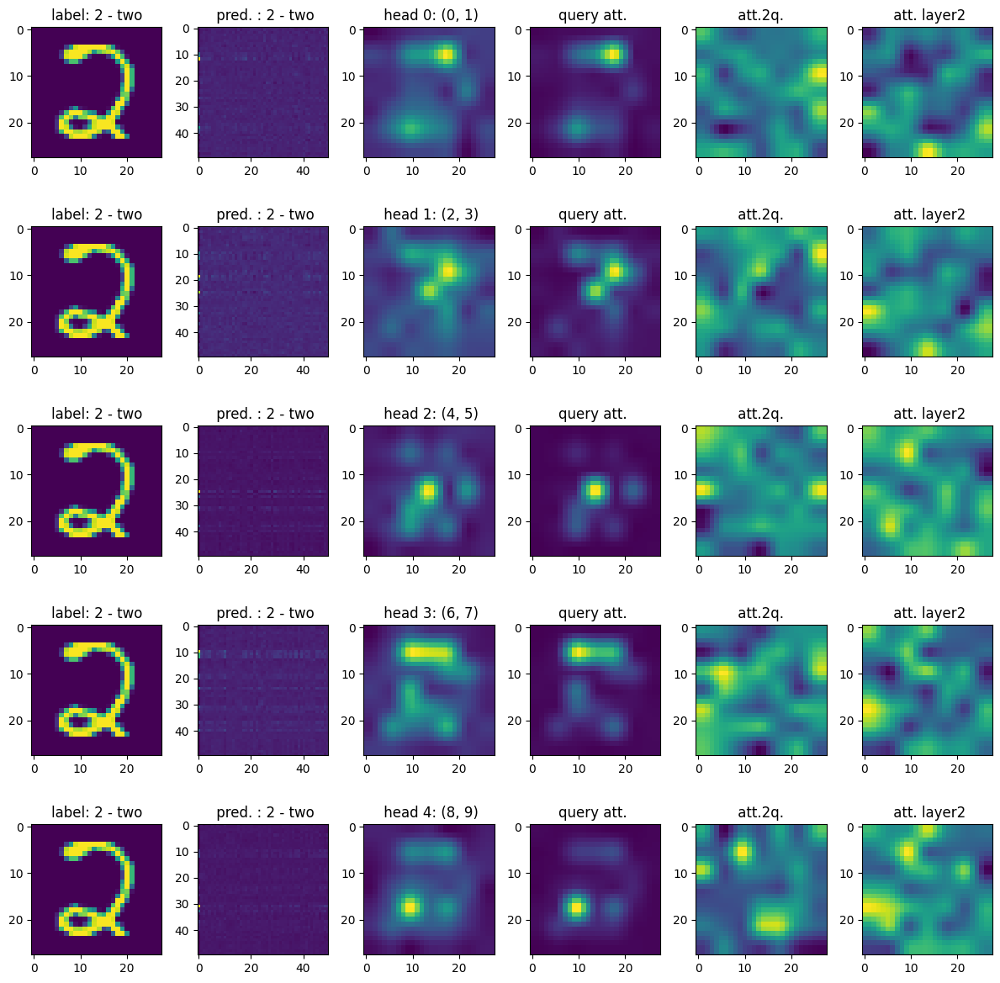

ic| t: 72


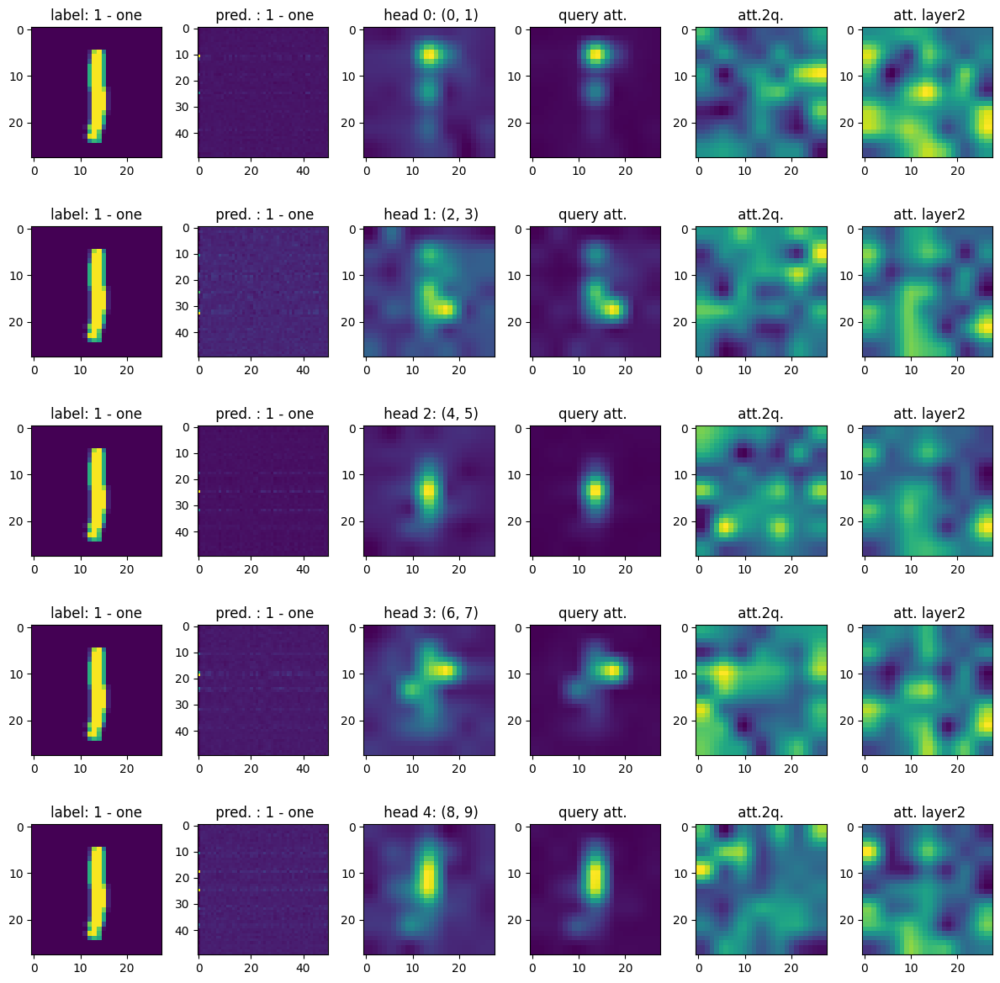

ic| t: 74


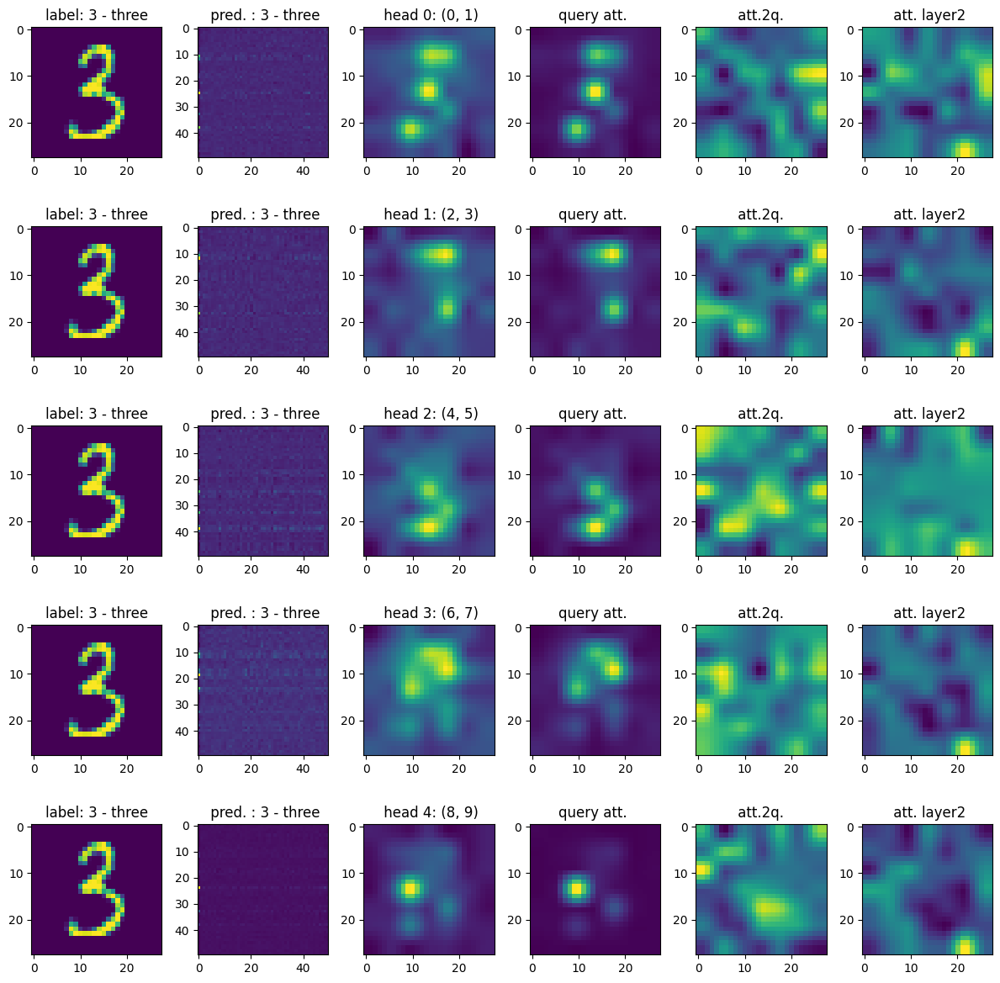

ic| t: 76


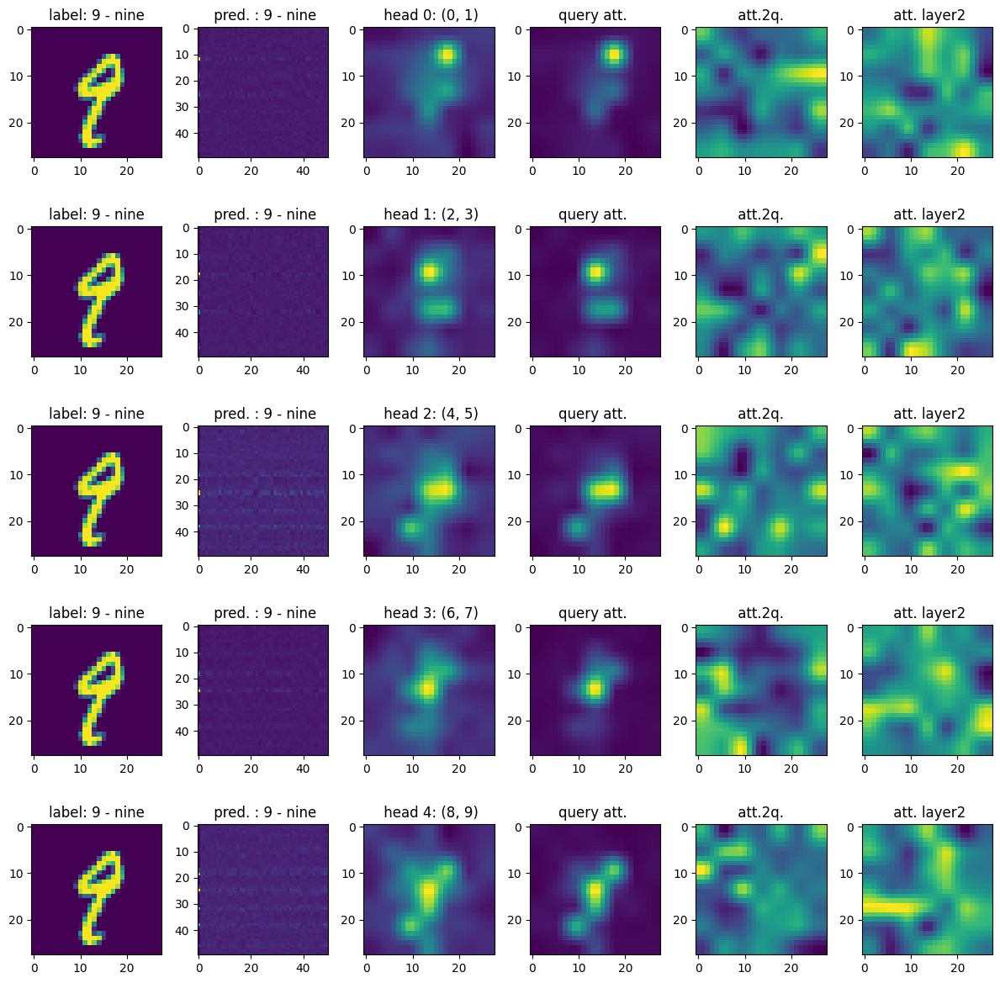

ic| t: 78


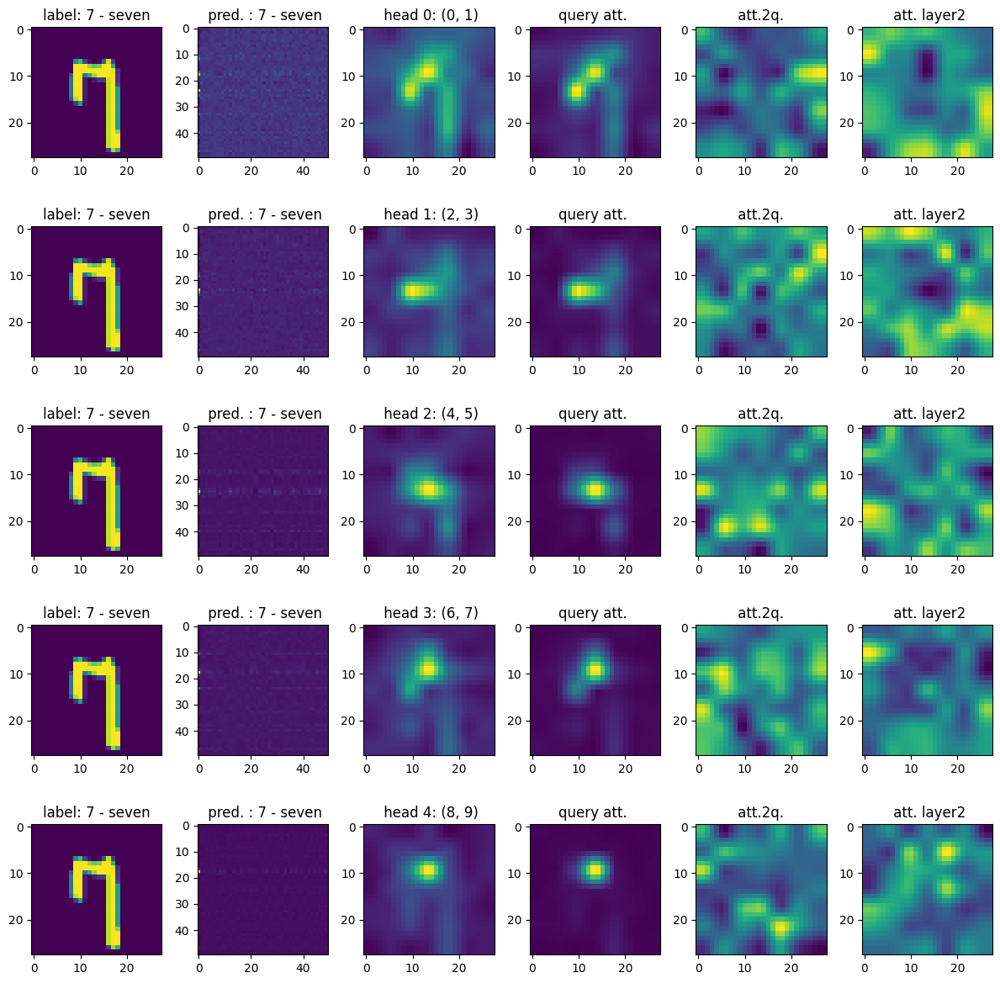

ic| t: 80


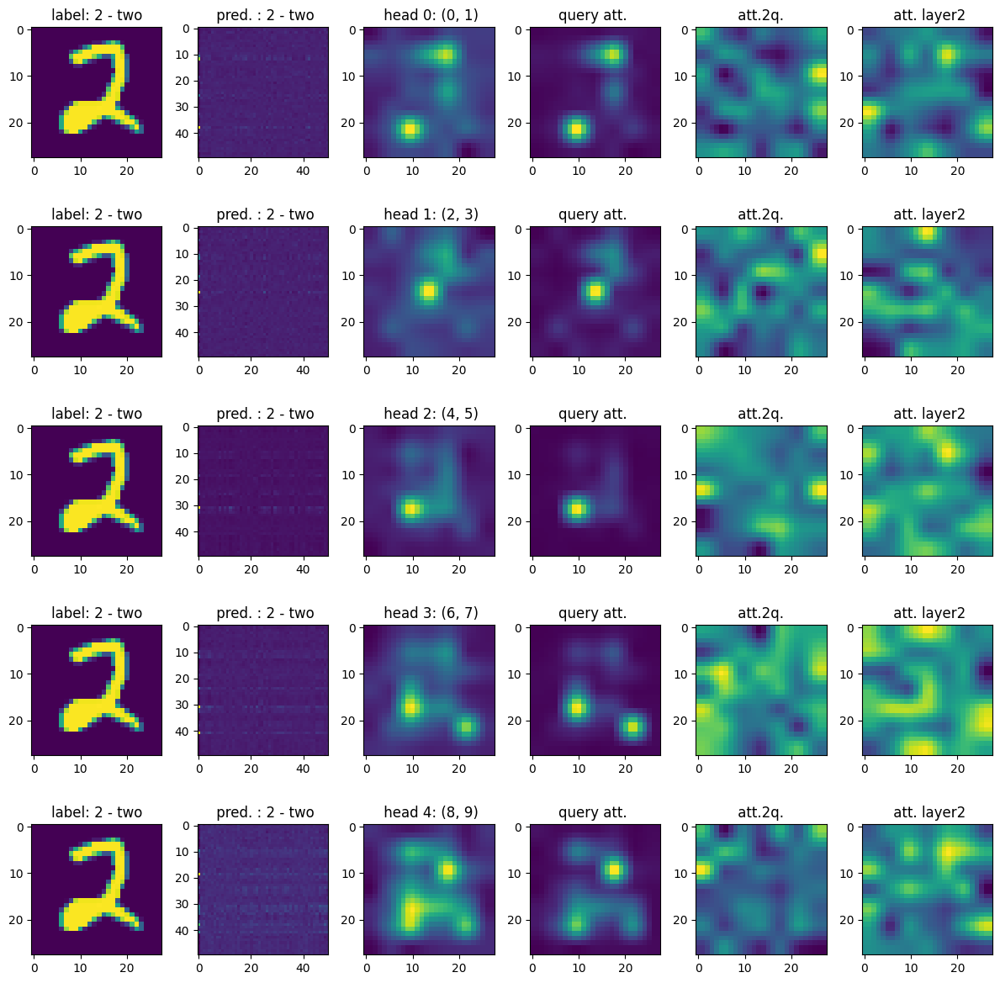

ic| t: 82


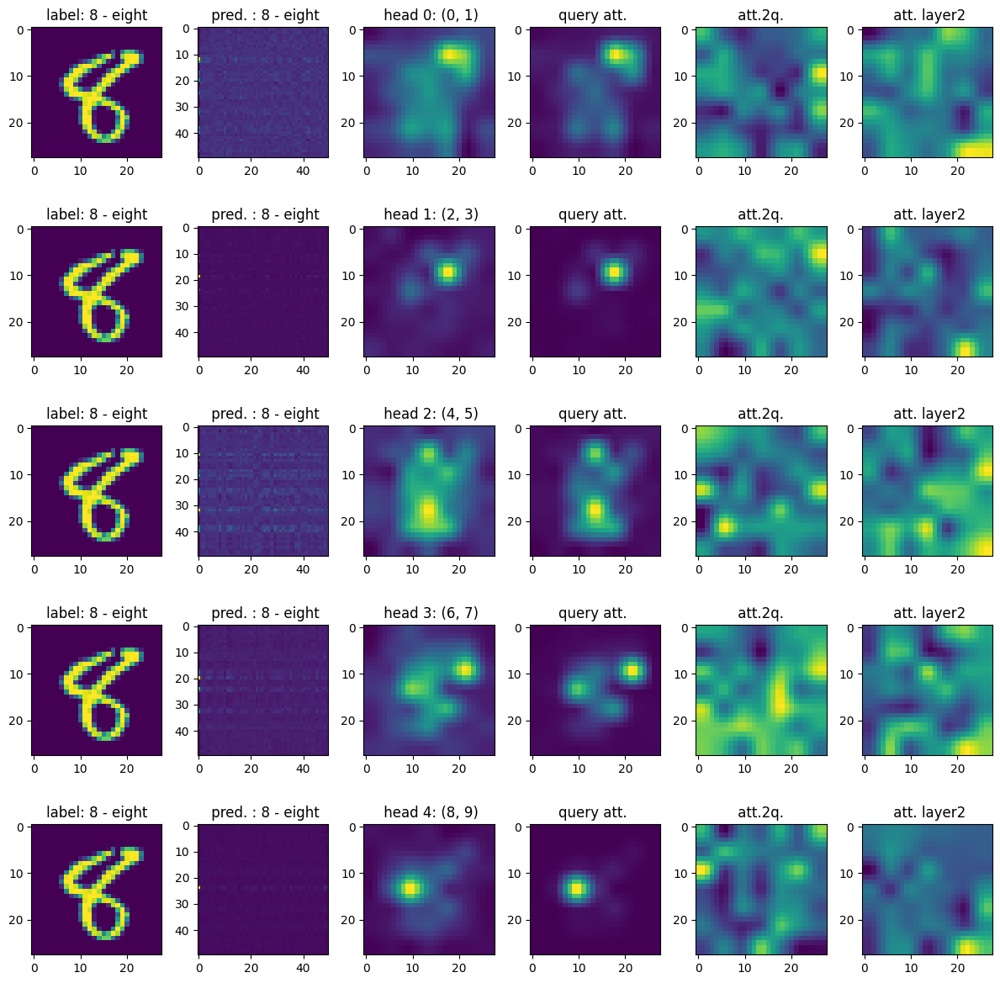

ic| t: 84


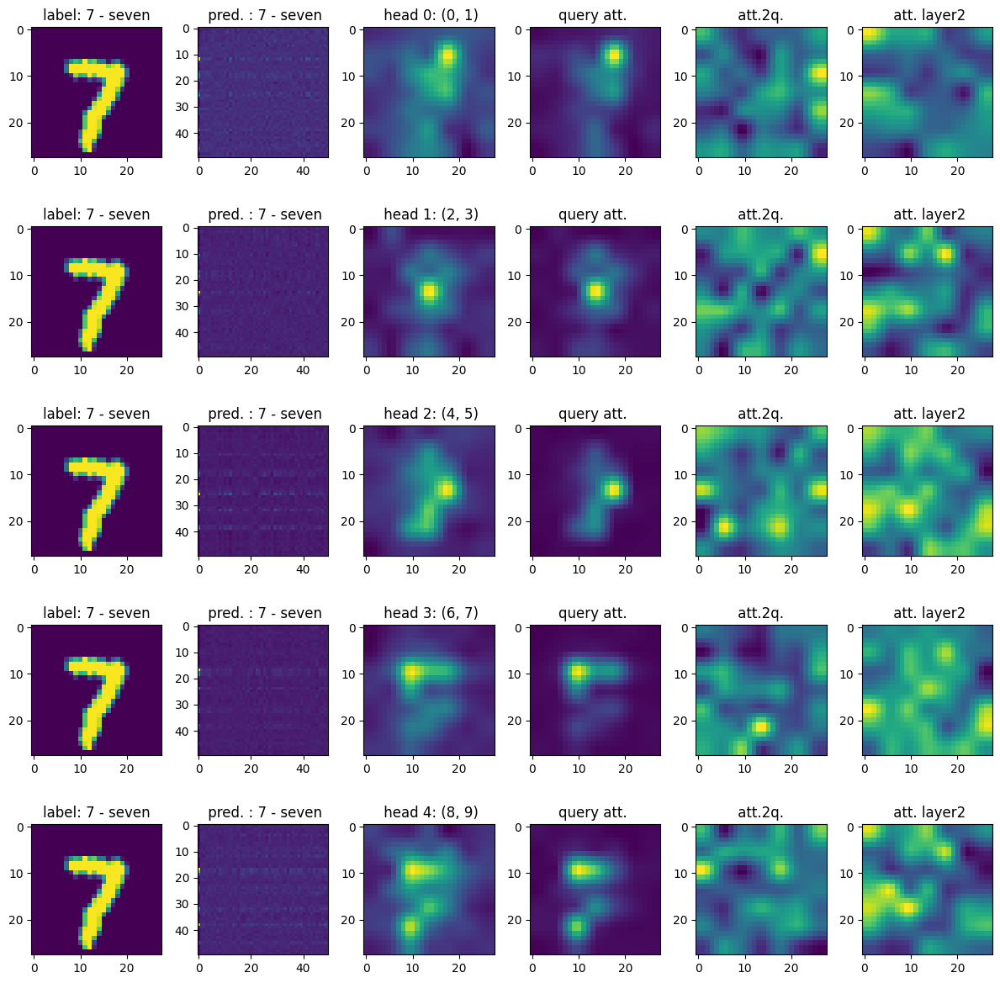

ic| t: 86


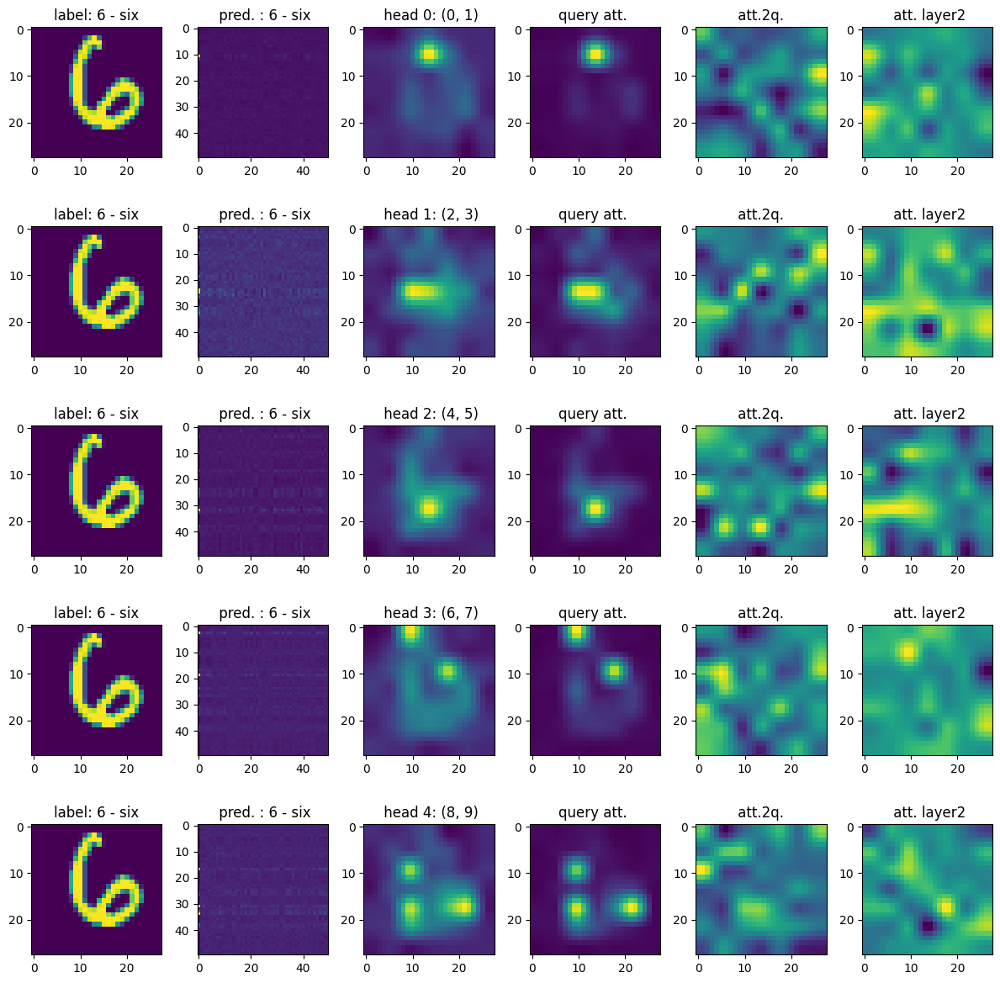

ic| t: 88


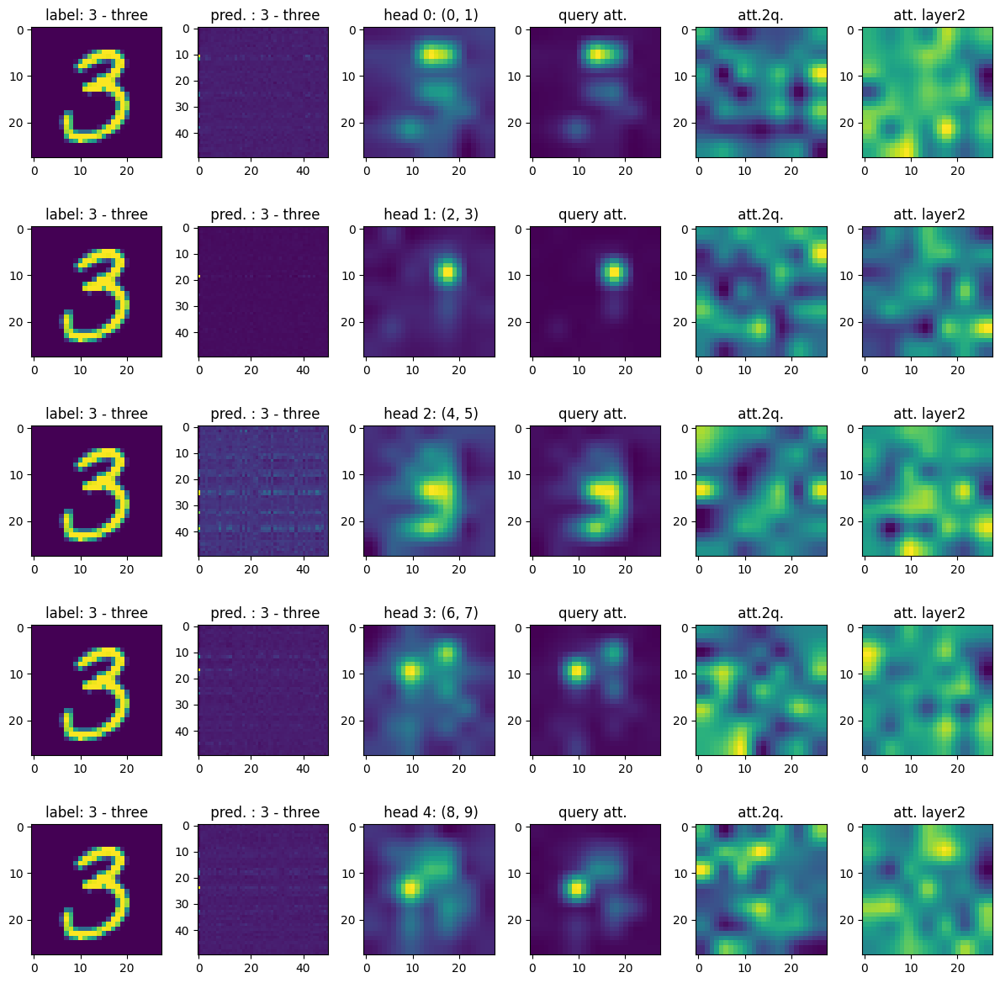

ic| t: 90


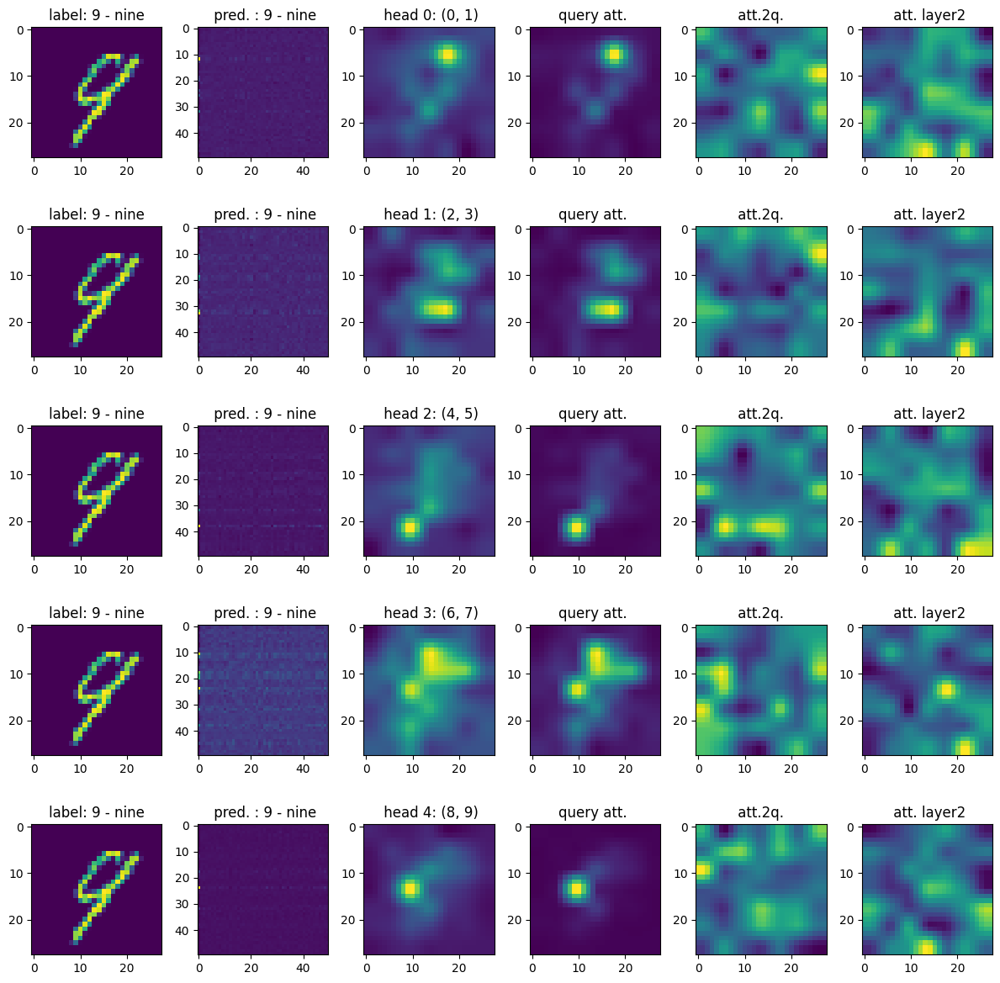

ic| t: 92


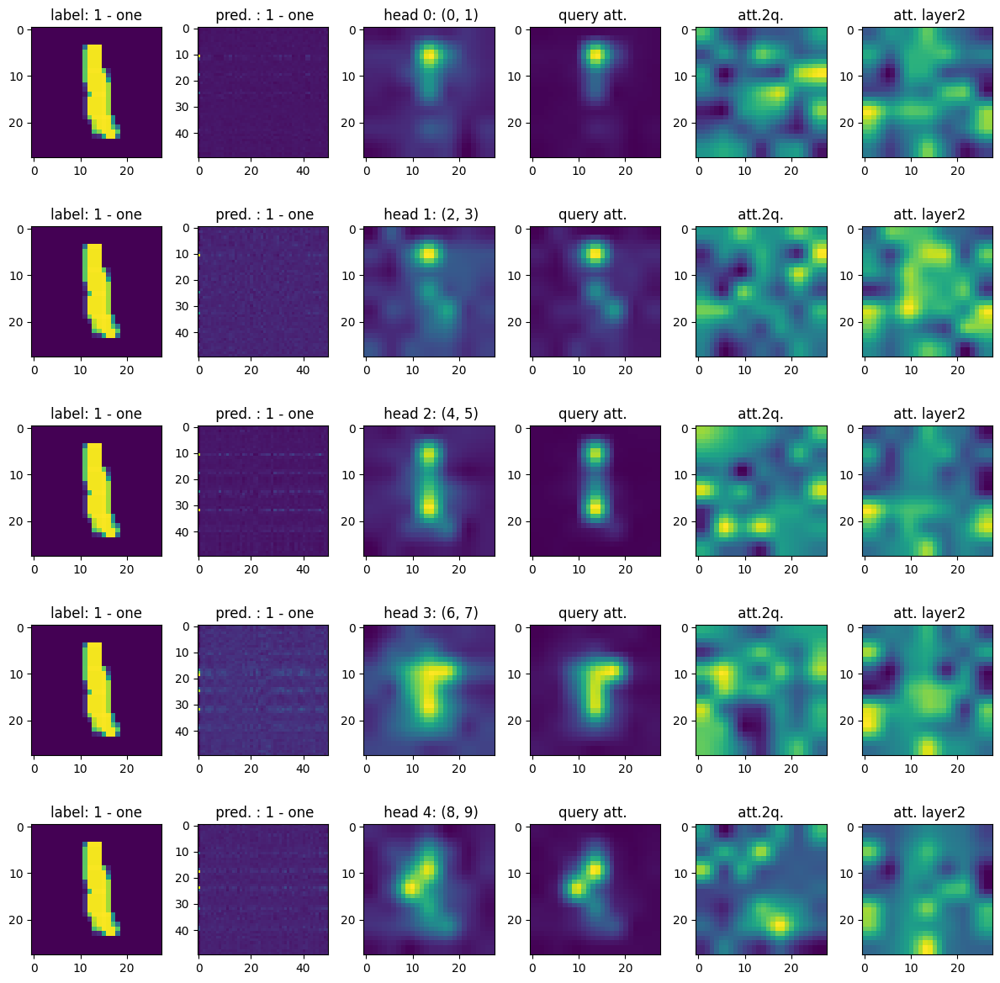

ic| t: 94


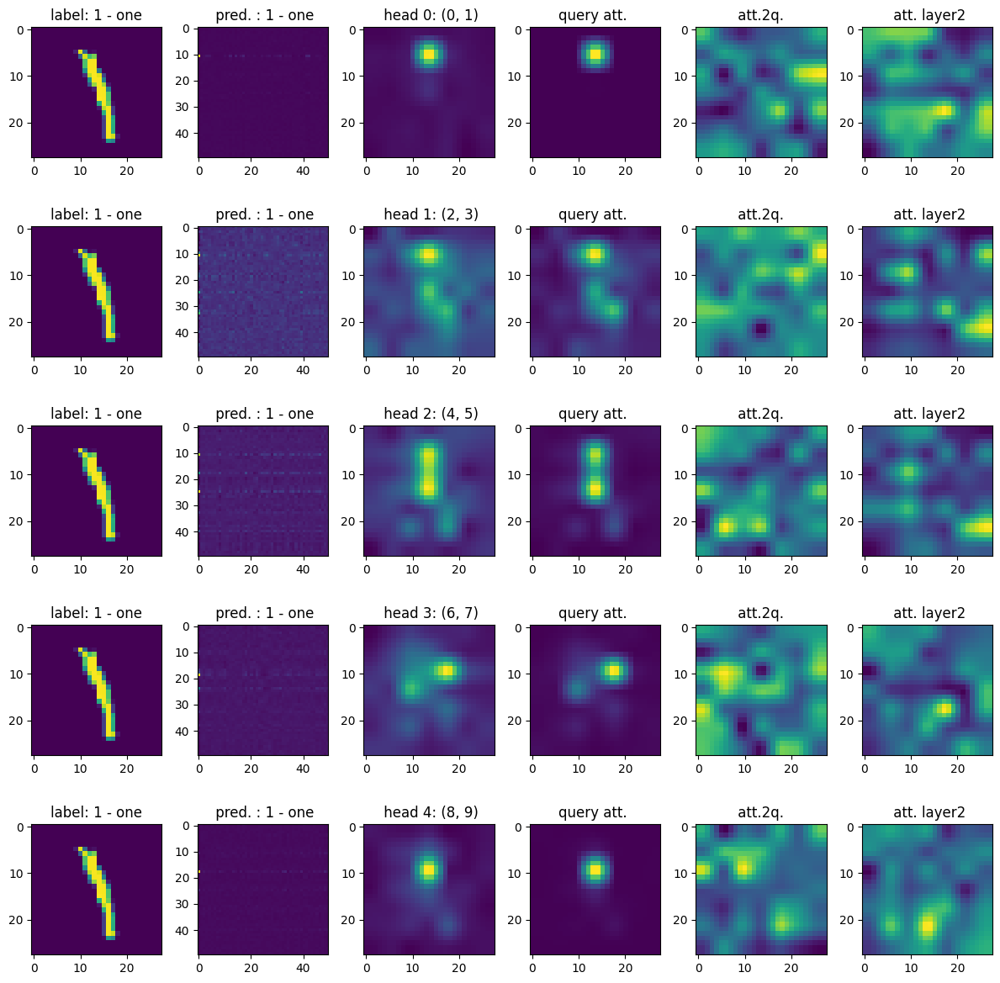

ic| t: 96


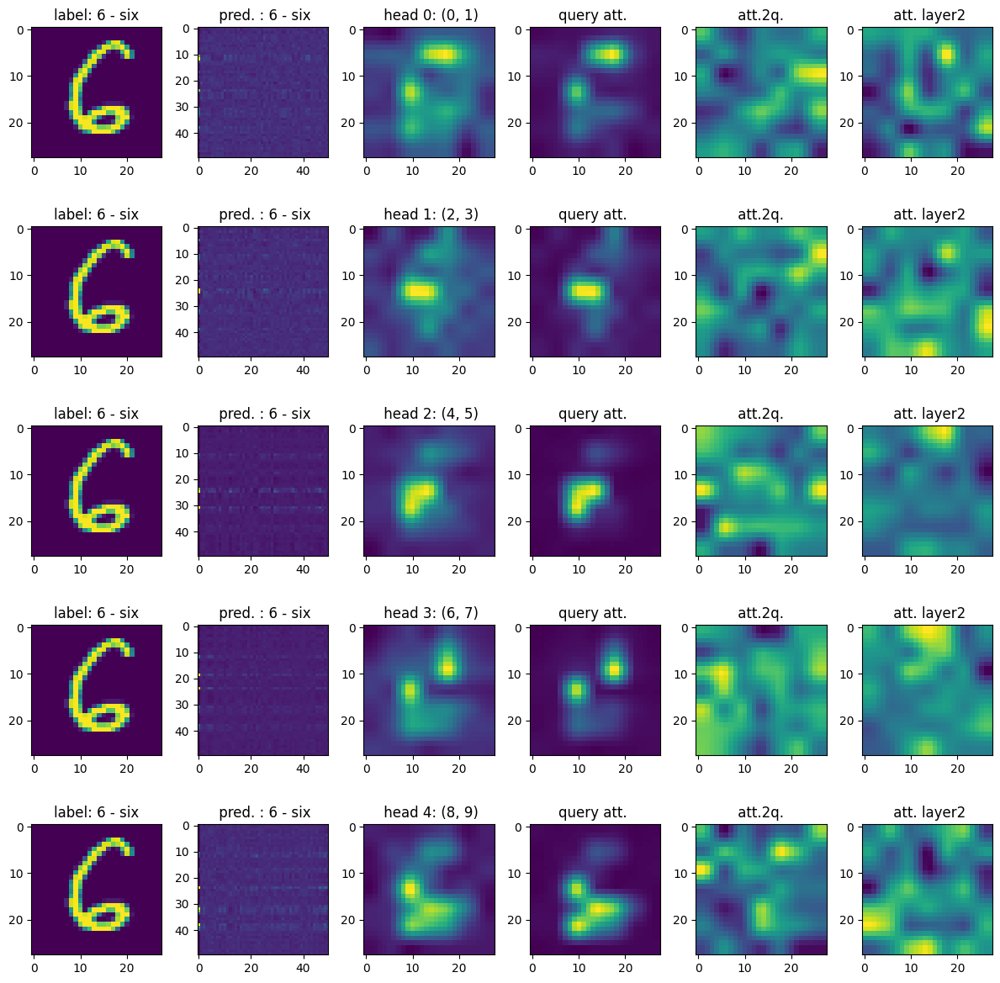

ic| t: 98


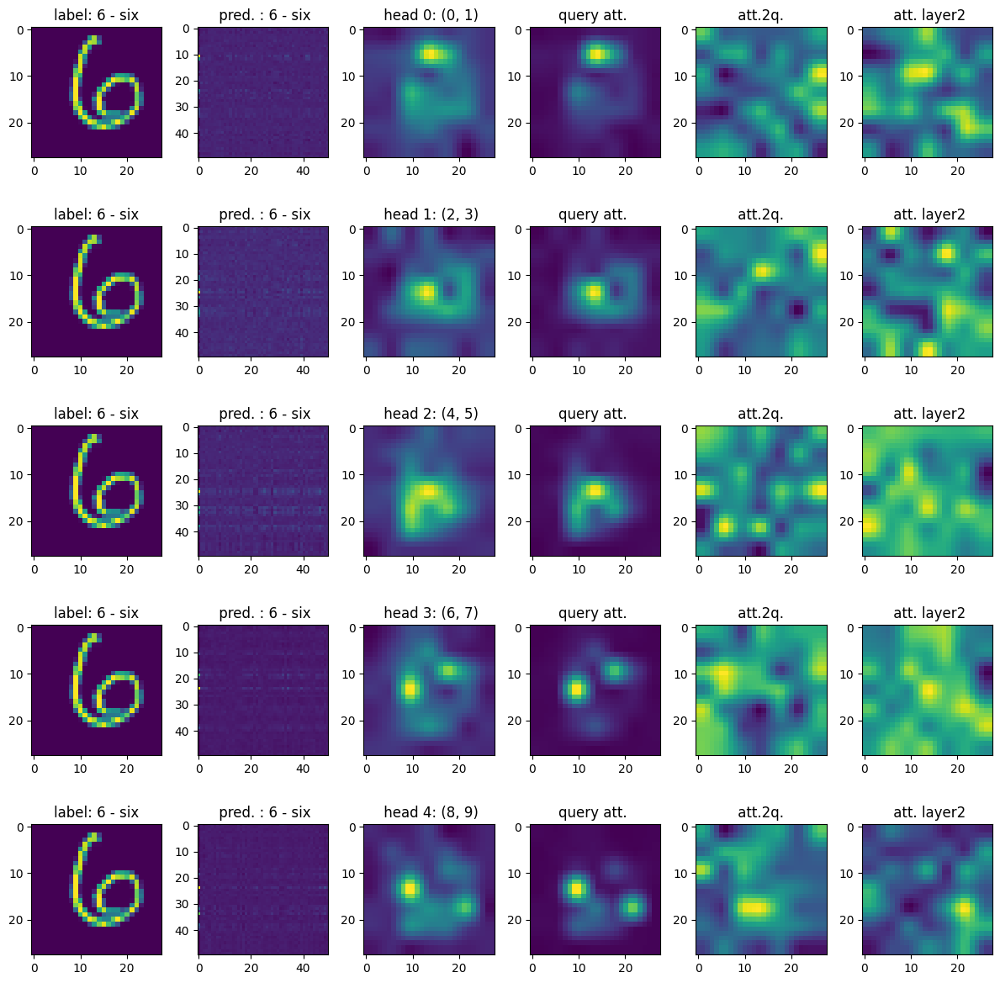

ic| t: 100


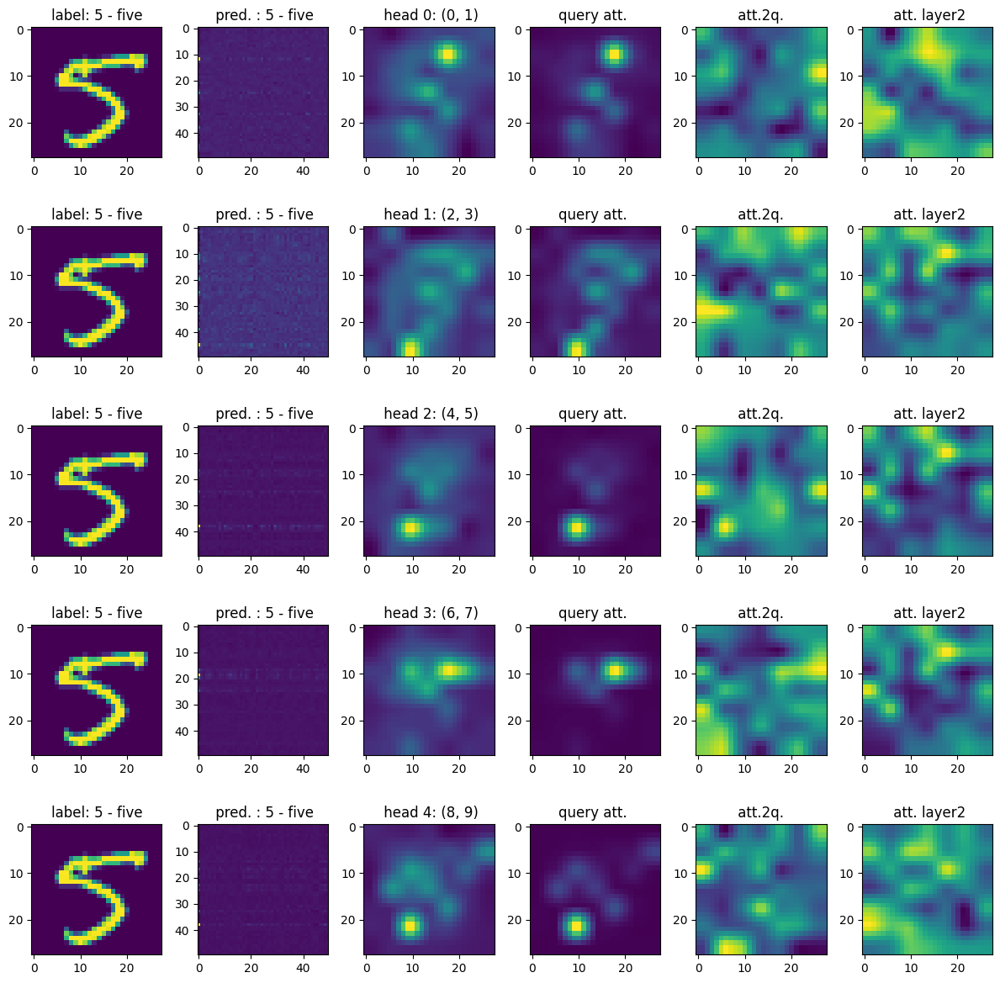

ic| t: 102


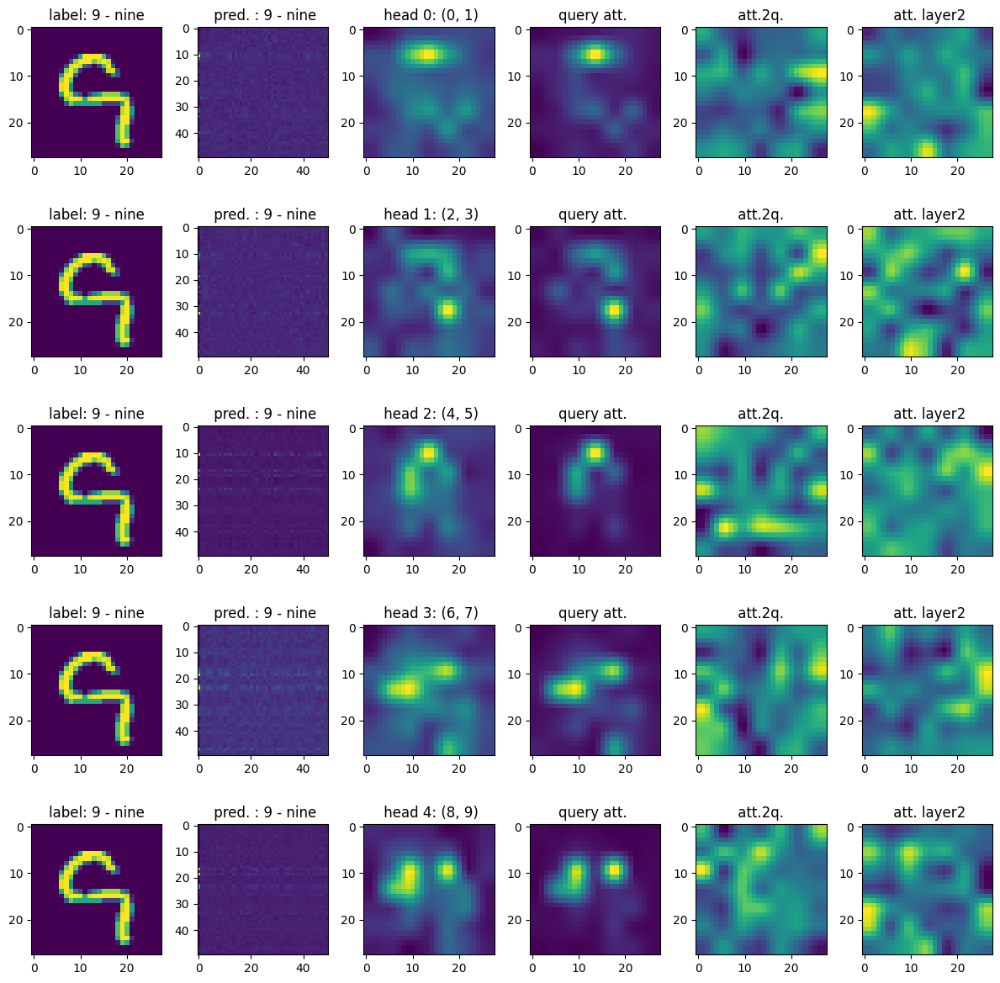

ic| t: 104


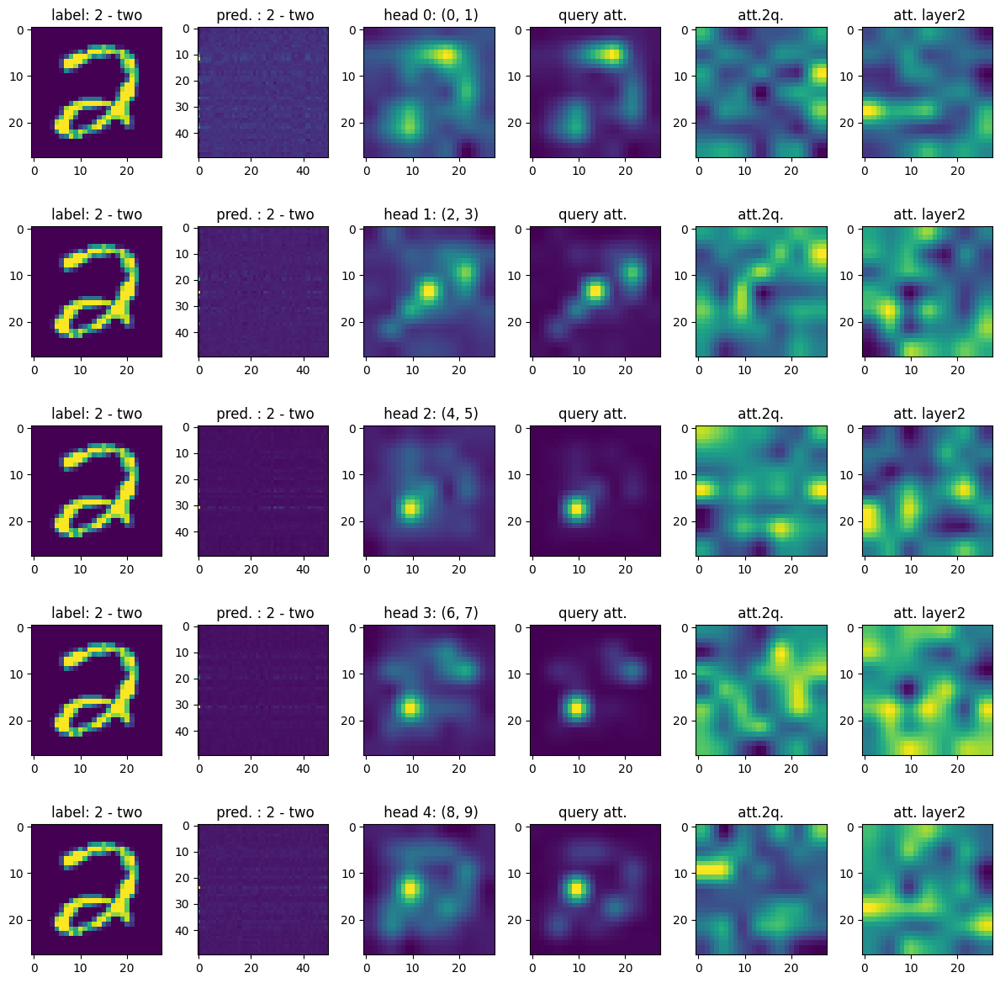

ic| t: 106


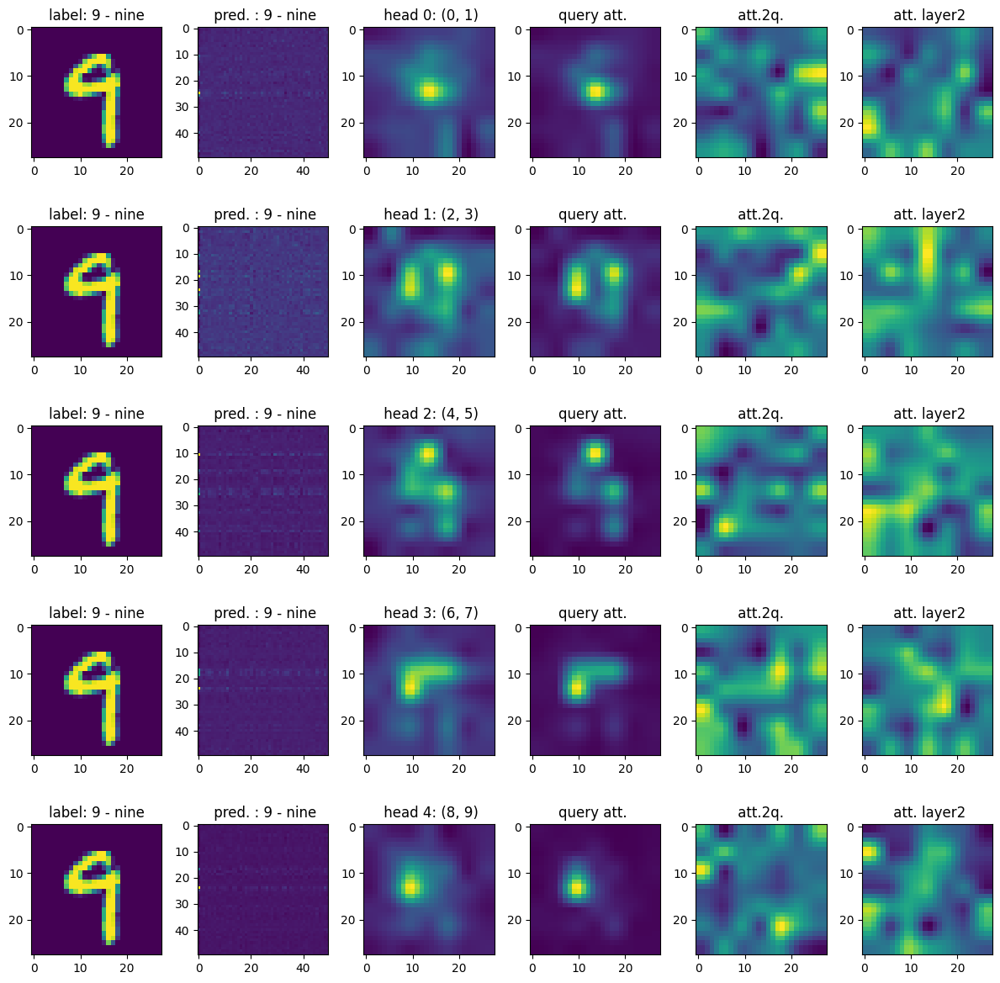

ic| t: 108


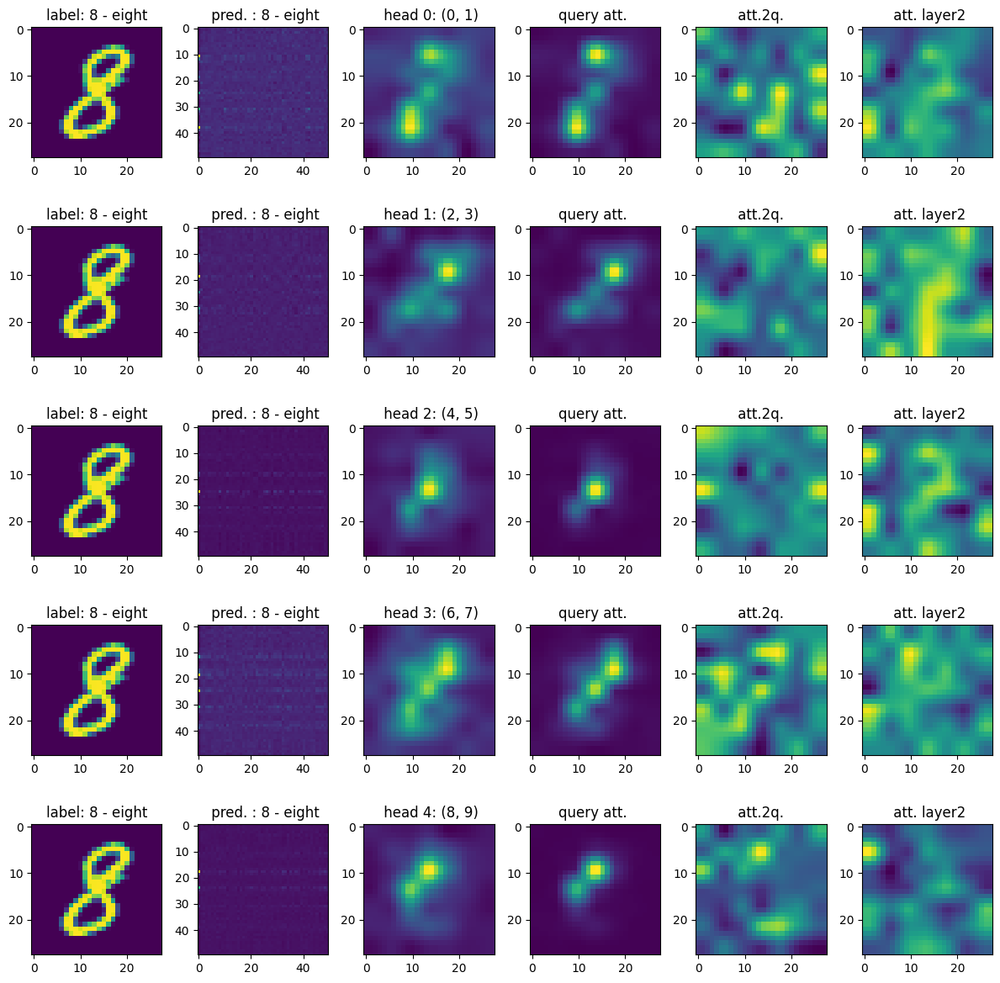

ic| t: 110


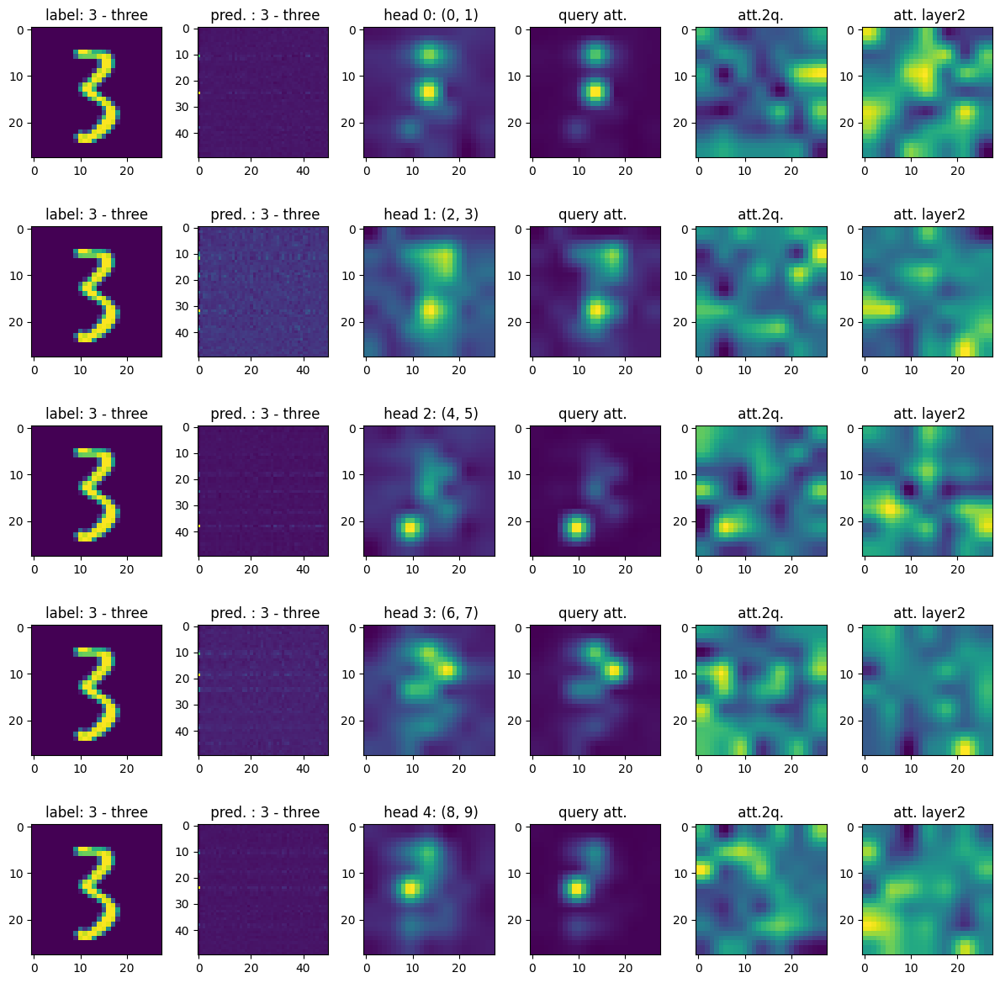

ic| t: 112


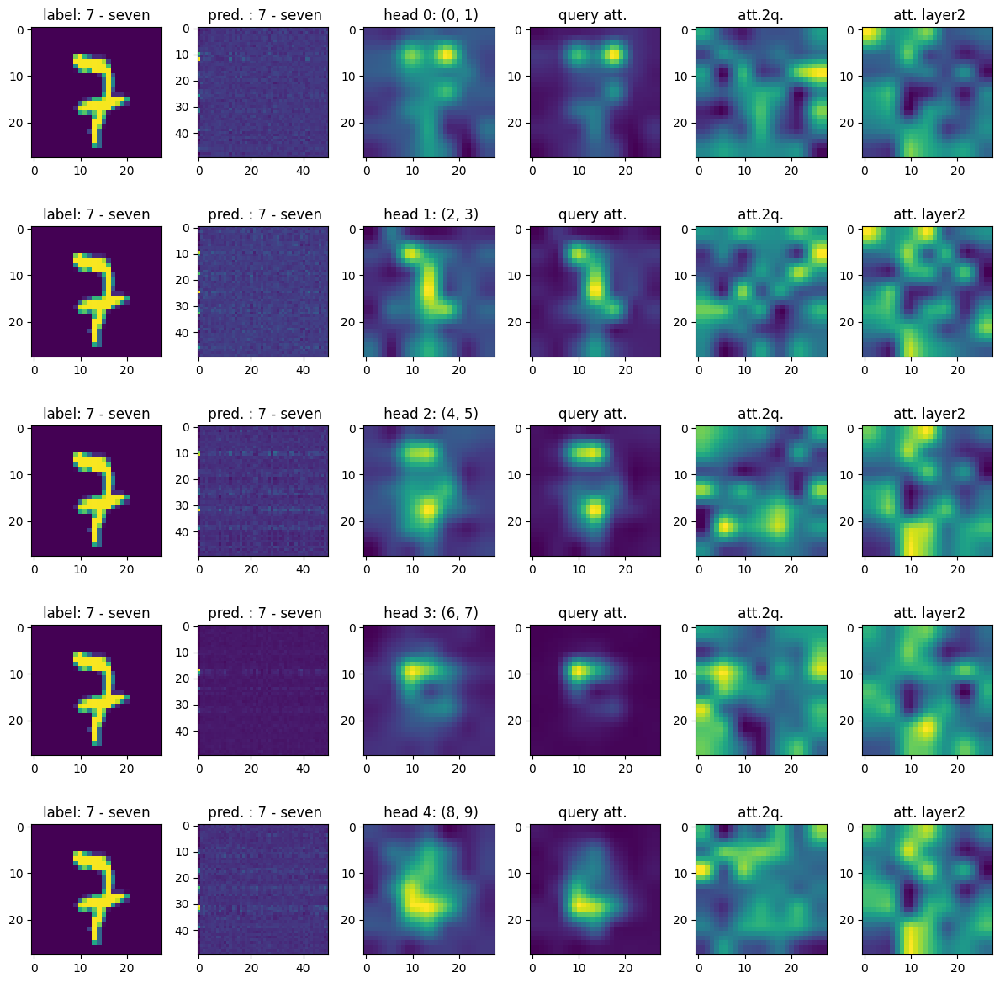

ic| t: 114


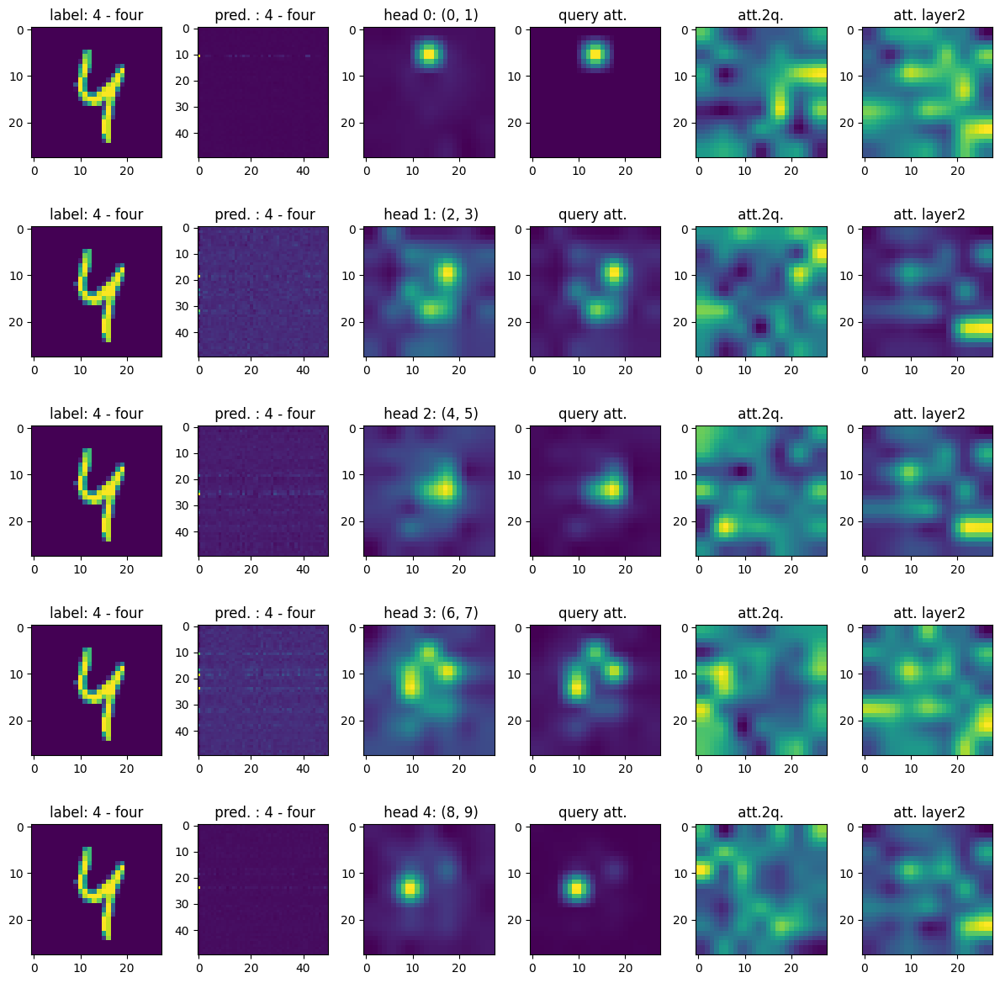

ic| t: 116


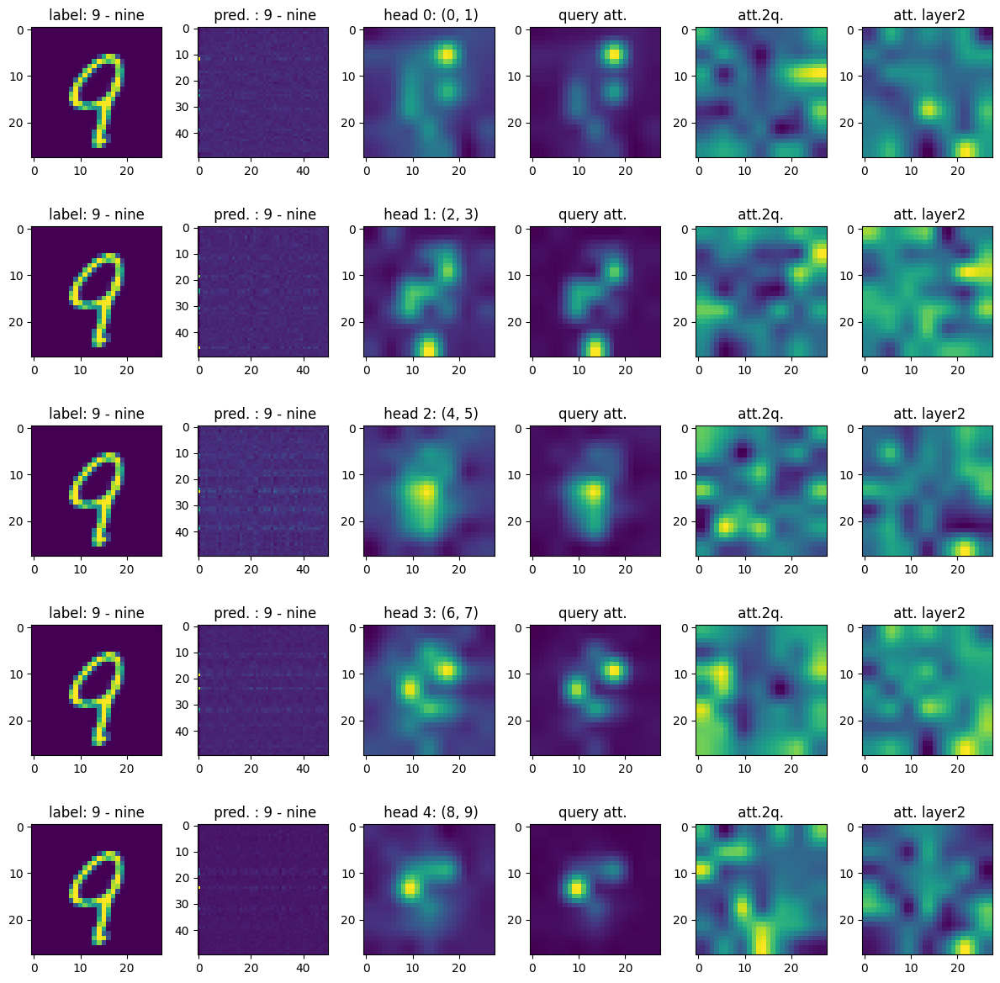

ic| t: 118


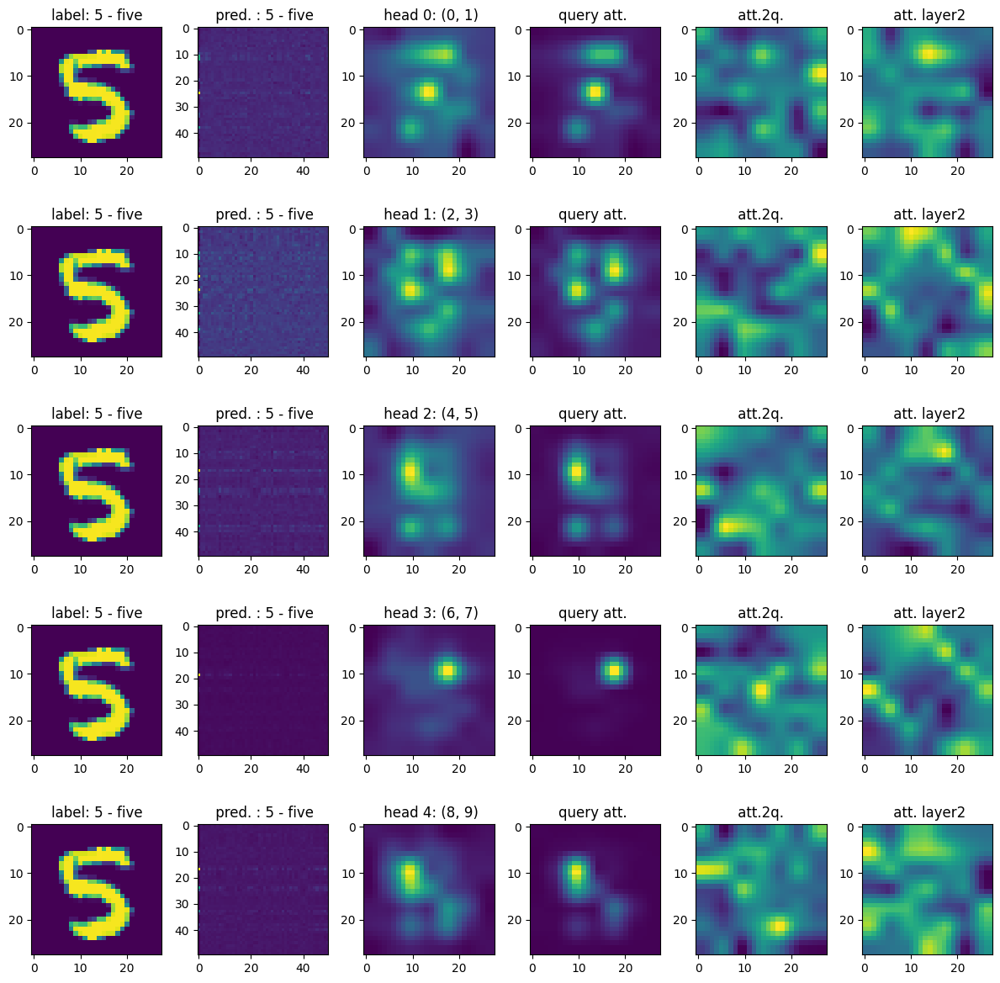

ic| t: 120


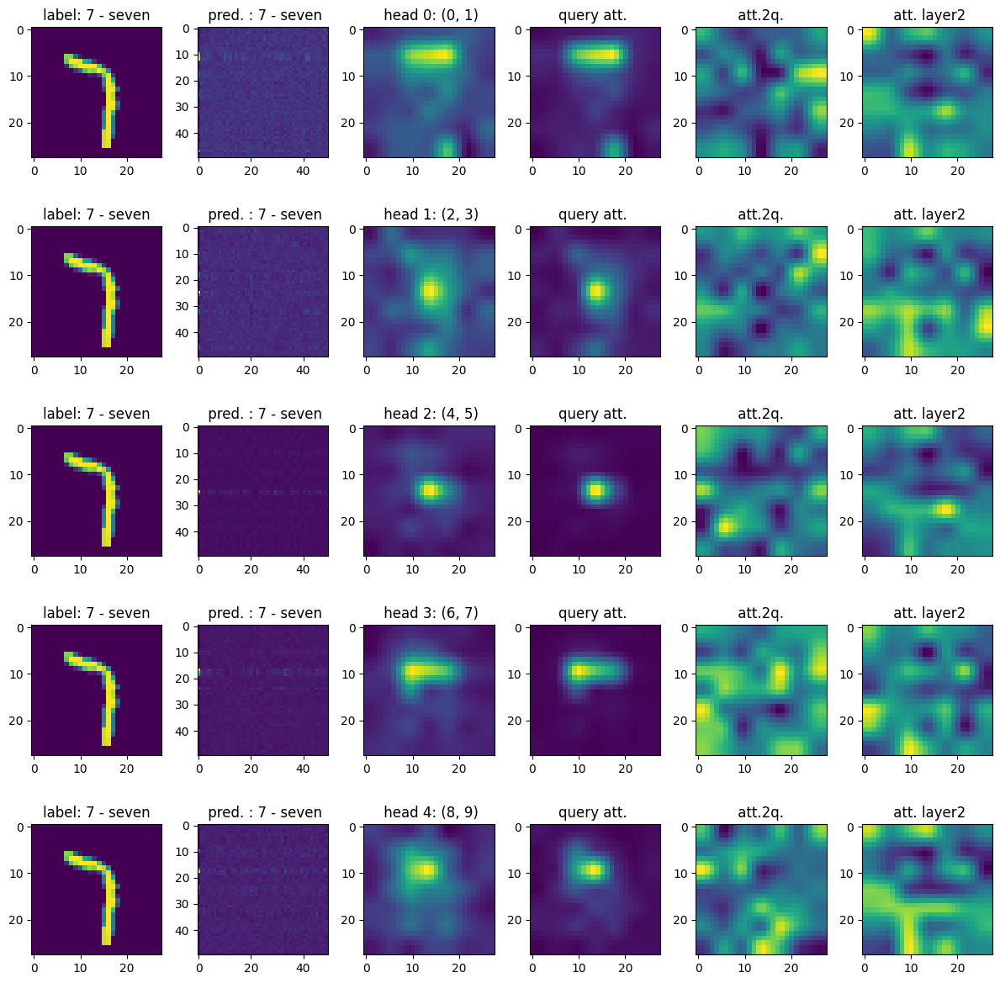

ic| t: 122


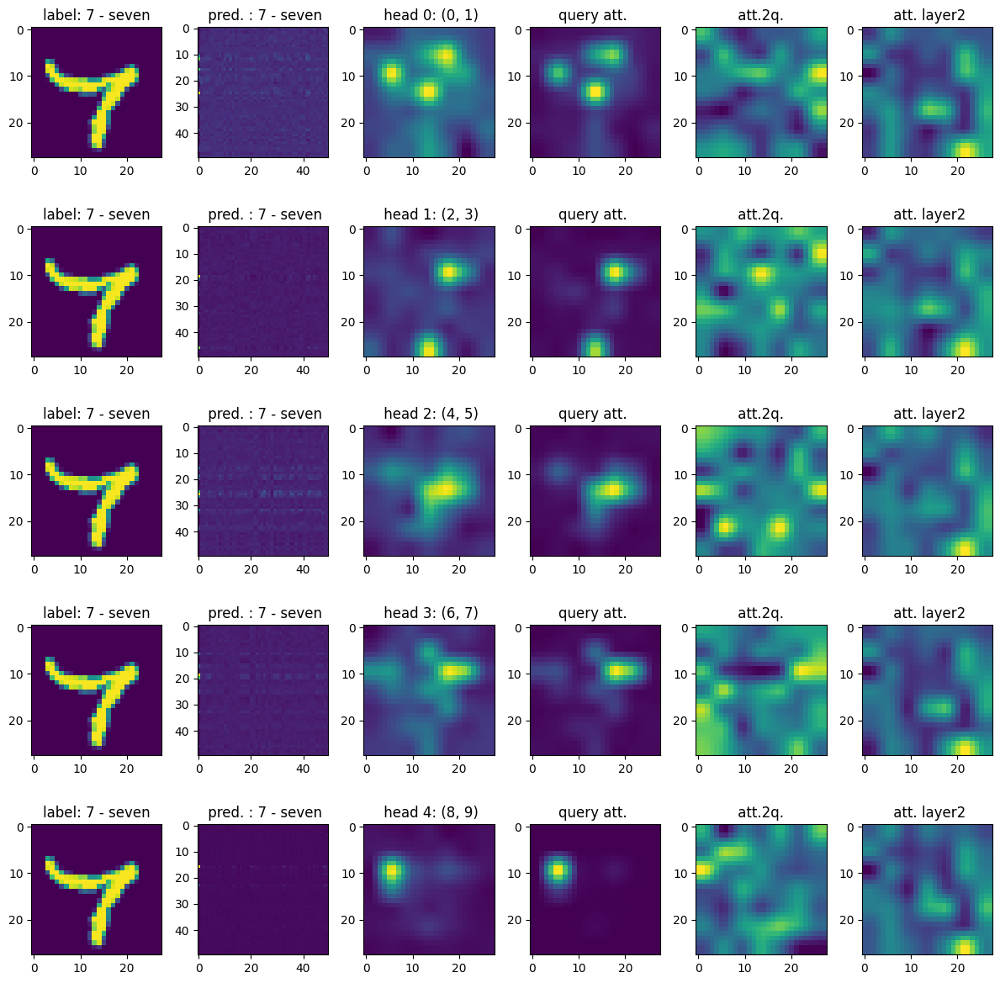

ic| t: 124


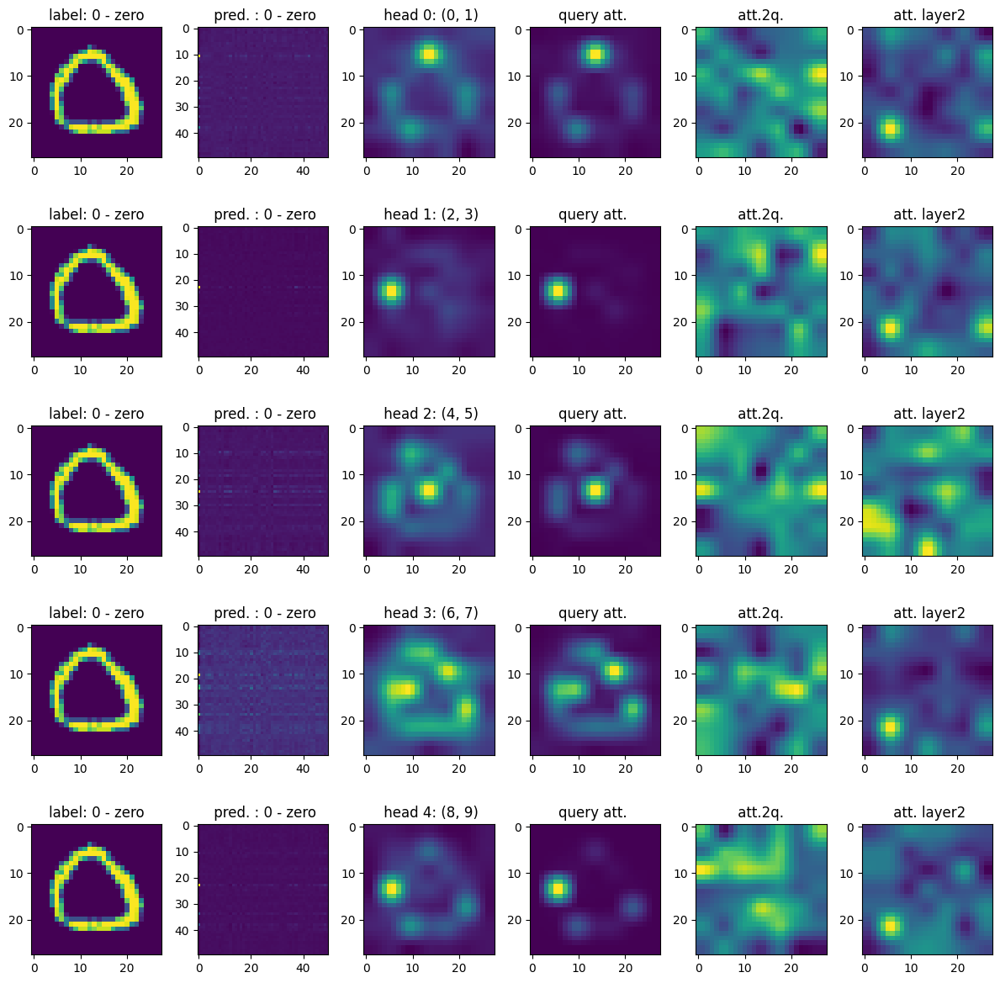

ic| t: 126


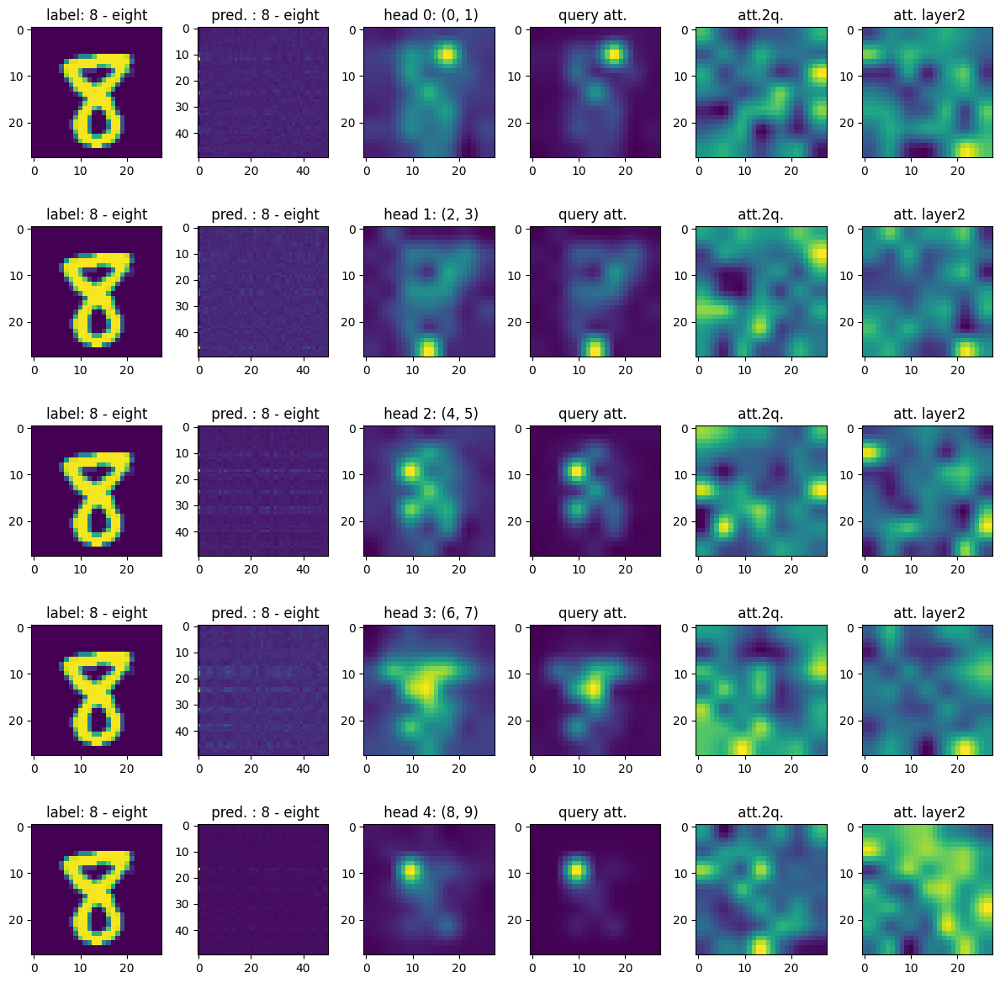

ic| t: 128


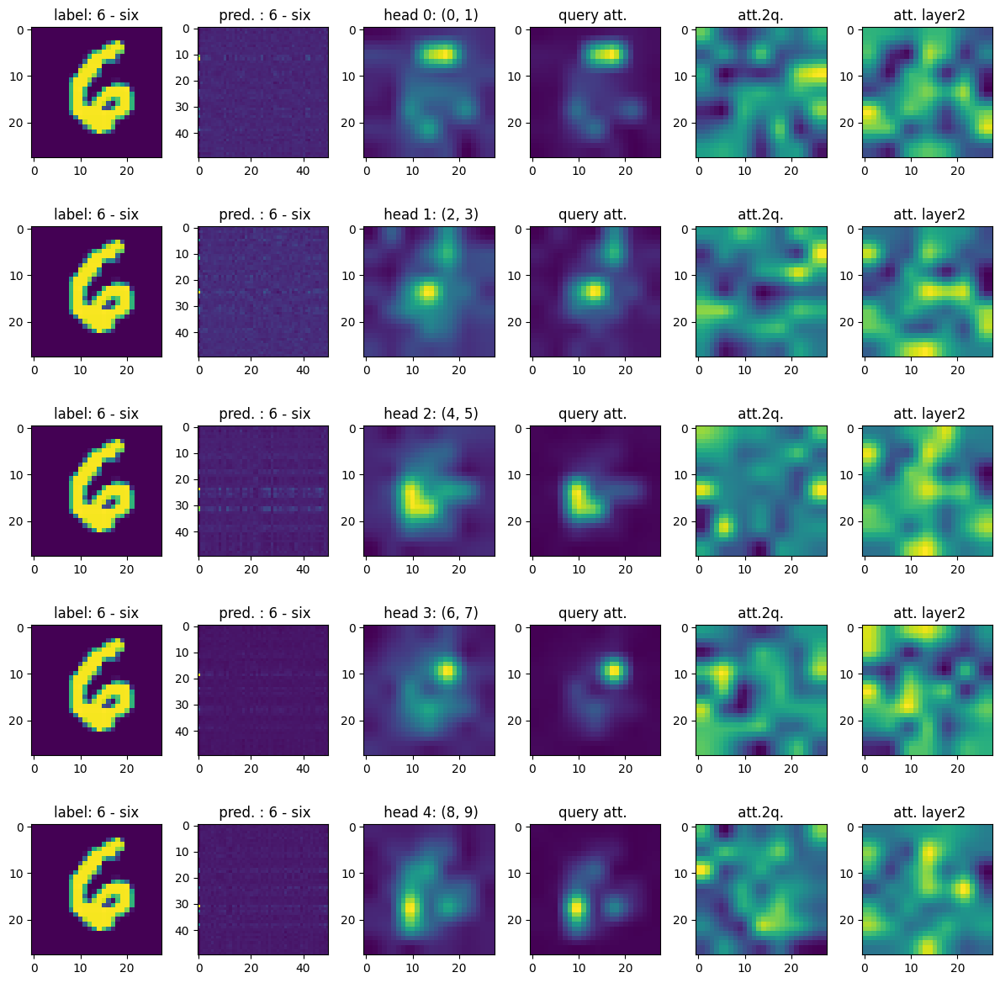

ic| t: 130


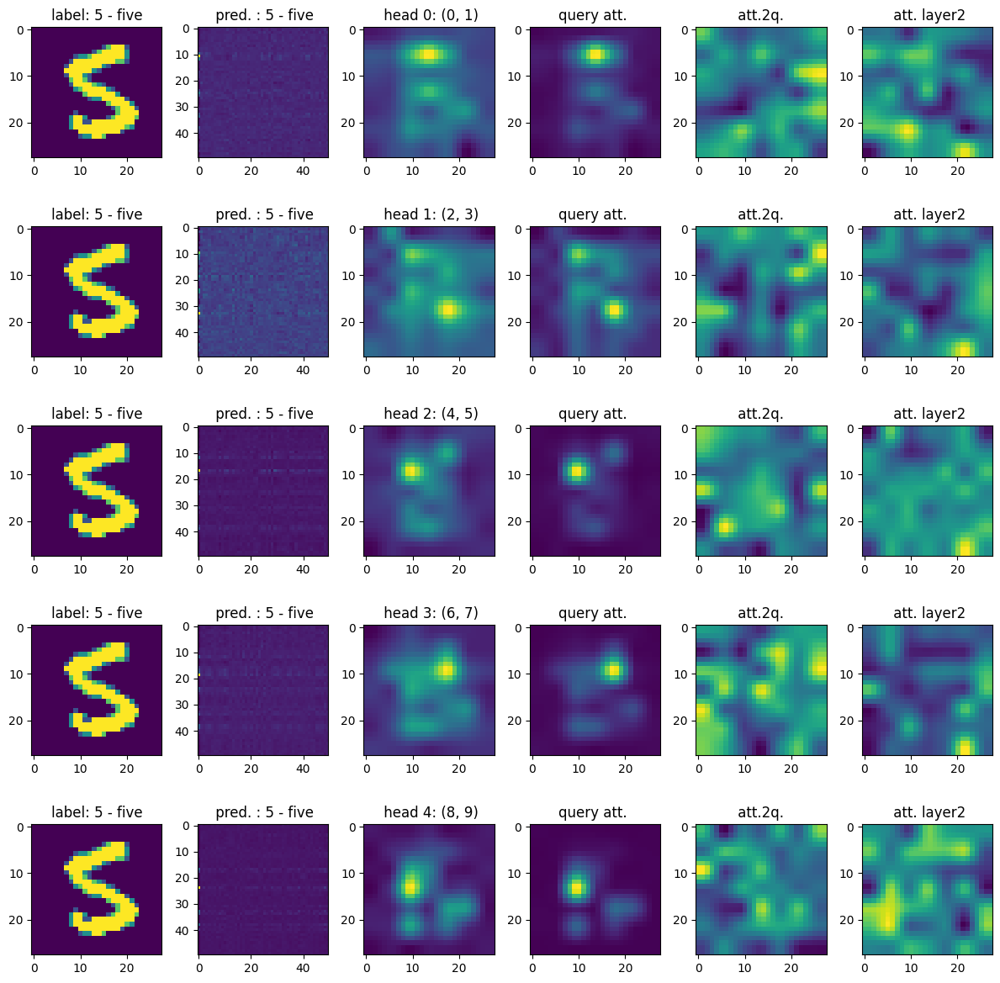

ic| t: 132


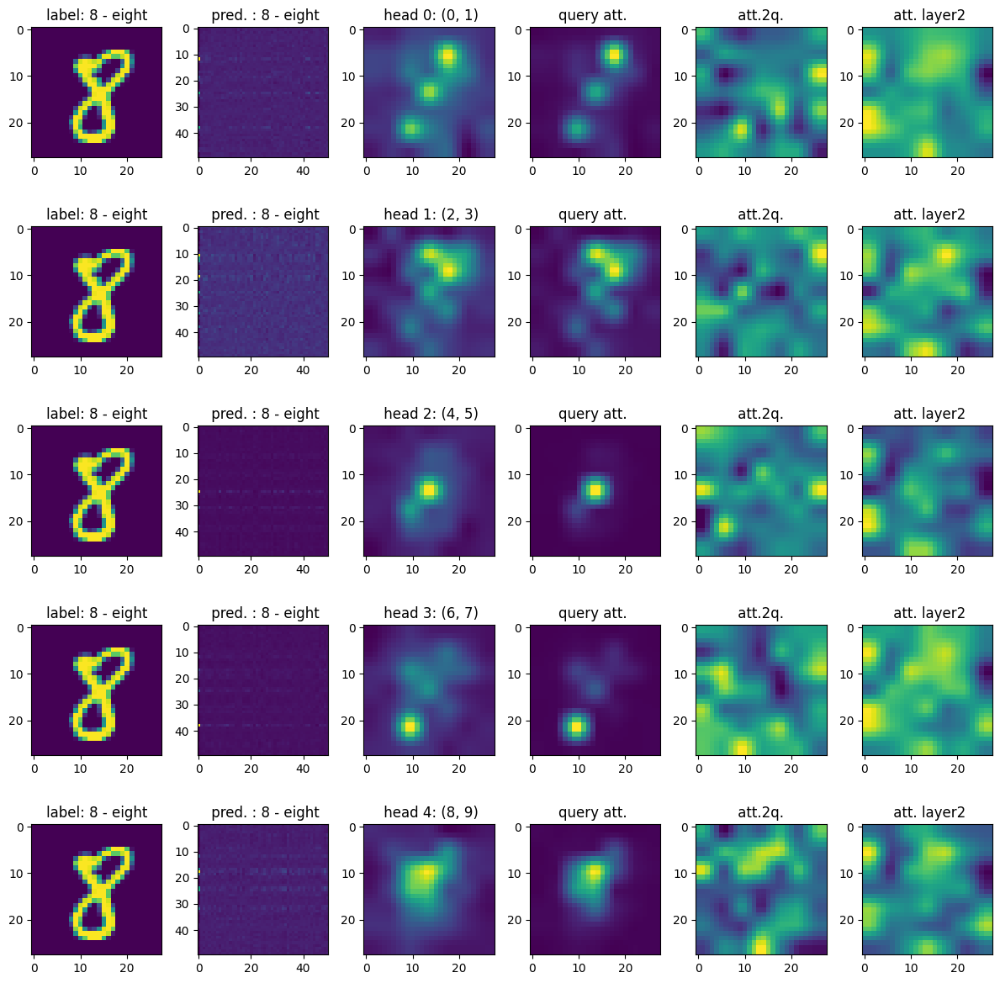

ic| t: 134


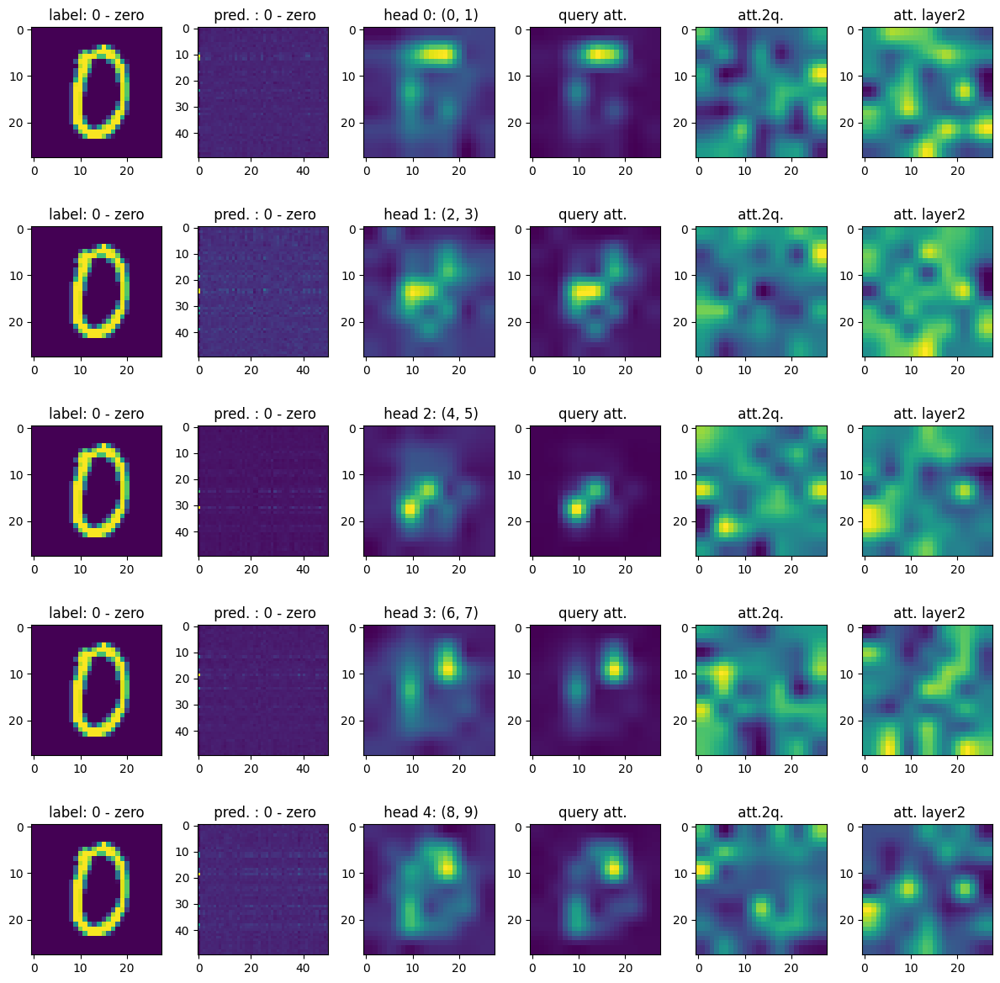

ic| t: 136


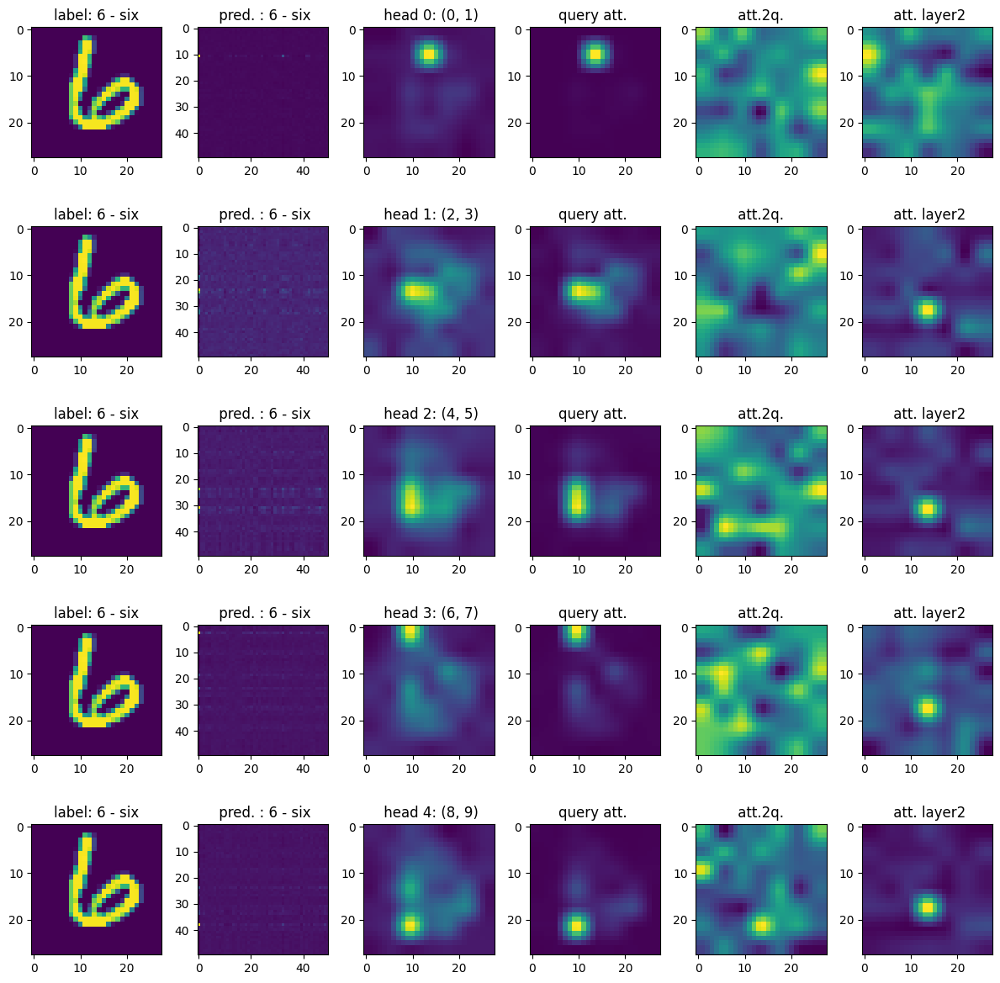

ic| t: 138


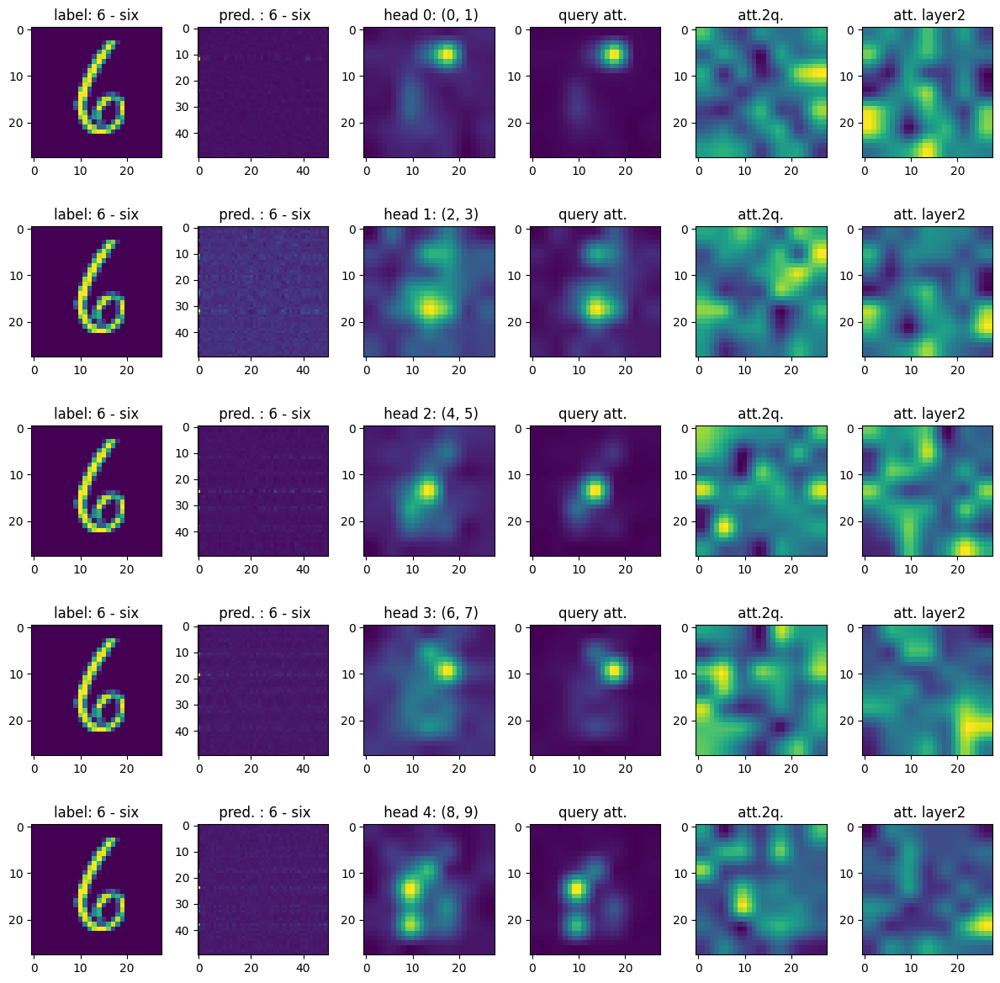

ic| t: 140


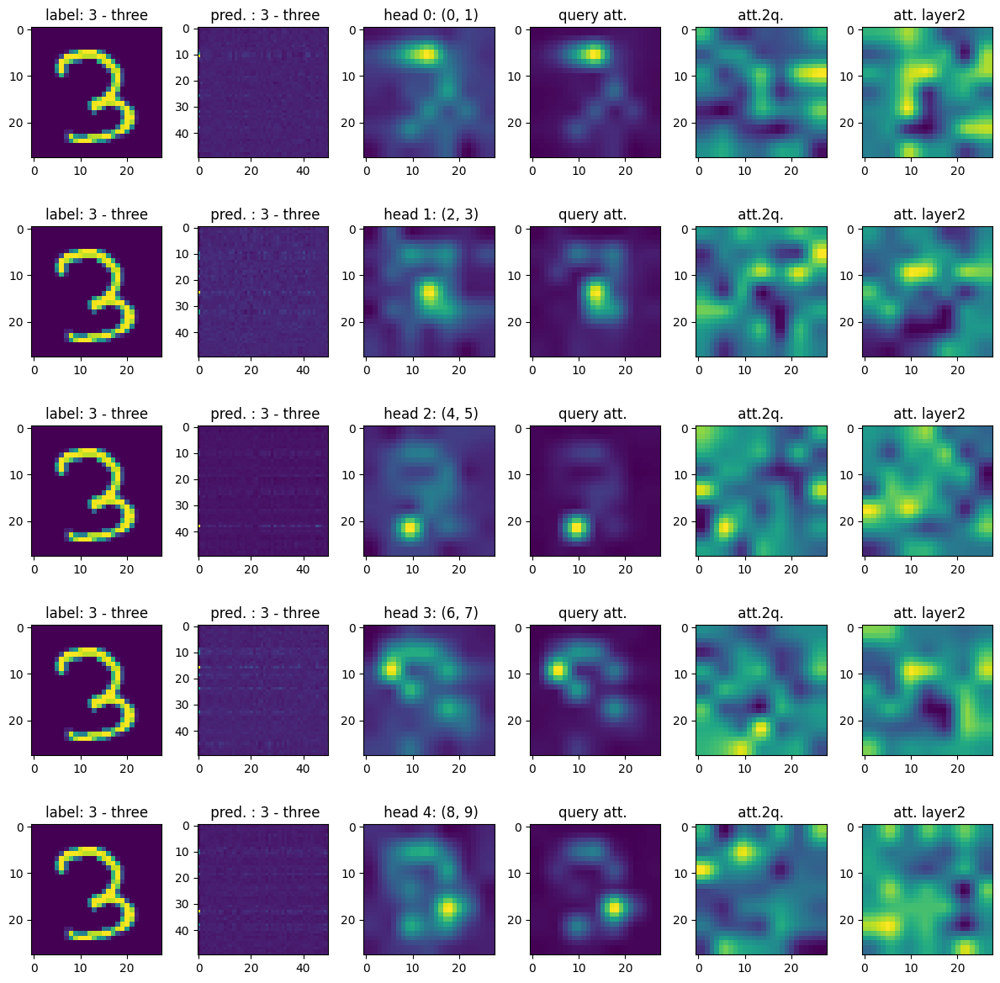

ic| t: 142


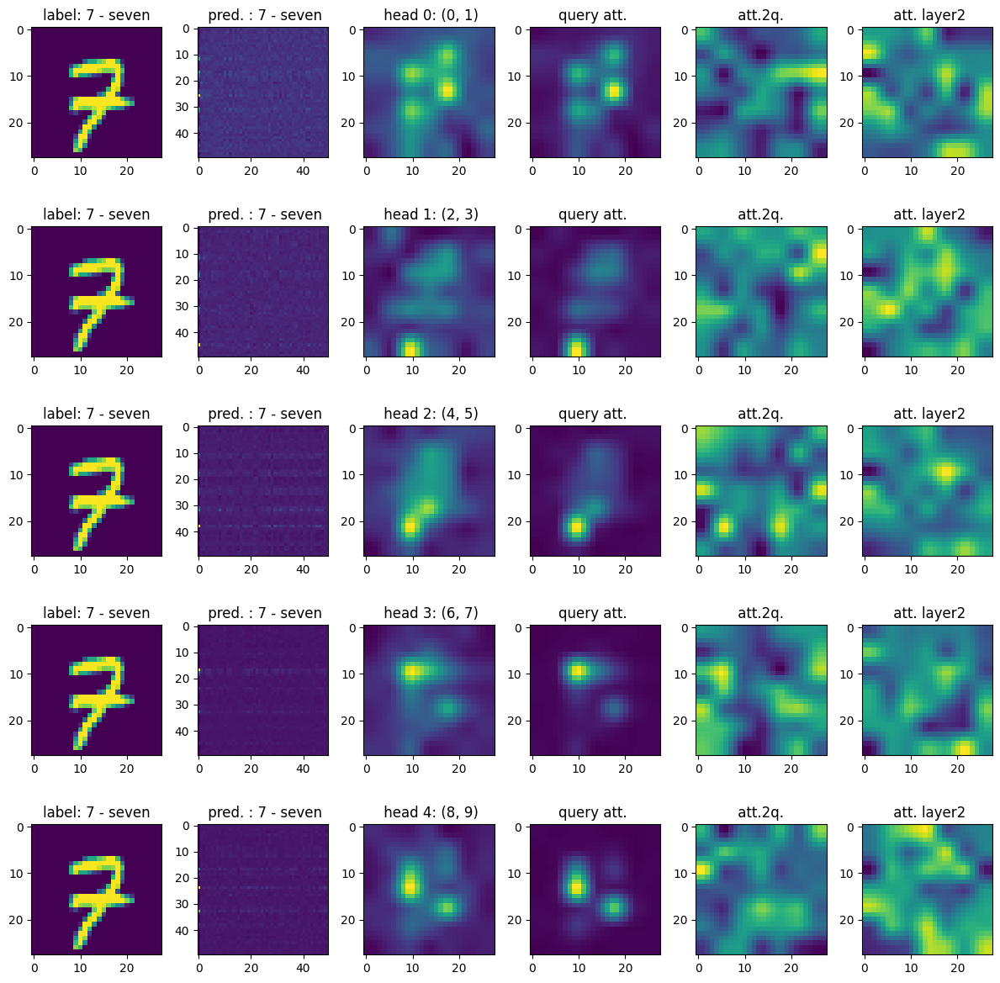

ic| t: 144


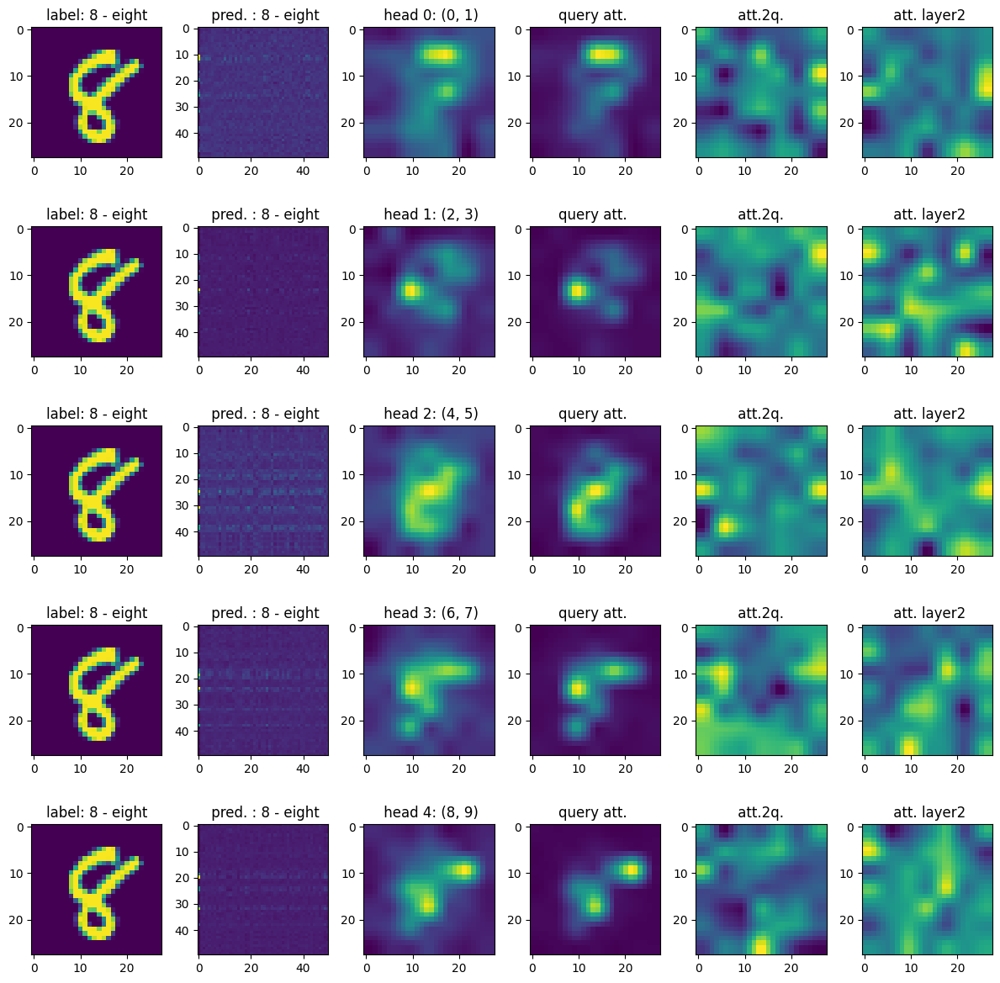

ic| t: 146


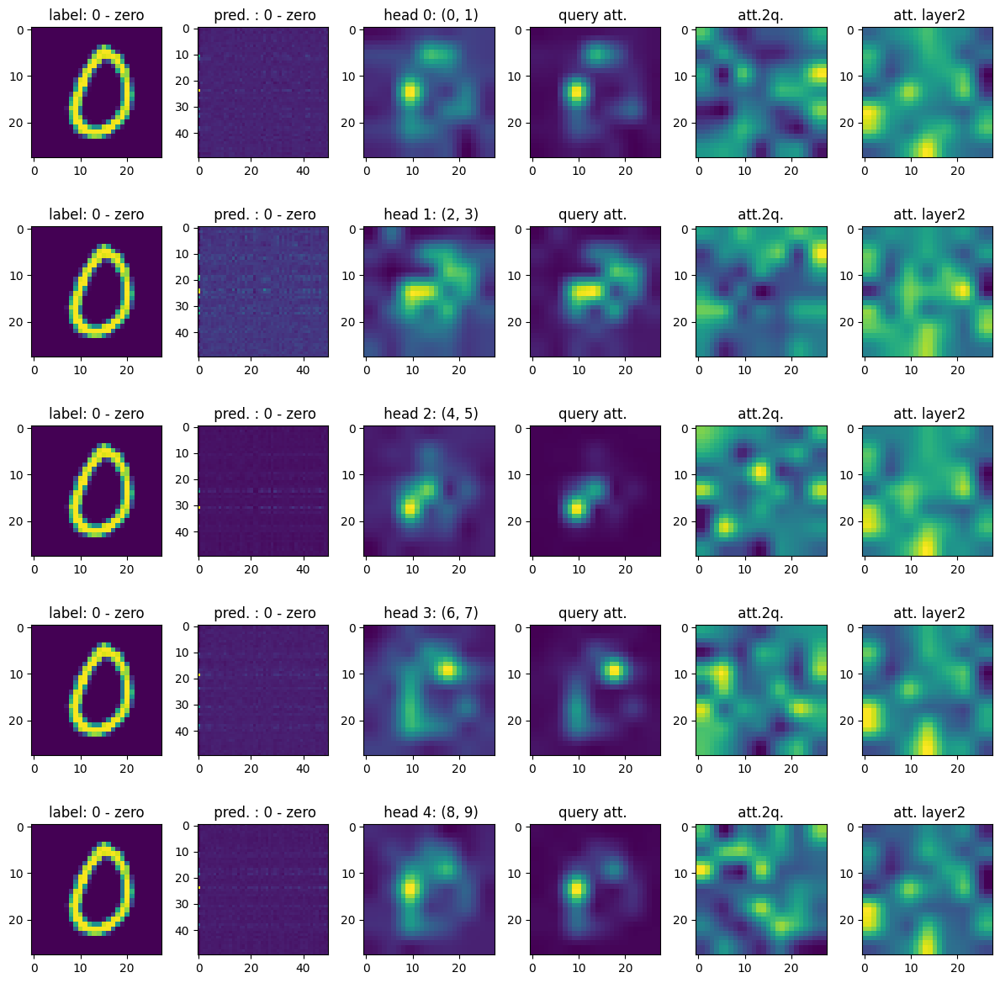

ic| t: 148


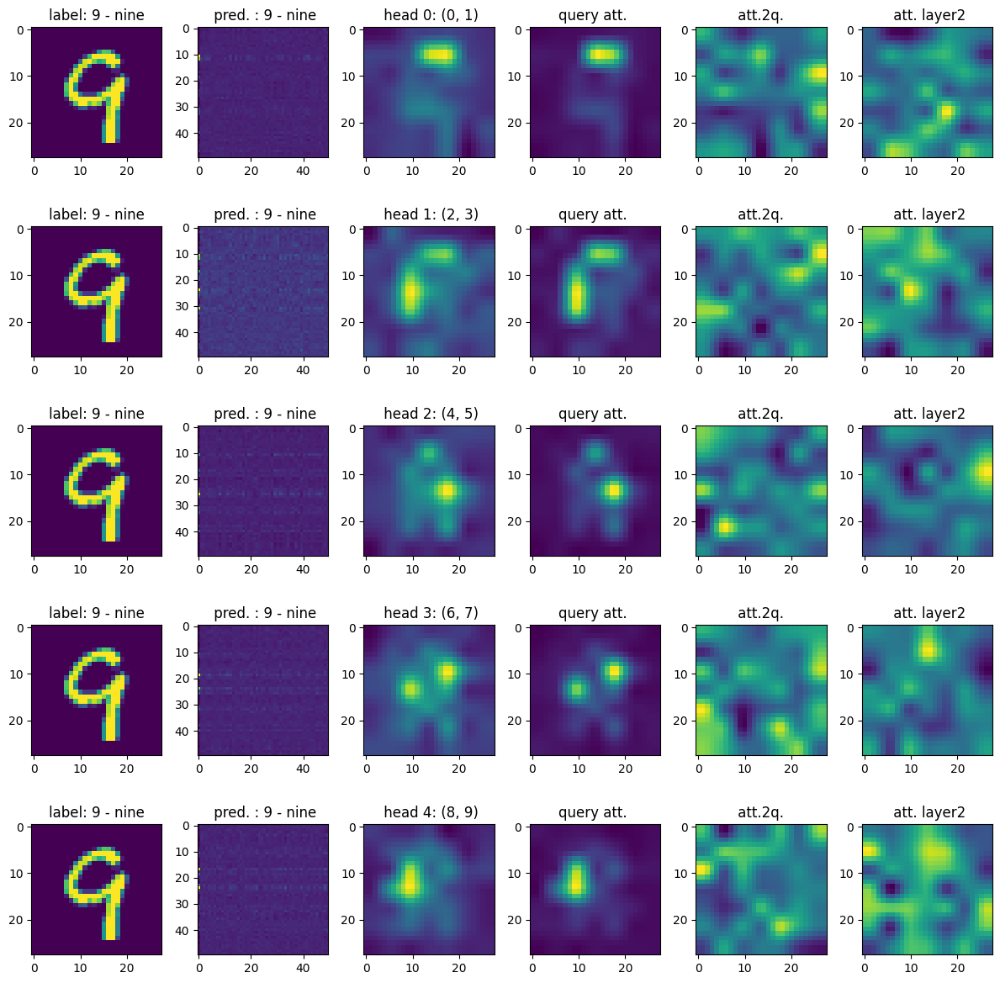

ic| t: 150


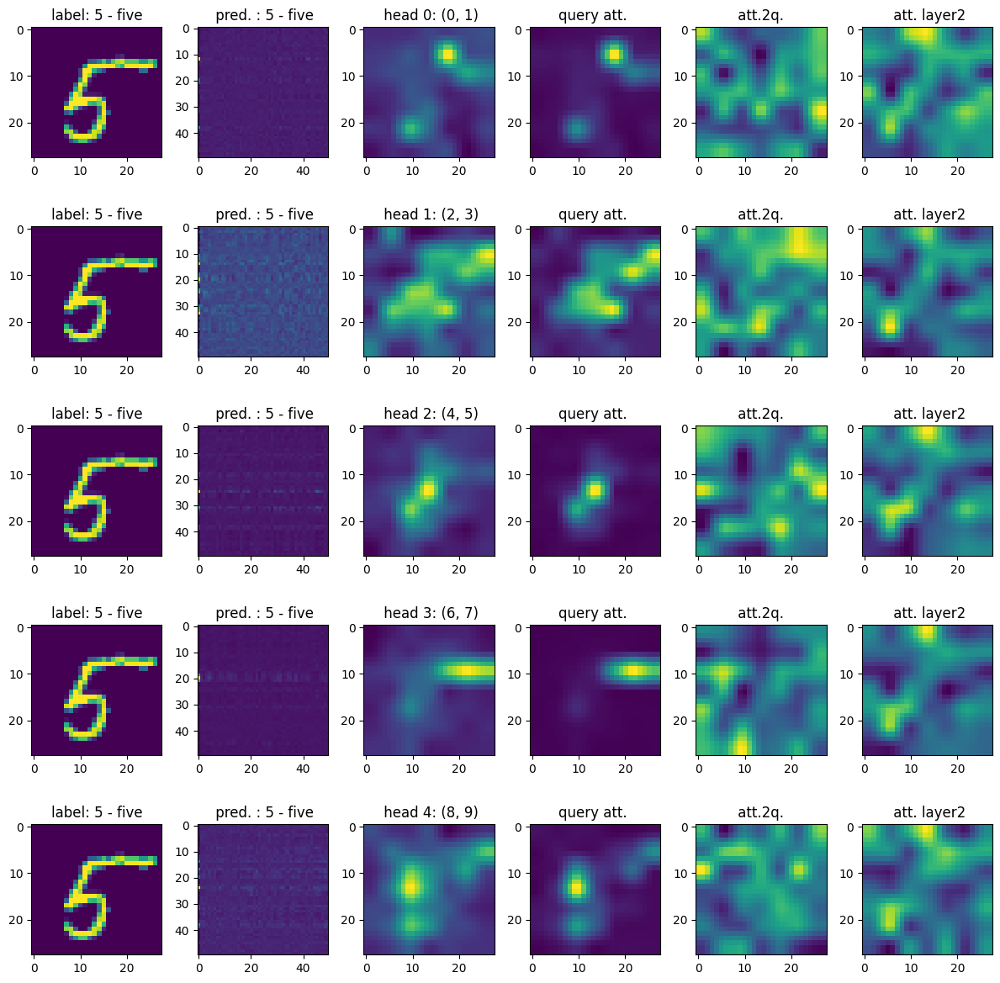

ic| t: 152


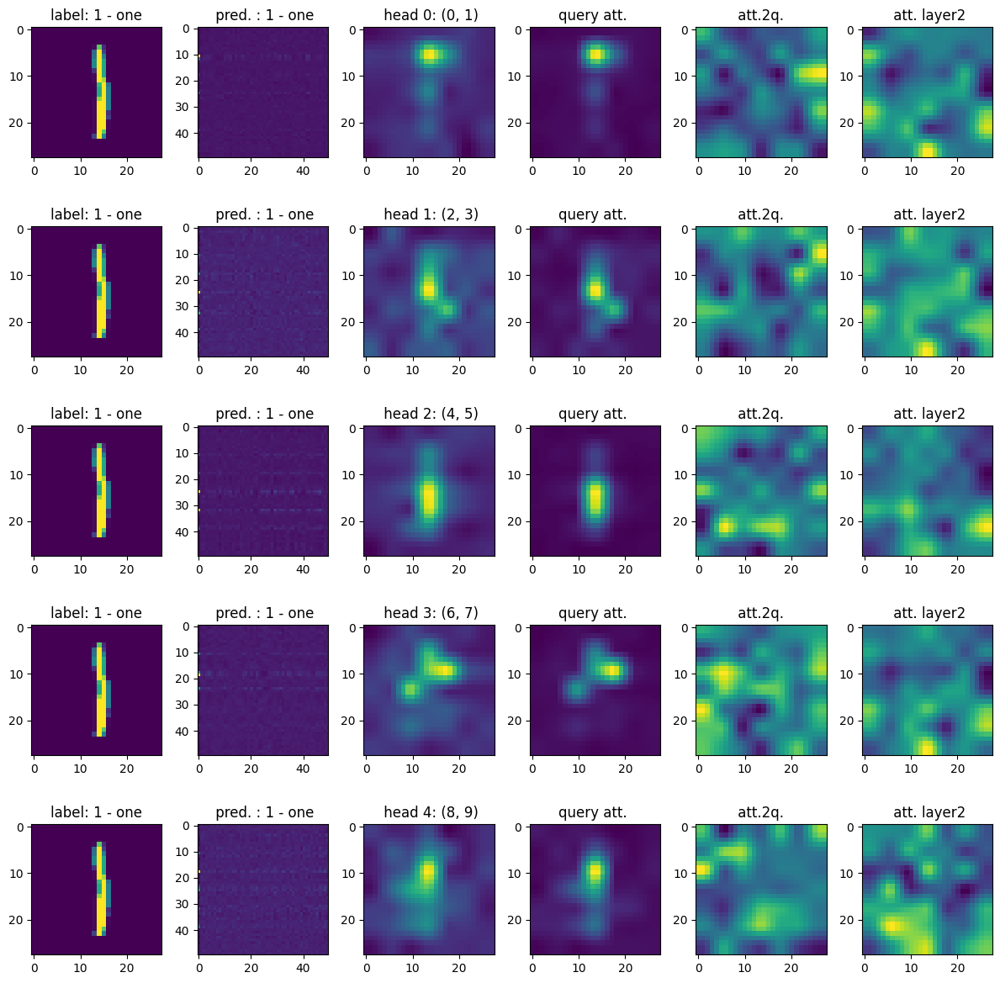

ic| t: 154


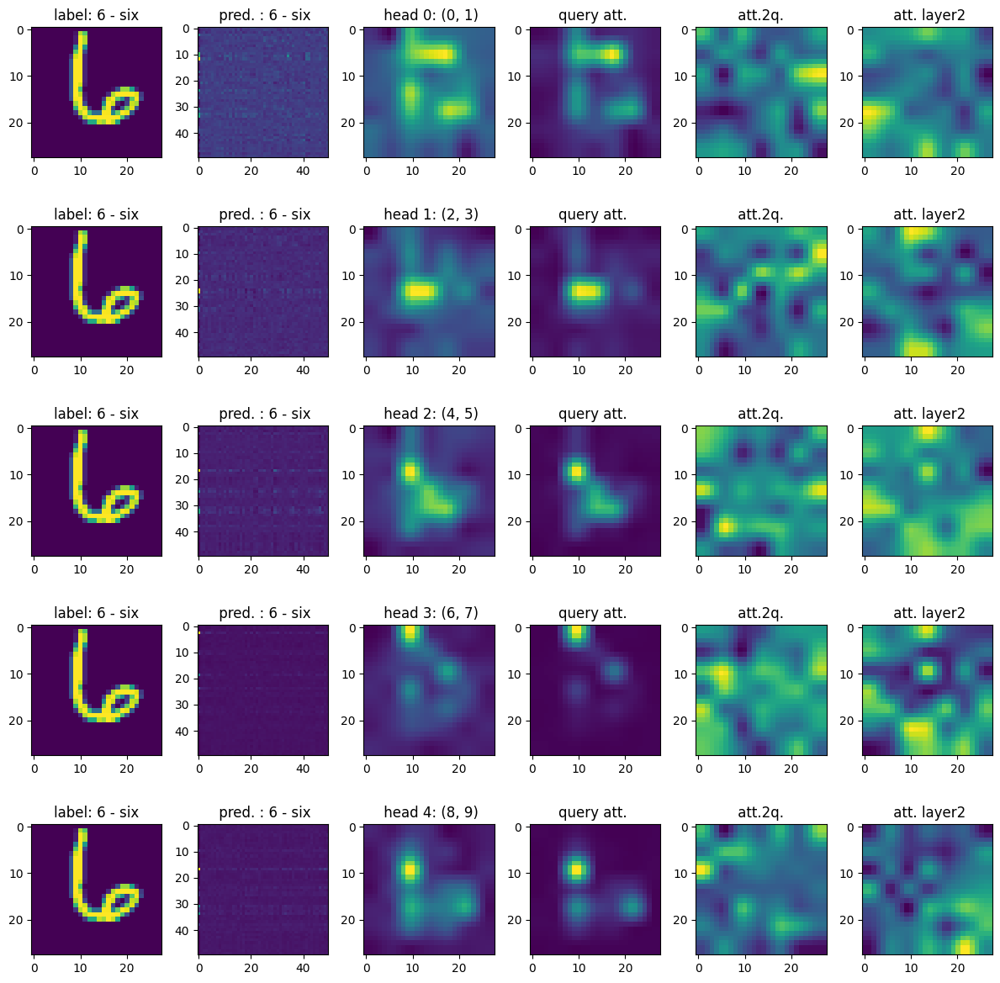

ic| t: 156


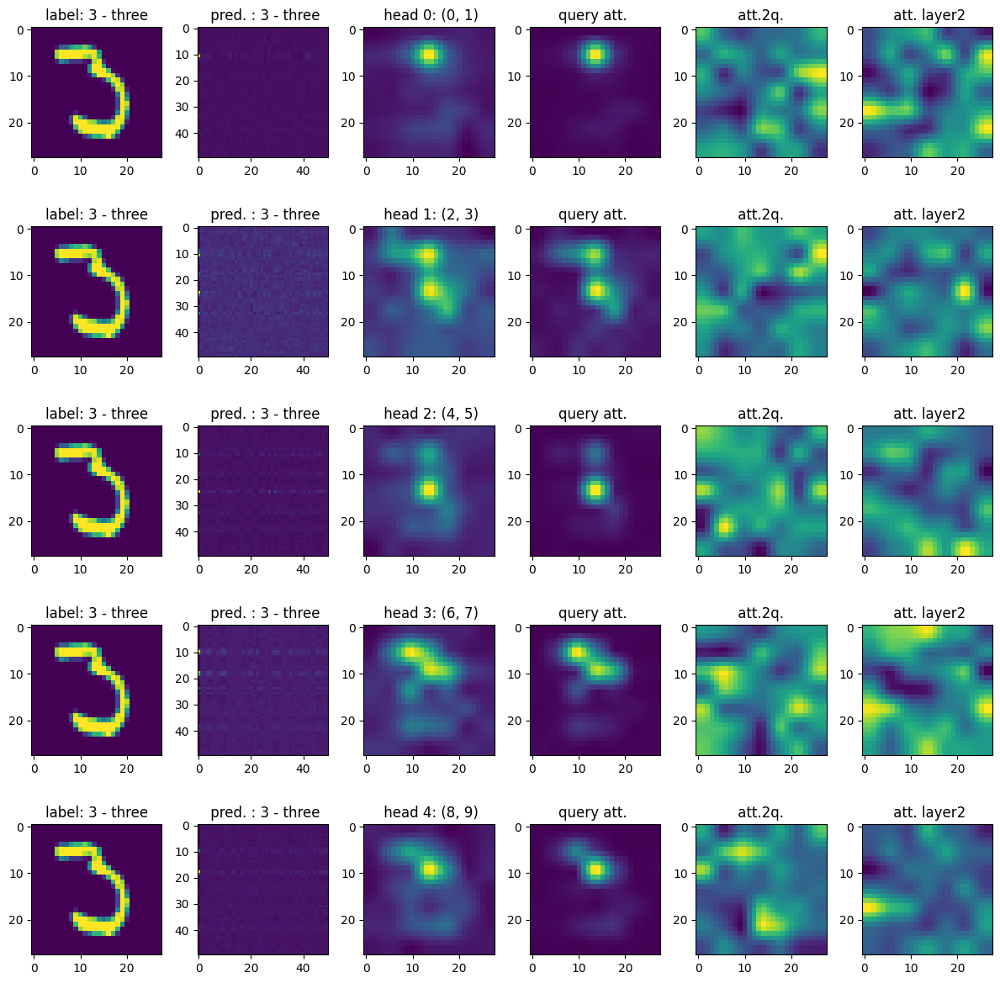

ic| t: 158


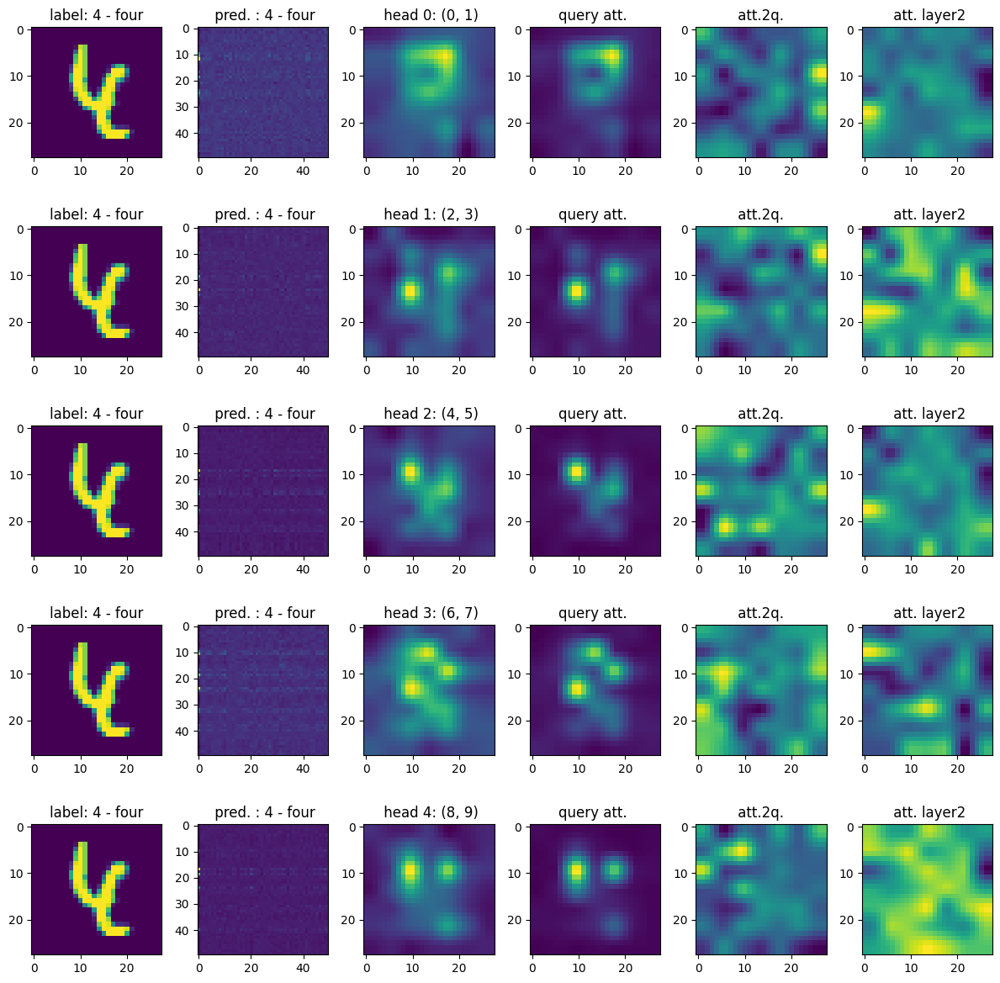

ic| t: 160


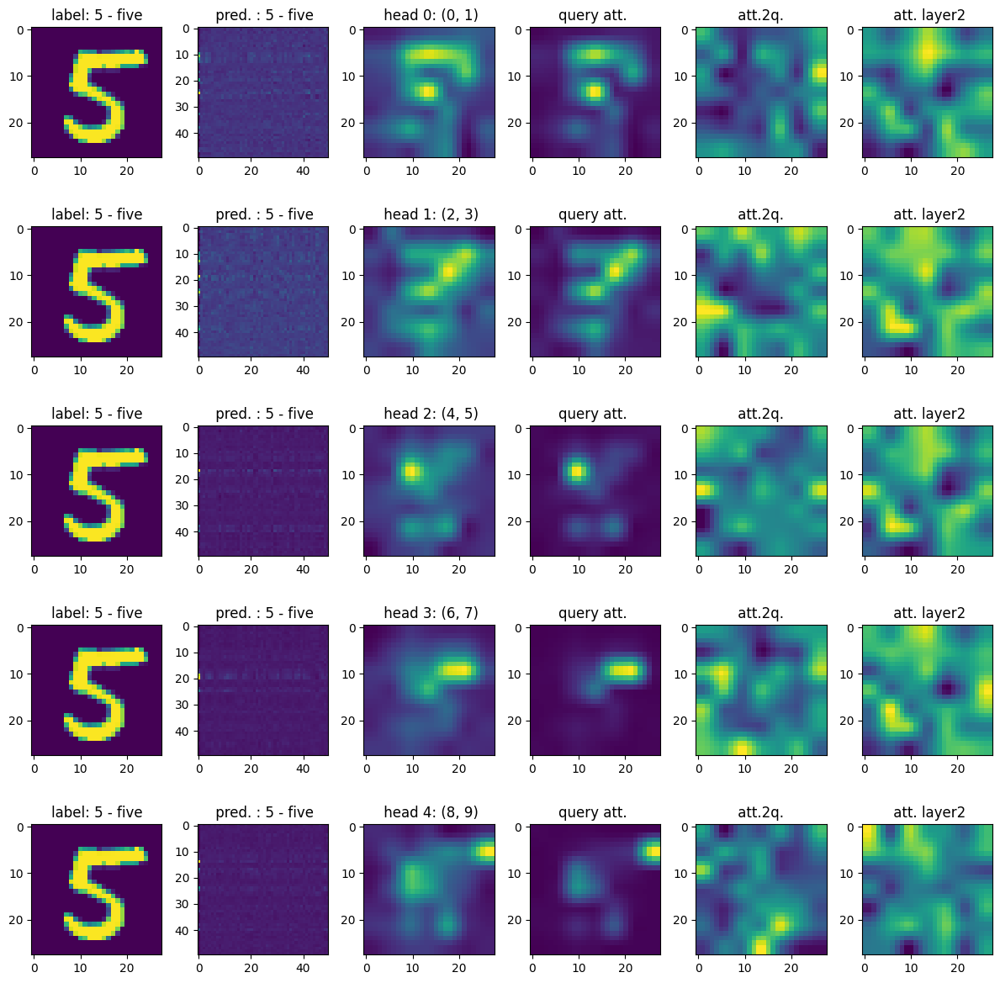

ic| t: 162


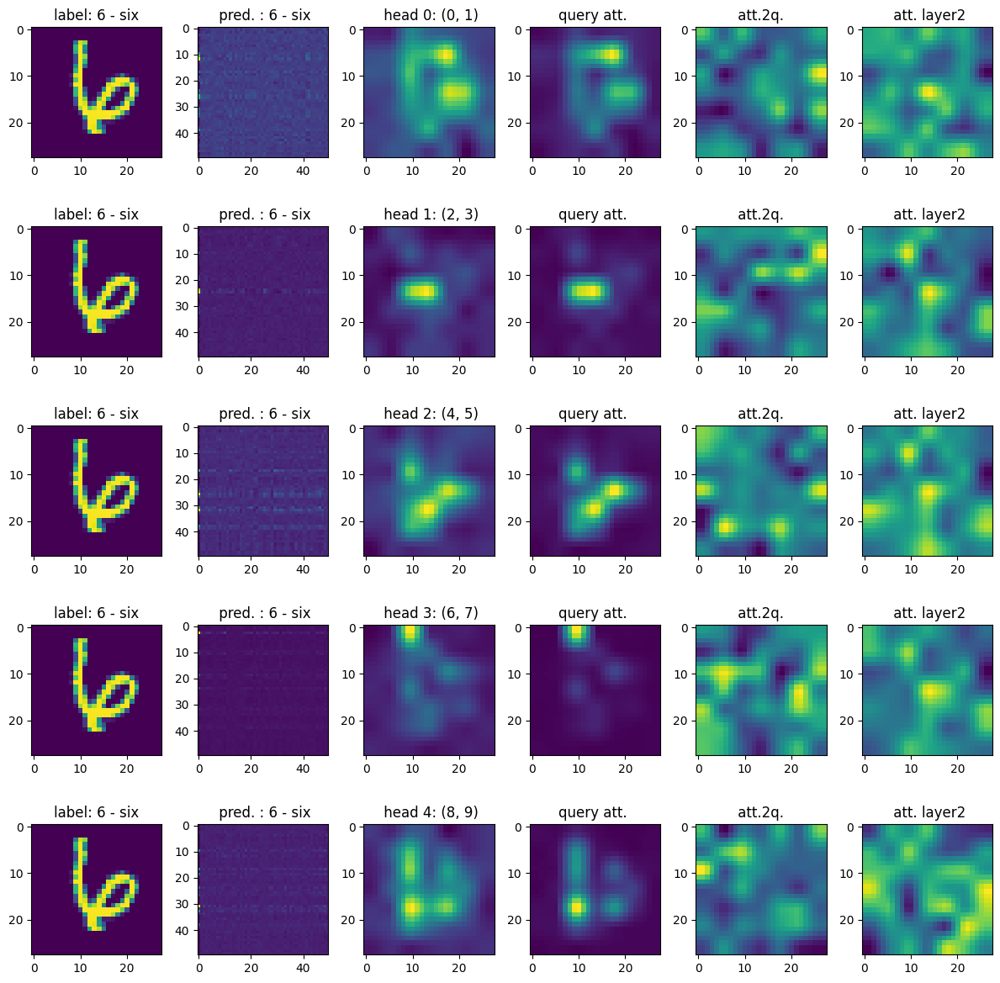

ic| t: 164


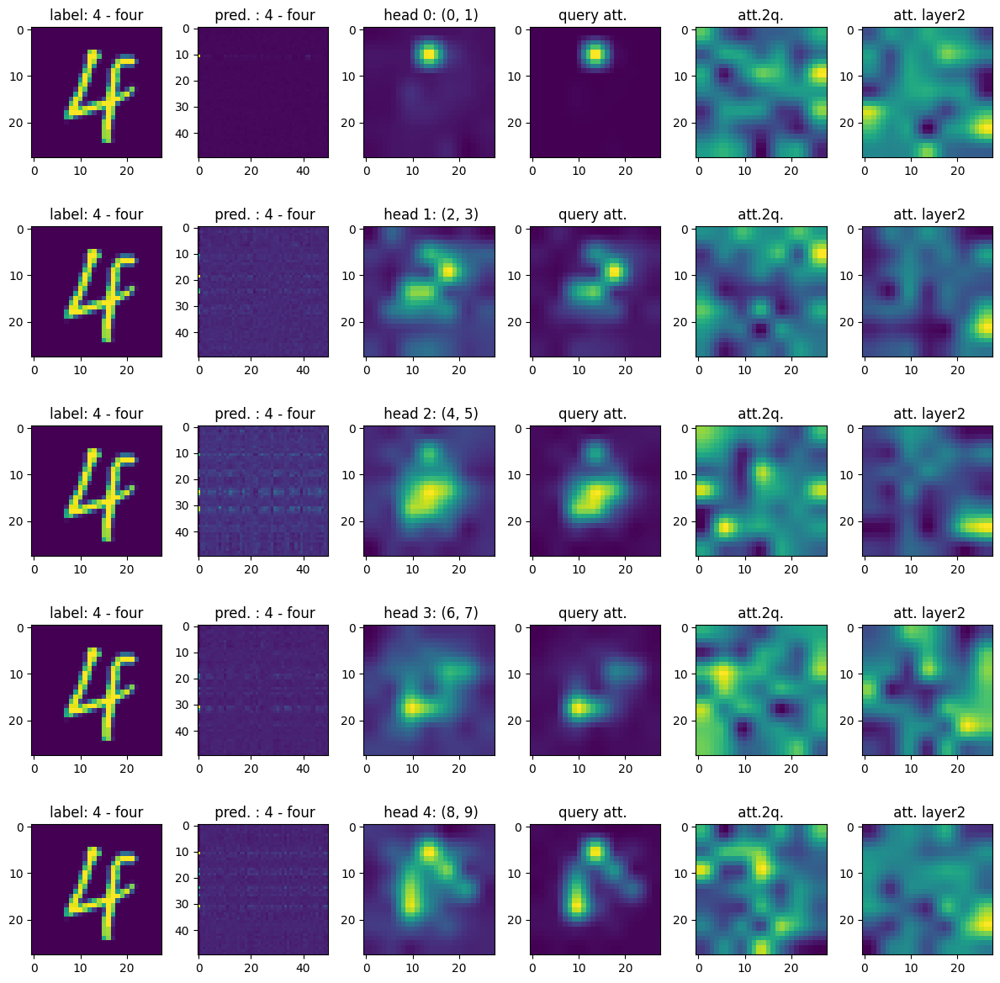

ic| t: 166


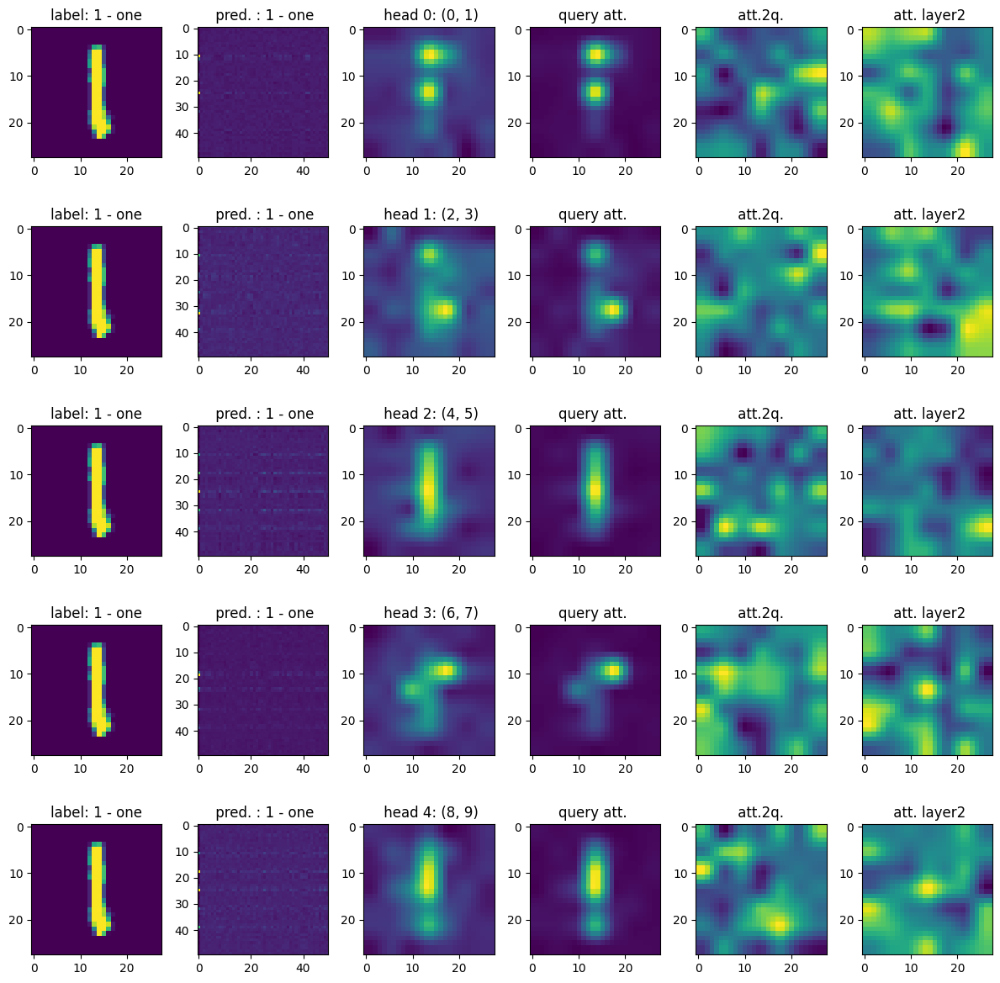

ic| t: 168


In [56]:
for c in range(80):
    if True:
        if n_head_layer1 == 1:
            fig, axes = plt.subplots(1,6 , figsize=(10,3))
            axes = axes[None]
        else:
            fig, axes = plt.subplots(n_head_layer1,6 , figsize=(10+2,n_head_layer1*2+2))
        
        
        with torch.no_grad():
            pred0 = model_outputs_test[t*block_size:t*block_size + block_size]
            
            pred0 = torch.from_numpy(pred0.copy()).float().requires_grad_(False)
        
            values = pred0[:, :value_dim].reshape(-1,block_size,value_dim)
            values_k = values[...,:embeding_dim]
            values_v = values[...,embeding_dim:]
    
            keys = pred0[:, value_dim: value_dim + embeding_dim].reshape(-1,block_size,embeding_dim)
            queries = pred0[:, value_dim + embeding_dim:value_dim + 2*embeding_dim] .reshape(-1,block_size, embeding_dim)
            # keys = pred0[:, value_dim: value_dim + embeding_dim].reshape(-1,block_size,embeding_dim)
            # queries = pred0[:, value_dim + embeding_dim:value_dim + 2*embeding_dim] .reshape(-1,block_size, embeding_dim)
            B, T, C = keys.size()
            
            keys = keys.view(B, T, n_head_layer1, C // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            queries = queries.view(B, T, n_head_layer1, C // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            values_k = values_k.view(B, T, n_head_layer1, embeding_dim // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            values_v = values_v.view(B, T, n_head_layer1, num_class // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            
            values = torch.cat([values_k,values_v], dim=-1)
            
            att = (queries @ keys.transpose(-2, -1)) * (1.0 / np.sqrt(keys.size(-1)))
            # att = att.masked_fill(self.bias[:,:,:T,:T] == 0, float('-inf')) # causal implementation 
            att = F.softmax(att, dim=-1)
            # att = F.relu(att)
            layer1_value = att @ values  # (B, nh, T, T) x (B, nh, T, hs) -> (B, nh, T, hs)

            layer1_value = att  @ values  # (B, nh, T, T) x (B, nh, T, hs) -> (B, nh, T, hs)
            layer1_k = layer1_value[...,: (embeding_dim // n_head_layer1) ].transpose(1, 2).contiguous().view(B, T, embeding_dim)
            layer1_v = layer1_value[...,(embeding_dim // n_head_layer1) :].transpose(1, 2).contiguous().view(B, T, num_class)
    
            layer1_value_seq = torch.cat([layer1_k,layer1_v], dim=-1).view(B, T, 1, value_dim) # re-assemble all  outputs for linear mapping
            layer1_value_seq = (layer1_value_seq@Fix_linear_Mapping).view(B, T,value_dim)
            layer1_value_seq = F.layer_norm(layer1_value_seq, [value_dim])
        
            layer2_keys = layer1_value_seq[:,1:,:embeding_dim] # (B, T-1, hs = embeding_dim)
            layer2_keys = layer2_keys.view(B, T-1, n_head_layer2, C // n_head_layer2).transpose(1, 2) # (B, nh2, T-1, hs)
            
            layer2_values = layer1_value_seq[:,1:,embeding_dim:] # # (B, T, num_class)
            layer2_values = layer2_values.view(B, T-1, n_head_layer2, num_class // n_head_layer2).transpose(1, 2) # (B, nh2, T-1, vs )
        
            layer2_queries =  layer1_value_seq[:,[0],:embeding_dim]  # (B, T=1, hs = embeding_dim)
            layer2_queries = layer2_queries.view(B, 1, n_head_layer2, C // n_head_layer2).transpose(1, 2) # (B, nh2, T=1, hs)
        
            layer2_q_values = layer1_value_seq[:,0,embeding_dim:] # # (B, T=1, num_class)
        
            # manual implementation of attention
            att2 = (layer2_queries @ layer2_keys.transpose(-2, -1)) * (1.0 / np.sqrt(layer2_keys.size(-1))) # (B, nh2, 1, T-1)
            att2 = F.softmax(att2, dim=-1)
        
            n_head_output = att2  @ layer2_values  # (B, nh, T=1, T) x (B, nh2, T, vs ) -> (B, nh2, T=1, vs )
            
            output = n_head_output.view(B,num_class) #+ layer2_q_values
            

            # ic(F.softmax(output,dim=-1))
            for i, heads in enumerate(zip(att[0],att2[0])):
                head , head2 = heads
                axes[i,0].imshow(Testset.data[t])
                axes[i,0].set_title('label: ' + str(Testset.classes[Testset.targets[t]]) )
                
                axes[i,1].imshow(head.T)
                # axes[i,1].imshow(F.relu(head.T),vmin=0)
                # axes[i,1].imshow(head.T)
                tttt = Testset.classes[preds[t]]
                axes[i,1].set_title( ' pred. : ' +  tttt )
                # plt.show()

                attention_mask_path = head.sum(0)[1:].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
    #             print( att.sum(0))
                image = cv2.resize(attention_mask_path, (28, 28))
                # ic(image)
                axes[i,2].imshow(image)
                axes[i,2].set_title(f' head {i}: {i*2,i*2+1}')

                att_q = head[0,1:].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,3].imshow(cv2.resize(att_q, (28, 28)))
                axes[i,3].set_title(f'query att. ')

                att_q = head[1:,0].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,4].imshow(cv2.resize(att_q, (28, 28)))
                axes[i,4].set_title(f' att.2q. ')
                
        #         axes[2].imshow(attention_mask)
                att_2 = head2.reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,5].imshow(cv2.resize(att_2, (28, 28)))
                axes[i,5].set_title(f' att. layer2')
        #         axes[2].imshow(att.sum(0).reshape(int(len(tiles)**.5),int(len(tiles)**.5)), interpolation="bicubic")
            fig.tight_layout()   
            plt.show()
    
    ic(t)
    t+=2

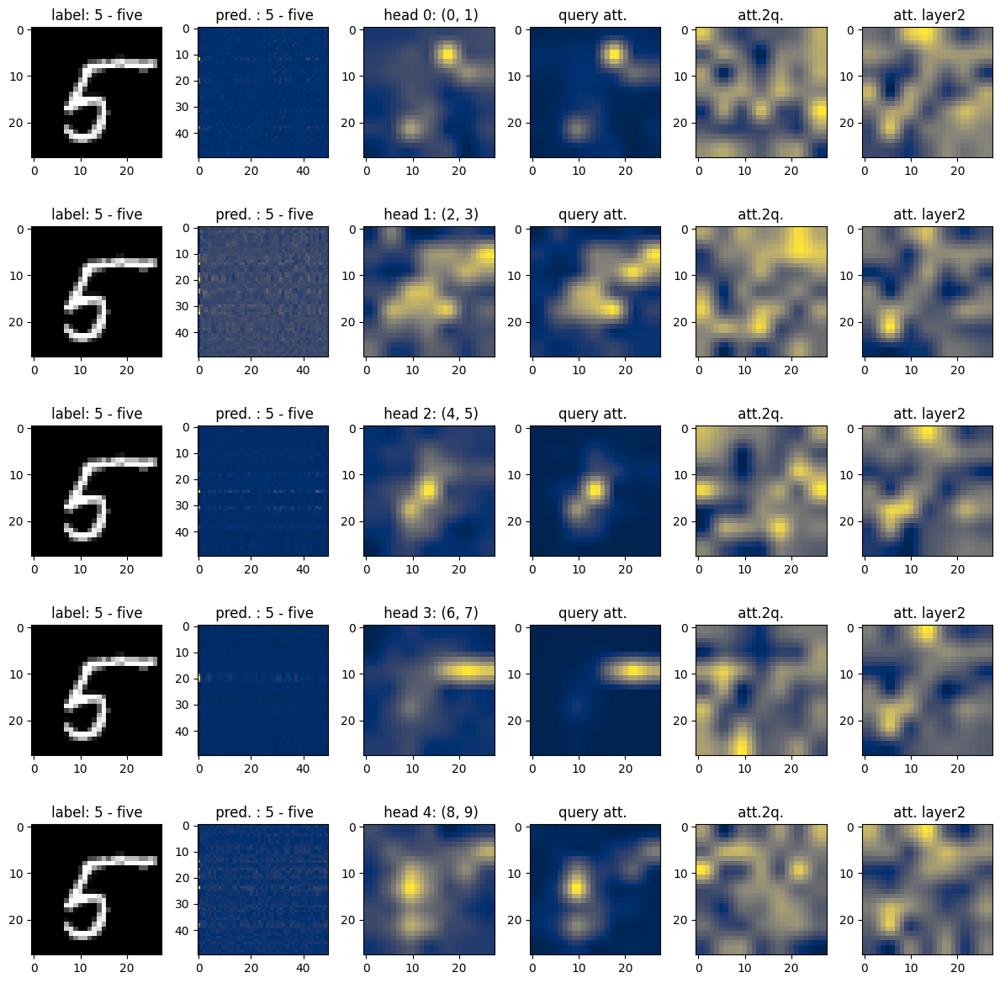

ic| t: 152


In [72]:
t = 152
for c in range(1):
    if True:
        if n_head_layer1 == 1:
            fig, axes = plt.subplots(1,6 , figsize=(10,3))
            axes = axes[None]
        else:
            fig, axes = plt.subplots(n_head_layer1,6 , figsize=(10+2,n_head_layer1*2+2))
        
        
        with torch.no_grad():
            pred0 = model_outputs_test[t*block_size:t*block_size + block_size]
            
            pred0 = torch.from_numpy(pred0.copy()).float().requires_grad_(False)
        
            values = pred0[:, :value_dim].reshape(-1,block_size,value_dim)
            values_k = values[...,:embeding_dim]
            values_v = values[...,embeding_dim:]
    
            keys = pred0[:, value_dim: value_dim + embeding_dim].reshape(-1,block_size,embeding_dim)
            queries = pred0[:, value_dim + embeding_dim:value_dim + 2*embeding_dim] .reshape(-1,block_size, embeding_dim)
            # keys = pred0[:, value_dim: value_dim + embeding_dim].reshape(-1,block_size,embeding_dim)
            # queries = pred0[:, value_dim + embeding_dim:value_dim + 2*embeding_dim] .reshape(-1,block_size, embeding_dim)
            B, T, C = keys.size()
            
            keys = keys.view(B, T, n_head_layer1, C // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            queries = queries.view(B, T, n_head_layer1, C // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            values_k = values_k.view(B, T, n_head_layer1, embeding_dim // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            values_v = values_v.view(B, T, n_head_layer1, num_class // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            
            values = torch.cat([values_k,values_v], dim=-1)
            
            att = (queries @ keys.transpose(-2, -1)) * (1.0 / np.sqrt(keys.size(-1)))
            # att = att.masked_fill(self.bias[:,:,:T,:T] == 0, float('-inf')) # causal implementation 
            att = F.softmax(att, dim=-1)
            # att = F.relu(att)
            layer1_value = att @ values  # (B, nh, T, T) x (B, nh, T, hs) -> (B, nh, T, hs)

            layer1_value = att  @ values  # (B, nh, T, T) x (B, nh, T, hs) -> (B, nh, T, hs)
            layer1_k = layer1_value[...,: (embeding_dim // n_head_layer1) ].transpose(1, 2).contiguous().view(B, T, embeding_dim)
            layer1_v = layer1_value[...,(embeding_dim // n_head_layer1) :].transpose(1, 2).contiguous().view(B, T, num_class)
    
            layer1_value_seq = torch.cat([layer1_k,layer1_v], dim=-1).view(B, T, 1, value_dim) # re-assemble all  outputs for linear mapping
            layer1_value_seq = (layer1_value_seq@Fix_linear_Mapping).view(B, T,value_dim)
            layer1_value_seq = F.layer_norm(layer1_value_seq, [value_dim])
        
            layer2_keys = layer1_value_seq[:,1:,:embeding_dim] # (B, T-1, hs = embeding_dim)
            layer2_keys = layer2_keys.view(B, T-1, n_head_layer2, C // n_head_layer2).transpose(1, 2) # (B, nh2, T-1, hs)
            
            layer2_values = layer1_value_seq[:,1:,embeding_dim:] # # (B, T, num_class)
            layer2_values = layer2_values.view(B, T-1, n_head_layer2, num_class // n_head_layer2).transpose(1, 2) # (B, nh2, T-1, vs )
        
            layer2_queries =  layer1_value_seq[:,[0],:embeding_dim]  # (B, T=1, hs = embeding_dim)
            layer2_queries = layer2_queries.view(B, 1, n_head_layer2, C // n_head_layer2).transpose(1, 2) # (B, nh2, T=1, hs)
        
            layer2_q_values = layer1_value_seq[:,0,embeding_dim:] # # (B, T=1, num_class)
        
            # manual implementation of attention
            att2 = (layer2_queries @ layer2_keys.transpose(-2, -1)) * (1.0 / np.sqrt(layer2_keys.size(-1))) # (B, nh2, 1, T-1)
            att2 = F.softmax(att2, dim=-1)
        
            n_head_output = att2  @ layer2_values  # (B, nh, T=1, T) x (B, nh2, T, vs ) -> (B, nh2, T=1, vs )
            
            output = n_head_output.view(B,num_class) #+ layer2_q_values
            

            # ic(F.softmax(output,dim=-1))
            for i, heads in enumerate(zip(att[0],att2[0])):
                head , head2 = heads
                axes[i,0].imshow(Testset.data[t] ,  cmap='gray')
                axes[i,0].set_title('label: ' + str(Testset.classes[Testset.targets[t]]) )
                
                axes[i,1].imshow(head.T,  cmap='cividis')
                # axes[i,1].imshow(F.relu(head.T),vmin=0)
                # axes[i,1].imshow(head.T)
                tttt = Testset.classes[preds[t]]
                axes[i,1].set_title( ' pred. : ' +  tttt )
                # plt.show()

                attention_mask_path = head.sum(0)[1:].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
    #             print( att.sum(0))
                image = cv2.resize(attention_mask_path, (28, 28))
                # ic(image)
                axes[i,2].imshow(image,  cmap='cividis')
                axes[i,2].set_title(f' head {i}: {i*2,i*2+1}')

                att_q = head[0,1:].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,3].imshow(cv2.resize(att_q, (28, 28)),  cmap='cividis')
                axes[i,3].set_title(f'query att. ')

                att_q = head[1:,0].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,4].imshow(cv2.resize(att_q, (28, 28)),  cmap='cividis')
                axes[i,4].set_title(f' att.2q. ')
                
        #         axes[2].imshow(attention_mask)
                att_2 = head2.reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,5].imshow(cv2.resize(att_2, (28, 28)),  cmap='cividis')
                axes[i,5].set_title(f' att. layer2')
        #         axes[2].imshow(att.sum(0).reshape(int(len(tiles)**.5),int(len(tiles)**.5)), interpolation="bicubic")
            fig.tight_layout()   
            plt.show()
    
    ic(t)
    t+=2

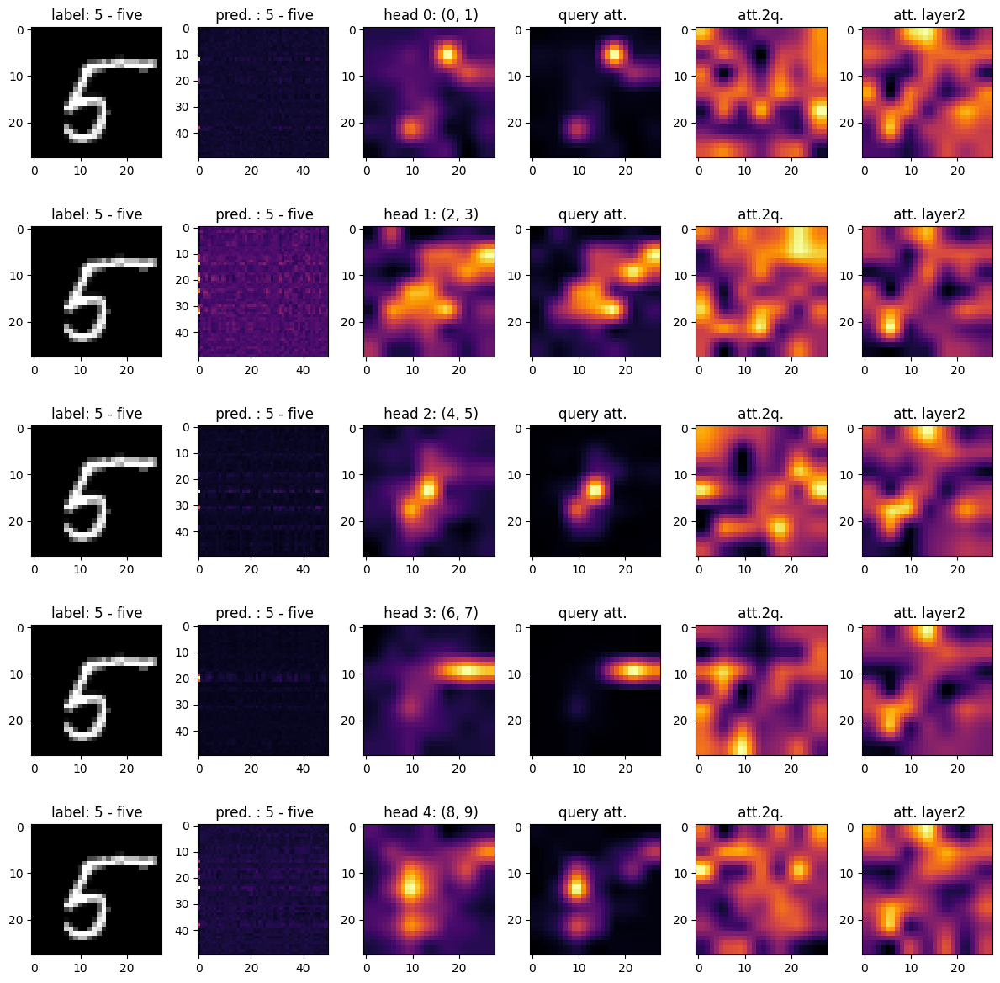

ic| t: 152


In [73]:
t = 152
for c in range(1):
    if True:
        if n_head_layer1 == 1:
            fig, axes = plt.subplots(1,6 , figsize=(10,3))
            axes = axes[None]
        else:
            fig, axes = plt.subplots(n_head_layer1,6 , figsize=(10+2,n_head_layer1*2+2))
        
        
        with torch.no_grad():
            pred0 = model_outputs_test[t*block_size:t*block_size + block_size]
            
            pred0 = torch.from_numpy(pred0.copy()).float().requires_grad_(False)
        
            values = pred0[:, :value_dim].reshape(-1,block_size,value_dim)
            values_k = values[...,:embeding_dim]
            values_v = values[...,embeding_dim:]
    
            keys = pred0[:, value_dim: value_dim + embeding_dim].reshape(-1,block_size,embeding_dim)
            queries = pred0[:, value_dim + embeding_dim:value_dim + 2*embeding_dim] .reshape(-1,block_size, embeding_dim)
            # keys = pred0[:, value_dim: value_dim + embeding_dim].reshape(-1,block_size,embeding_dim)
            # queries = pred0[:, value_dim + embeding_dim:value_dim + 2*embeding_dim] .reshape(-1,block_size, embeding_dim)
            B, T, C = keys.size()
            
            keys = keys.view(B, T, n_head_layer1, C // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            queries = queries.view(B, T, n_head_layer1, C // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            values_k = values_k.view(B, T, n_head_layer1, embeding_dim // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            values_v = values_v.view(B, T, n_head_layer1, num_class // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            
            values = torch.cat([values_k,values_v], dim=-1)
            
            att = (queries @ keys.transpose(-2, -1)) * (1.0 / np.sqrt(keys.size(-1)))
            # att = att.masked_fill(self.bias[:,:,:T,:T] == 0, float('-inf')) # causal implementation 
            att = F.softmax(att, dim=-1)
            # att = F.relu(att)
            layer1_value = att @ values  # (B, nh, T, T) x (B, nh, T, hs) -> (B, nh, T, hs)

            layer1_value = att  @ values  # (B, nh, T, T) x (B, nh, T, hs) -> (B, nh, T, hs)
            layer1_k = layer1_value[...,: (embeding_dim // n_head_layer1) ].transpose(1, 2).contiguous().view(B, T, embeding_dim)
            layer1_v = layer1_value[...,(embeding_dim // n_head_layer1) :].transpose(1, 2).contiguous().view(B, T, num_class)
    
            layer1_value_seq = torch.cat([layer1_k,layer1_v], dim=-1).view(B, T, 1, value_dim) # re-assemble all  outputs for linear mapping
            layer1_value_seq = (layer1_value_seq@Fix_linear_Mapping).view(B, T,value_dim)
            layer1_value_seq = F.layer_norm(layer1_value_seq, [value_dim])
        
            layer2_keys = layer1_value_seq[:,1:,:embeding_dim] # (B, T-1, hs = embeding_dim)
            layer2_keys = layer2_keys.view(B, T-1, n_head_layer2, C // n_head_layer2).transpose(1, 2) # (B, nh2, T-1, hs)
            
            layer2_values = layer1_value_seq[:,1:,embeding_dim:] # # (B, T, num_class)
            layer2_values = layer2_values.view(B, T-1, n_head_layer2, num_class // n_head_layer2).transpose(1, 2) # (B, nh2, T-1, vs )
        
            layer2_queries =  layer1_value_seq[:,[0],:embeding_dim]  # (B, T=1, hs = embeding_dim)
            layer2_queries = layer2_queries.view(B, 1, n_head_layer2, C // n_head_layer2).transpose(1, 2) # (B, nh2, T=1, hs)
        
            layer2_q_values = layer1_value_seq[:,0,embeding_dim:] # # (B, T=1, num_class)
        
            # manual implementation of attention
            att2 = (layer2_queries @ layer2_keys.transpose(-2, -1)) * (1.0 / np.sqrt(layer2_keys.size(-1))) # (B, nh2, 1, T-1)
            att2 = F.softmax(att2, dim=-1)
        
            n_head_output = att2  @ layer2_values  # (B, nh, T=1, T) x (B, nh2, T, vs ) -> (B, nh2, T=1, vs )
            
            output = n_head_output.view(B,num_class) #+ layer2_q_values
            

            # ic(F.softmax(output,dim=-1))
            for i, heads in enumerate(zip(att[0],att2[0])):
                head , head2 = heads
                axes[i,0].imshow(Testset.data[t] ,  cmap='gray')
                axes[i,0].set_title('label: ' + str(Testset.classes[Testset.targets[t]]) )
                
                axes[i,1].imshow(head.T,  cmap='inferno')
                # axes[i,1].imshow(F.relu(head.T),vmin=0)
                # axes[i,1].imshow(head.T)
                tttt = Testset.classes[preds[t]]
                axes[i,1].set_title( ' pred. : ' +  tttt )
                # plt.show()

                attention_mask_path = head.sum(0)[1:].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
    #             print( att.sum(0))
                image = cv2.resize(attention_mask_path, (28, 28))
                # ic(image)
                axes[i,2].imshow(image,  cmap='inferno')
                axes[i,2].set_title(f' head {i}: {i*2,i*2+1}')

                att_q = head[0,1:].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,3].imshow(cv2.resize(att_q, (28, 28)),  cmap='inferno')
                axes[i,3].set_title(f'query att. ')

                att_q = head[1:,0].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,4].imshow(cv2.resize(att_q, (28, 28)),  cmap='inferno')
                axes[i,4].set_title(f' att.2q. ')
                
        #         axes[2].imshow(attention_mask)
                att_2 = head2.reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,5].imshow(cv2.resize(att_2, (28, 28)),  cmap='inferno')
                axes[i,5].set_title(f' att. layer2')
        #         axes[2].imshow(att.sum(0).reshape(int(len(tiles)**.5),int(len(tiles)**.5)), interpolation="bicubic")
            fig.tight_layout()   
            plt.show()
    
    ic(t)
    t+=2

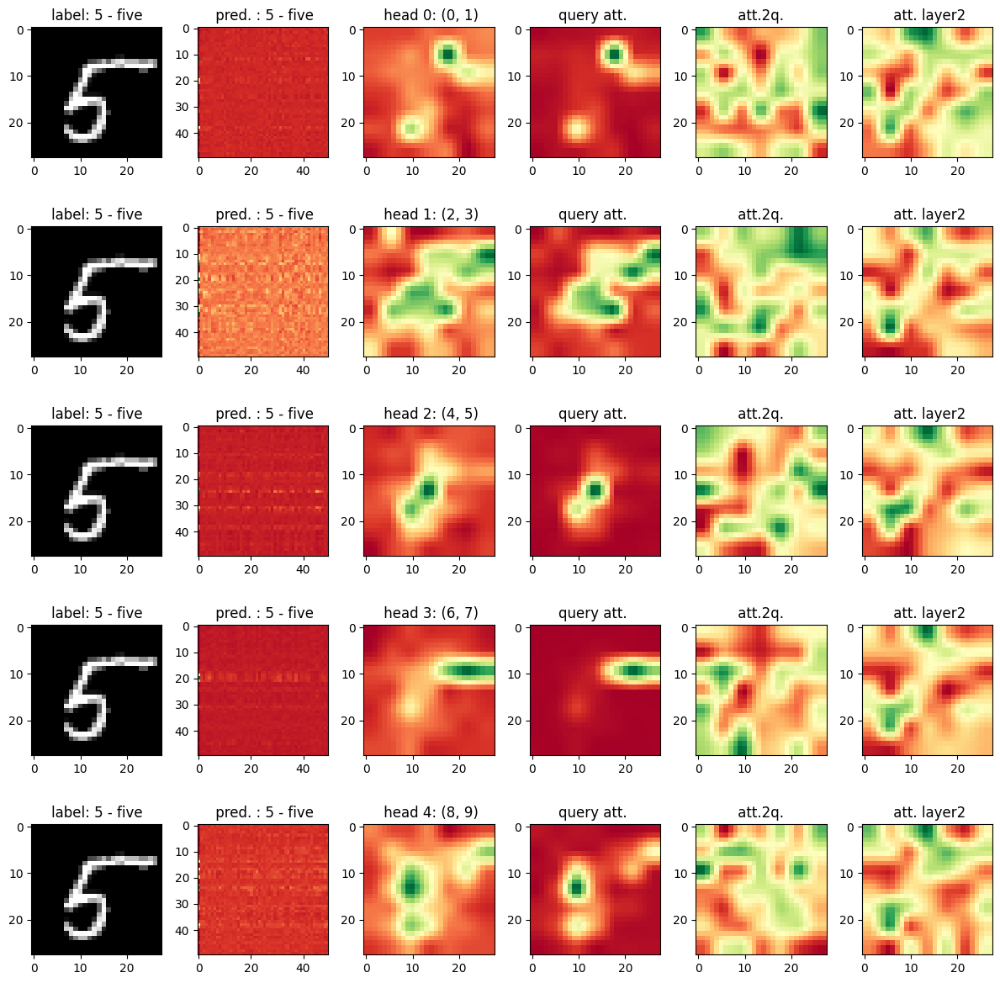

ic| t: 152


In [74]:
t = 152
for c in range(1):
    if True:
        if n_head_layer1 == 1:
            fig, axes = plt.subplots(1,6 , figsize=(10,3))
            axes = axes[None]
        else:
            fig, axes = plt.subplots(n_head_layer1,6 , figsize=(10+2,n_head_layer1*2+2))
        
        
        with torch.no_grad():
            pred0 = model_outputs_test[t*block_size:t*block_size + block_size]
            
            pred0 = torch.from_numpy(pred0.copy()).float().requires_grad_(False)
        
            values = pred0[:, :value_dim].reshape(-1,block_size,value_dim)
            values_k = values[...,:embeding_dim]
            values_v = values[...,embeding_dim:]
    
            keys = pred0[:, value_dim: value_dim + embeding_dim].reshape(-1,block_size,embeding_dim)
            queries = pred0[:, value_dim + embeding_dim:value_dim + 2*embeding_dim] .reshape(-1,block_size, embeding_dim)
            # keys = pred0[:, value_dim: value_dim + embeding_dim].reshape(-1,block_size,embeding_dim)
            # queries = pred0[:, value_dim + embeding_dim:value_dim + 2*embeding_dim] .reshape(-1,block_size, embeding_dim)
            B, T, C = keys.size()
            
            keys = keys.view(B, T, n_head_layer1, C // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            queries = queries.view(B, T, n_head_layer1, C // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            values_k = values_k.view(B, T, n_head_layer1, embeding_dim // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            values_v = values_v.view(B, T, n_head_layer1, num_class // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            
            values = torch.cat([values_k,values_v], dim=-1)
            
            att = (queries @ keys.transpose(-2, -1)) * (1.0 / np.sqrt(keys.size(-1)))
            # att = att.masked_fill(self.bias[:,:,:T,:T] == 0, float('-inf')) # causal implementation 
            att = F.softmax(att, dim=-1)
            # att = F.relu(att)
            layer1_value = att @ values  # (B, nh, T, T) x (B, nh, T, hs) -> (B, nh, T, hs)

            layer1_value = att  @ values  # (B, nh, T, T) x (B, nh, T, hs) -> (B, nh, T, hs)
            layer1_k = layer1_value[...,: (embeding_dim // n_head_layer1) ].transpose(1, 2).contiguous().view(B, T, embeding_dim)
            layer1_v = layer1_value[...,(embeding_dim // n_head_layer1) :].transpose(1, 2).contiguous().view(B, T, num_class)
    
            layer1_value_seq = torch.cat([layer1_k,layer1_v], dim=-1).view(B, T, 1, value_dim) # re-assemble all  outputs for linear mapping
            layer1_value_seq = (layer1_value_seq@Fix_linear_Mapping).view(B, T,value_dim)
            layer1_value_seq = F.layer_norm(layer1_value_seq, [value_dim])
        
            layer2_keys = layer1_value_seq[:,1:,:embeding_dim] # (B, T-1, hs = embeding_dim)
            layer2_keys = layer2_keys.view(B, T-1, n_head_layer2, C // n_head_layer2).transpose(1, 2) # (B, nh2, T-1, hs)
            
            layer2_values = layer1_value_seq[:,1:,embeding_dim:] # # (B, T, num_class)
            layer2_values = layer2_values.view(B, T-1, n_head_layer2, num_class // n_head_layer2).transpose(1, 2) # (B, nh2, T-1, vs )
        
            layer2_queries =  layer1_value_seq[:,[0],:embeding_dim]  # (B, T=1, hs = embeding_dim)
            layer2_queries = layer2_queries.view(B, 1, n_head_layer2, C // n_head_layer2).transpose(1, 2) # (B, nh2, T=1, hs)
        
            layer2_q_values = layer1_value_seq[:,0,embeding_dim:] # # (B, T=1, num_class)
        
            # manual implementation of attention
            att2 = (layer2_queries @ layer2_keys.transpose(-2, -1)) * (1.0 / np.sqrt(layer2_keys.size(-1))) # (B, nh2, 1, T-1)
            att2 = F.softmax(att2, dim=-1)
        
            n_head_output = att2  @ layer2_values  # (B, nh, T=1, T) x (B, nh2, T, vs ) -> (B, nh2, T=1, vs )
            
            output = n_head_output.view(B,num_class) #+ layer2_q_values
            

            # ic(F.softmax(output,dim=-1))
            for i, heads in enumerate(zip(att[0],att2[0])):
                head , head2 = heads
                axes[i,0].imshow(Testset.data[t] ,  cmap='gray')
                axes[i,0].set_title('label: ' + str(Testset.classes[Testset.targets[t]]) )
                
                axes[i,1].imshow(head.T,  cmap='RdYlGn')
                # axes[i,1].imshow(F.relu(head.T),vmin=0)
                # axes[i,1].imshow(head.T)
                tttt = Testset.classes[preds[t]]
                axes[i,1].set_title( ' pred. : ' +  tttt )
                # plt.show()

                attention_mask_path = head.sum(0)[1:].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
    #             print( att.sum(0))
                image = cv2.resize(attention_mask_path, (28, 28))
                # ic(image)
                axes[i,2].imshow(image,  cmap='RdYlGn')
                axes[i,2].set_title(f' head {i}: {i*2,i*2+1}')

                att_q = head[0,1:].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,3].imshow(cv2.resize(att_q, (28, 28)),  cmap='RdYlGn')
                axes[i,3].set_title(f'query att. ')

                att_q = head[1:,0].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,4].imshow(cv2.resize(att_q, (28, 28)),  cmap='RdYlGn')
                axes[i,4].set_title(f' att.2q. ')
                
        #         axes[2].imshow(attention_mask)
                att_2 = head2.reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,5].imshow(cv2.resize(att_2, (28, 28)),  cmap='RdYlGn')
                axes[i,5].set_title(f' att. layer2')
        #         axes[2].imshow(att.sum(0).reshape(int(len(tiles)**.5),int(len(tiles)**.5)), interpolation="bicubic")
            fig.tight_layout()   
            plt.show()
    
    ic(t)
    t+=2

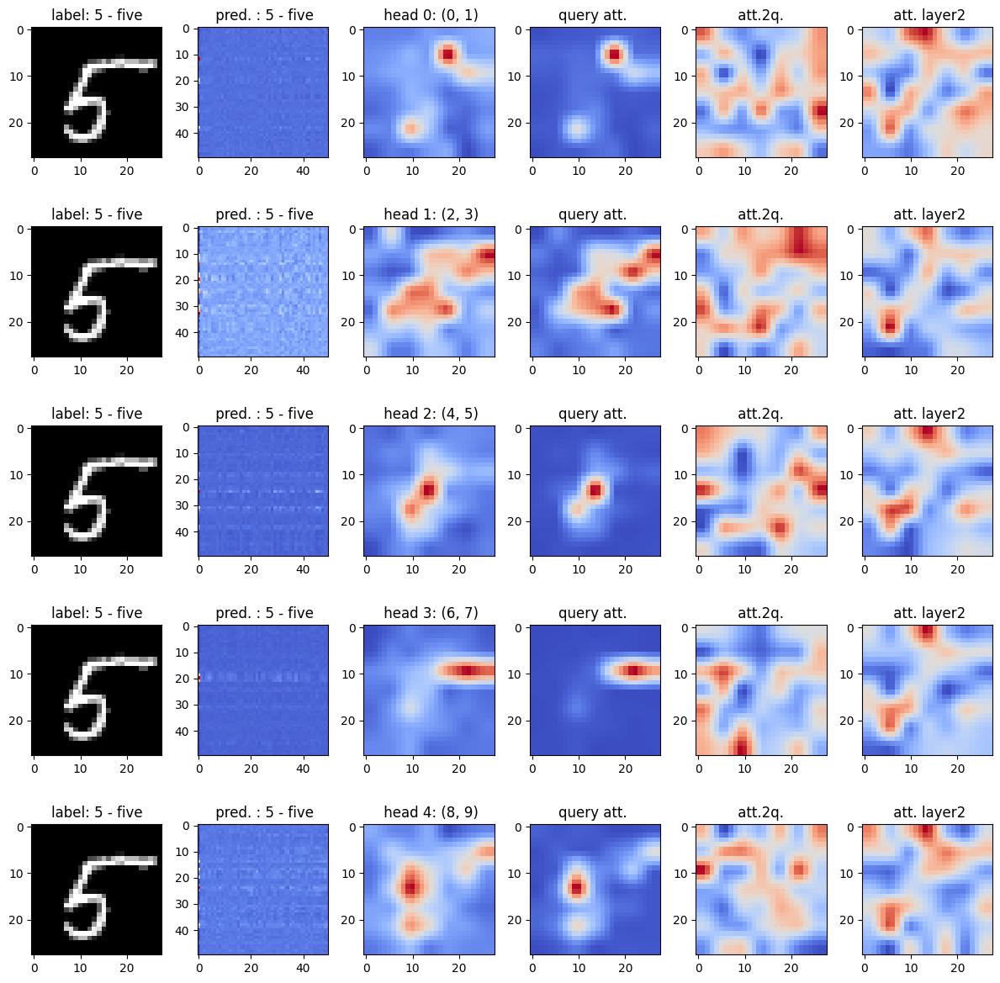

ic| t: 152


In [75]:
t = 152
for c in range(1):
    if True:
        if n_head_layer1 == 1:
            fig, axes = plt.subplots(1,6 , figsize=(10,3))
            axes = axes[None]
        else:
            fig, axes = plt.subplots(n_head_layer1,6 , figsize=(10+2,n_head_layer1*2+2))
        
        
        with torch.no_grad():
            pred0 = model_outputs_test[t*block_size:t*block_size + block_size]
            
            pred0 = torch.from_numpy(pred0.copy()).float().requires_grad_(False)
        
            values = pred0[:, :value_dim].reshape(-1,block_size,value_dim)
            values_k = values[...,:embeding_dim]
            values_v = values[...,embeding_dim:]
    
            keys = pred0[:, value_dim: value_dim + embeding_dim].reshape(-1,block_size,embeding_dim)
            queries = pred0[:, value_dim + embeding_dim:value_dim + 2*embeding_dim] .reshape(-1,block_size, embeding_dim)
            # keys = pred0[:, value_dim: value_dim + embeding_dim].reshape(-1,block_size,embeding_dim)
            # queries = pred0[:, value_dim + embeding_dim:value_dim + 2*embeding_dim] .reshape(-1,block_size, embeding_dim)
            B, T, C = keys.size()
            
            keys = keys.view(B, T, n_head_layer1, C // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            queries = queries.view(B, T, n_head_layer1, C // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            values_k = values_k.view(B, T, n_head_layer1, embeding_dim // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            values_v = values_v.view(B, T, n_head_layer1, num_class // n_head_layer1).transpose(1, 2) # (B, nh, T, hs)
            
            values = torch.cat([values_k,values_v], dim=-1)
            
            att = (queries @ keys.transpose(-2, -1)) * (1.0 / np.sqrt(keys.size(-1)))
            # att = att.masked_fill(self.bias[:,:,:T,:T] == 0, float('-inf')) # causal implementation 
            att = F.softmax(att, dim=-1)
            # att = F.relu(att)
            layer1_value = att @ values  # (B, nh, T, T) x (B, nh, T, hs) -> (B, nh, T, hs)

            layer1_value = att  @ values  # (B, nh, T, T) x (B, nh, T, hs) -> (B, nh, T, hs)
            layer1_k = layer1_value[...,: (embeding_dim // n_head_layer1) ].transpose(1, 2).contiguous().view(B, T, embeding_dim)
            layer1_v = layer1_value[...,(embeding_dim // n_head_layer1) :].transpose(1, 2).contiguous().view(B, T, num_class)
    
            layer1_value_seq = torch.cat([layer1_k,layer1_v], dim=-1).view(B, T, 1, value_dim) # re-assemble all  outputs for linear mapping
            layer1_value_seq = (layer1_value_seq@Fix_linear_Mapping).view(B, T,value_dim)
            layer1_value_seq = F.layer_norm(layer1_value_seq, [value_dim])
        
            layer2_keys = layer1_value_seq[:,1:,:embeding_dim] # (B, T-1, hs = embeding_dim)
            layer2_keys = layer2_keys.view(B, T-1, n_head_layer2, C // n_head_layer2).transpose(1, 2) # (B, nh2, T-1, hs)
            
            layer2_values = layer1_value_seq[:,1:,embeding_dim:] # # (B, T, num_class)
            layer2_values = layer2_values.view(B, T-1, n_head_layer2, num_class // n_head_layer2).transpose(1, 2) # (B, nh2, T-1, vs )
        
            layer2_queries =  layer1_value_seq[:,[0],:embeding_dim]  # (B, T=1, hs = embeding_dim)
            layer2_queries = layer2_queries.view(B, 1, n_head_layer2, C // n_head_layer2).transpose(1, 2) # (B, nh2, T=1, hs)
        
            layer2_q_values = layer1_value_seq[:,0,embeding_dim:] # # (B, T=1, num_class)
        
            # manual implementation of attention
            att2 = (layer2_queries @ layer2_keys.transpose(-2, -1)) * (1.0 / np.sqrt(layer2_keys.size(-1))) # (B, nh2, 1, T-1)
            att2 = F.softmax(att2, dim=-1)
        
            n_head_output = att2  @ layer2_values  # (B, nh, T=1, T) x (B, nh2, T, vs ) -> (B, nh2, T=1, vs )
            
            output = n_head_output.view(B,num_class) #+ layer2_q_values
            

            # ic(F.softmax(output,dim=-1))
            for i, heads in enumerate(zip(att[0],att2[0])):
                head , head2 = heads
                axes[i,0].imshow(Testset.data[t] ,  cmap='gray')
                axes[i,0].set_title('label: ' + str(Testset.classes[Testset.targets[t]]) )
                
                axes[i,1].imshow(head.T,  cmap='coolwarm')
                # axes[i,1].imshow(F.relu(head.T),vmin=0)
                # axes[i,1].imshow(head.T)
                tttt = Testset.classes[preds[t]]
                axes[i,1].set_title( ' pred. : ' +  tttt )
                # plt.show()

                attention_mask_path = head.sum(0)[1:].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
    #             print( att.sum(0))
                image = cv2.resize(attention_mask_path, (28, 28))
                # ic(image)
                axes[i,2].imshow(image,  cmap='coolwarm')
                axes[i,2].set_title(f' head {i}: {i*2,i*2+1}')

                att_q = head[0,1:].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,3].imshow(cv2.resize(att_q, (28, 28)),  cmap='coolwarm')
                axes[i,3].set_title(f'query att. ')

                att_q = head[1:,0].reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,4].imshow(cv2.resize(att_q, (28, 28)),  cmap='coolwarm')
                axes[i,4].set_title(f' att.2q. ')
                
        #         axes[2].imshow(attention_mask)
                att_2 = head2.reshape(int((block_size-1)**.5),int((block_size-1)**.5)).numpy()
                axes[i,5].imshow(cv2.resize(att_2, (28, 28)),  cmap='coolwarm')
                axes[i,5].set_title(f' att. layer2')
        #         axes[2].imshow(att.sum(0).reshape(int(len(tiles)**.5),int(len(tiles)**.5)), interpolation="bicubic")
            fig.tight_layout()   
            plt.show()
    
    ic(t)
    t+=2